In [1]:
import itertools
from cwgp.grid_search import grid_search
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import copy
import GPy
from sklearn.metrics import mean_absolute_error, mean_squared_error
import os
import scipy

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
def exp(x, *par):
    return par[0]*np.exp(par[1]*x)

In [4]:
def poly(x, *par):
    return np.polyval(par,x)

In [5]:
def log(x, *par):
    return par[0]*np.log(x)

In [6]:
def const(x, *par):
    return 0

In [7]:
def cwgp_regression(x_train, y_train, cwgp_model, **kwargs):
    kernel = GPy.kern.RBF(1)


    res = scipy.optimize.curve_fit(poly,  np.ravel(x_train), np.ravel(y_train), p0=(-1,-1), maxfev=3000)
    par = res[0]
    print(f"params:{par}")
    mf = GPy.core.Mapping(1,1)
    mf.f = lambda x: poly(x, *par)
    mf.update_gradients = lambda a,b: None


    model = GPy.models.GPRegression(x_train, y_train, mean_function=mf, kernel=kernel)
    model.optimize()

    
    start, end = 1940, 2031
    start_align = np.min(x_train)-start
    domain_discrete = np.arange(start, end).reshape(-1,1)
    y_all = model.predict(domain_discrete)
    y_mean,y_var = y_all[0],y_all[1]
    y_top, y_bot = y_mean + 1.96*np.sqrt(y_var), y_mean - 1.96*np.sqrt(y_var)

    
    for cwgp in cwgp_model[::-1]:
        y_train = cwgp.phi.inv_comp_phi(cwgp.phi.res.x, y_train)
        y_mean, y_var = cwgp.phi.inv_comp_phi(cwgp.phi.res.x, y_mean), cwgp.phi.inv_comp_phi(cwgp.phi.res.x, y_var)
        y_top, y_bot = cwgp.phi.inv_comp_phi(cwgp.phi.res.x, y_top), cwgp.phi.inv_comp_phi(cwgp.phi.res.x, y_bot)


    validate_rmse = mean_squared_error(y_val, y_mean[train_up+start_align:train_up+start_align+validate], squared=False)
    validate_mae = mean_absolute_error(y_val, y_mean[train_up+start_align:train_up+start_align+validate])
    test_rmse = mean_squared_error(y_test, y_mean[train_up+start_align+validate:train_up+start_align+validate+test], squared=False)
    test_mae = mean_absolute_error(y_test, y_mean[train_up+start_align+validate:train_up+start_align+validate+test])
    txt = f"""validate rmse : {validate_rmse} \n validate mae : {validate_mae} \n
    test rmse : {test_rmse} \n test mae : {test_mae}"""

    
    name = [f"{cwgp.phi.fn.__name__}_{cwgp.phi.n}" for cwgp in cwgp_model]
    name = "_".join(name)
    domain = np.linspace(start,end,end-start)
    plt.fill_between(domain, np.ravel(y_top), np.ravel(y_bot), color=(0,0.5,0.5,0.2), label="Confidence")
    plt.scatter(x_train,y_train, marker="x", color='black', label="data")
    plt.scatter(x_val,y_val, marker="x", color='red', label="validate")
    plt.scatter(x_test, y_test, marker="x", color='blue', label="test")
    plt.plot(np.linspace(start,end,end-start),y_mean, label="mean")
    plt.ylim([0.1,0.35])
    plt.legend()
    plt.figtext(0.5, 0.2, txt, wrap=True, horizontalalignment='center', fontsize=12)
    plt.grid(True)
    plt.show()



    print(txt)
    return txt

In [17]:
def gp_regression(x_train, y_train, mean_func, init_param, **kwargs):
    kernel = GPy.kern.RBF(1)


    res = scipy.optimize.curve_fit(mean_func,  np.ravel(x_train), np.ravel(y_train), p0=init_param,  maxfev=3000)
    par = res[0]
    print(f"params:{par}")
    mf = GPy.core.Mapping(1,1)
    mf.f = lambda x: mean_func(x, *par)
    mf.update_gradients = lambda a,b: None

    model = GPy.models.GPRegression(x_train, y_train, mean_function=mf, kernel=kernel)
    model.optimize()

    
    start, end = 1940, 2031
    start_align = np.min(x_train)-start
    domain_discrete = np.arange(start, end).reshape(-1,1)
    y_all = model.predict(domain_discrete)
    y_mean,y_var = y_all[0],y_all[1]

    validate_rmse = mean_squared_error(y_val, y_mean[train_up+start_align:train_up+start_align+validate], squared=False)
    validate_mae = mean_absolute_error(y_val, y_mean[train_up+start_align:train_up+start_align+validate])
    test_rmse = mean_squared_error(y_test, y_mean[train_up+start_align+validate:train_up+start_align+validate+test], squared=False)
    test_mae = mean_absolute_error(y_test, y_mean[train_up+start_align+validate:train_up+start_align+validate+test])
    txt = f"""validate rmse : {validate_rmse} \n validate mae : {validate_mae} \n
    test rmse : {test_rmse} \n test mae : {test_mae}"""


    model.plot(plot_limits=[start, end])

    plt.title('Age ' + str(age) + f" {mean_func.__name__}")
    plt.xlabel('Year')
    plt.ylabel('Mortality Rate' )
    plt.scatter(x_train,y_train, marker="x", color='black', label="data")
    plt.scatter(x_val,y_val, marker="x", color='red', label="validate")
    plt.scatter(x_test, y_test, marker="x", color='blue', label="test")
    plt.figtext(0.5, 0.2, txt, wrap=True, horizontalalignment='center', fontsize=12)
    plt.ylim([0.1,0.35])

    plt.grid(True)
#     plt.savefig(f'./{IMG_DIR}/{mean_func.__name__}_{age}_mf.png')
    plt.show()
    
    return par

In [9]:
CSV_FIlE = "../japan3.csv"
df = pd.read_csv(CSV_FIlE)
age = 90
df_all = {}
df_all[age]= df[(df["age"]==age)]

year = df_all[age]["year"].to_numpy().reshape(-1,1)
rate = df_all[age]["rate"].to_numpy().reshape(-1,1)


In [10]:
train_ratio, validate_ratio, test_ratio = 0.7, 0.2, 0.1
length = len(rate)

train, validate, test = int(train_ratio*length), int(validate_ratio*length), int(test_ratio*length)
train_up, train_low = train, train-train

In [11]:
x_train, y_train = year[train_low:train_up],rate[train_low:train_up]
x_val, y_val = year[train_up:train_up+validate],rate[train_up:train_up+validate]
x_test, y_test = year[train_up+validate:],rate[train_up+validate:]

params:[ 1.31871584e+07 -9.02192260e-03]


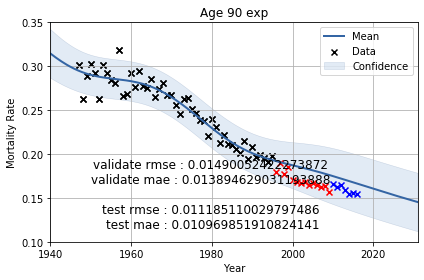

array([ 1.31871584e+07, -9.02192260e-03])

In [18]:
gp_regression(x_train, y_train, exp, (1, -0.00001),
                    x_val=x_val,y_val=y_val,
                    x_test=x_test,y_test=y_test
             )

params:[0.03317154]


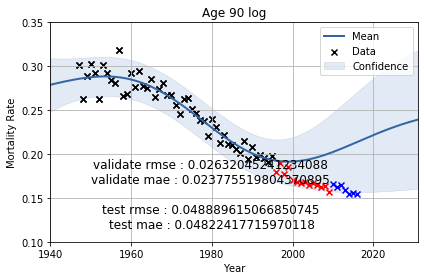

array([0.03317154])

In [19]:
gp_regression(x_train, y_train, log, (0.0001),
                    x_val=x_val,y_val=y_val,
                    x_test=x_test,y_test=y_test
             )

params:[ 2.03332468e-06 -1.20630359e-02  2.38519882e+01 -1.57182438e+04]


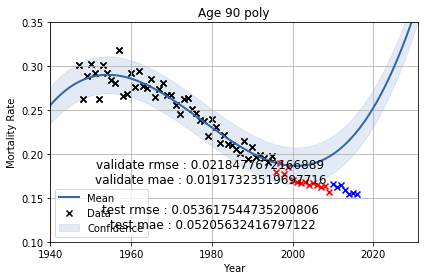

array([ 2.03332468e-06, -1.20630359e-02,  2.38519882e+01, -1.57182438e+04])

In [20]:
gp_regression(x_train, y_train, poly, (0.1, 0.1, 0.1, 0.001),
                    x_val=x_val,y_val=y_val,
                    x_test=x_test,y_test=y_test
             )

params:[-2.33827617e-03  4.86042211e+00]


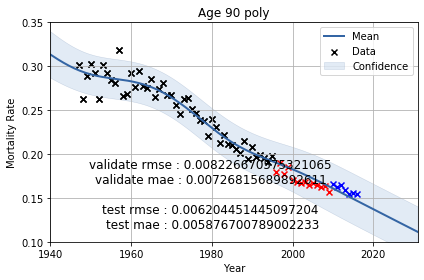

array([-2.33827617e-03,  4.86042211e+00])

In [21]:
gp_regression(x_train, y_train, poly, (0.001, 0.001,),
                    x_val=x_val,y_val=y_val,
                    x_test=x_test,y_test=y_test
             )

  0%|          | 0/1296 [00:00<?, ?it/s]

[('sa', 1), ('sa', 2), ('sal', 1), ('sal', 2), ('box_cox', 1), ('box_cox', 2)]
(('sa', 1), ('sa', 1), ('sa', 1), ('sa', 1))
params:[-9.23416786e-02  1.81848247e+02]


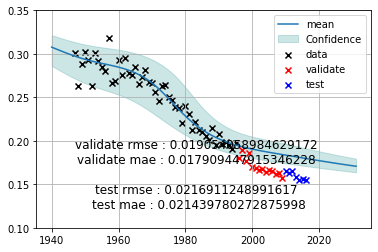

  0%|          | 1/1296 [00:00<16:08,  1.34it/s]

validate rmse : 0.019054058984629172 
 validate mae : 0.017909447915346228 

    test rmse : 0.0216911248991617 
 test mae : 0.021439780272875998
(('sa', 1), ('sa', 1), ('sa', 1), ('sa', 2))
params:[-9.23417607e-02  1.81848407e+02]


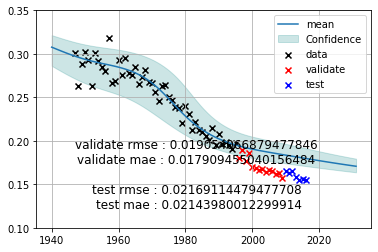

  0%|          | 2/1296 [00:01<16:48,  1.28it/s]

validate rmse : 0.019054066879477846 
 validate mae : 0.017909455040156484 

    test rmse : 0.02169114479477708 
 test mae : 0.02143980012299914
(('sa', 1), ('sa', 1), ('sa', 1), ('sal', 1))
params:[-1.18705071e-01  2.33961082e+02]


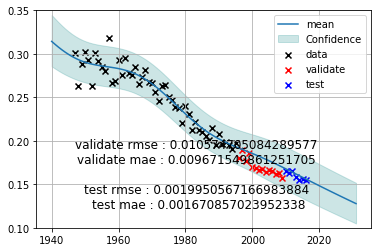

  0%|          | 3/1296 [00:03<28:41,  1.33s/it]

validate rmse : 0.010574705084289577 
 validate mae : 0.009671549861251705 

    test rmse : 0.0019950567166983884 
 test mae : 0.001670857023952338
(('sa', 1), ('sa', 1), ('sa', 1), ('sal', 2))
params:[-1.32828026e+03  2.60900503e+06]


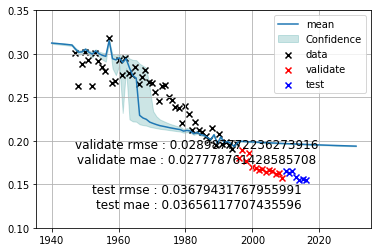

  0%|          | 4/1296 [00:09<1:12:17,  3.36s/it]

validate rmse : 0.028987772236273916 
 validate mae : 0.027778761428585708 

    test rmse : 0.03679431767955991 
 test mae : 0.03656117707435596
(('sa', 1), ('sa', 1), ('sa', 1), ('box_cox', 1))
params:[-9.51593431e-02  1.86341465e+02]


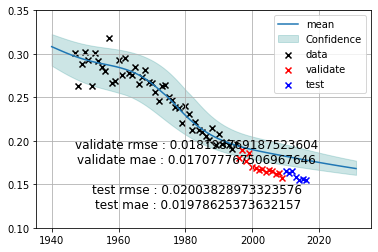

  0%|          | 5/1296 [00:10<51:28,  2.39s/it]  

validate rmse : 0.018198769187523604 
 validate mae : 0.017077767506967646 

    test rmse : 0.02003828973323576 
 test mae : 0.01978625373632157
(('sa', 1), ('sa', 1), ('sa', 1), ('box_cox', 2))
params:[-9.15345987e-02  1.78094134e+02]


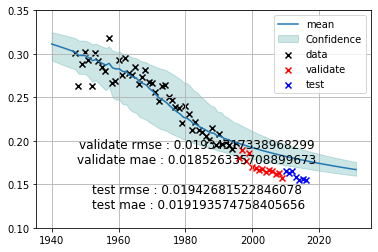

  0%|          | 6/1296 [00:11<38:56,  1.81s/it]

validate rmse : 0.01934317338968299 
 validate mae : 0.018526335708899673 

    test rmse : 0.01942681522846078 
 test mae : 0.019193574758405656
(('sa', 1), ('sa', 1), ('sa', 2), ('sa', 1))
params:[-9.23416865e-02  1.81848263e+02]


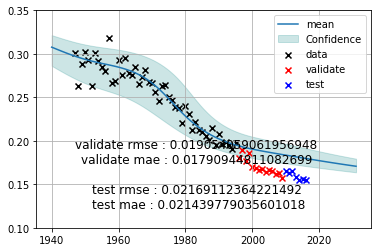

  1%|          | 7/1296 [00:12<31:49,  1.48s/it]

validate rmse : 0.019054059061956948 
 validate mae : 0.01790944811082699 

    test rmse : 0.02169112364221492 
 test mae : 0.021439779035601018
(('sa', 1), ('sa', 1), ('sa', 2), ('sa', 2))
params:[-9.23416848e-02  1.81848260e+02]


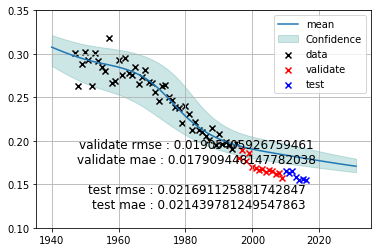

  1%|          | 8/1296 [00:12<27:12,  1.27s/it]

validate rmse : 0.01905405926759461 
 validate mae : 0.017909448147782038 

    test rmse : 0.021691125881742847 
 test mae : 0.021439781249547863
(('sa', 1), ('sa', 1), ('sa', 2), ('sal', 1))
params:[-1.18078873e-01  2.32703941e+02]


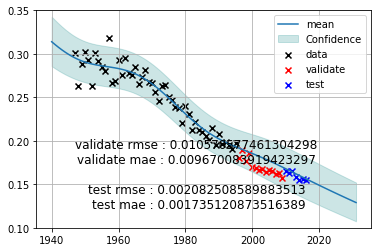

  1%|          | 9/1296 [00:14<26:28,  1.23s/it]

validate rmse : 0.010570577461304298 
 validate mae : 0.009670083919423297 

    test rmse : 0.002082508589883513 
 test mae : 0.001735120873516389
(('sa', 1), ('sa', 1), ('sa', 2), ('sal', 2))
params:[-1.20863850e-01  2.38233815e+02]


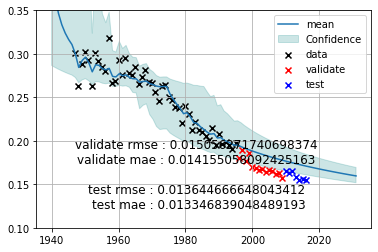

  1%|          | 10/1296 [00:23<1:21:42,  3.81s/it]

validate rmse : 0.015056271740698374 
 validate mae : 0.014155058092425163 

    test rmse : 0.013644666648043412 
 test mae : 0.013346839048489193
(('sa', 1), ('sa', 1), ('sa', 2), ('box_cox', 1))
params:[-9.51593890e-02  1.86341556e+02]


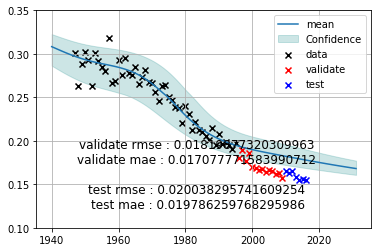

  1%|          | 11/1296 [00:24<1:01:05,  2.85s/it]

validate rmse : 0.01819877320309963 
 validate mae : 0.017077771583990712 

    test rmse : 0.020038295741609254 
 test mae : 0.019786259768295986
(('sa', 1), ('sa', 1), ('sa', 2), ('box_cox', 2))
params:[-9.15345901e-02  1.78094119e+02]


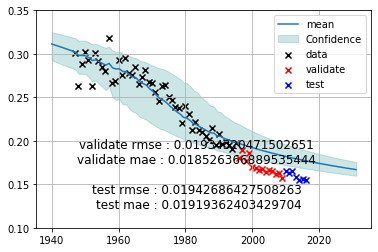

  1%|          | 12/1296 [00:25<47:46,  2.23s/it]  

validate rmse : 0.01934320471502651 
 validate mae : 0.018526366889535444 

    test rmse : 0.01942686427508263 
 test mae : 0.01919362403429704
(('sa', 1), ('sa', 1), ('sal', 1), ('sa', 1))
params:[-1.18535319e-01  2.33691416e+02]


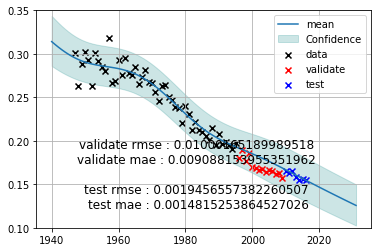

  1%|          | 13/1296 [00:28<53:33,  2.50s/it]

validate rmse : 0.01000165189989518 
 validate mae : 0.009088153955351962 

    test rmse : 0.0019456557382260507 
 test mae : 0.0014815253864527026
(('sa', 1), ('sa', 1), ('sal', 1), ('sa', 2))
params:[-1.18521609e-01  2.33662765e+02]


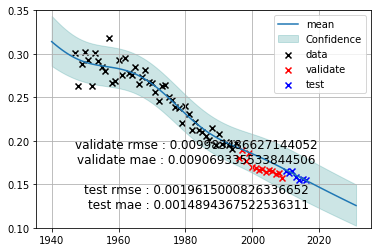

  1%|          | 14/1296 [00:30<50:11,  2.35s/it]

validate rmse : 0.009983486627144052 
 validate mae : 0.009069335533844506 

    test rmse : 0.0019615000826336652 
 test mae : 0.0014894367522536311
(('sa', 1), ('sa', 1), ('sal', 1), ('sal', 1))
params:[-1.15023914e-01  2.26510277e+02]


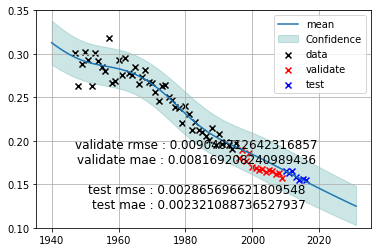

  1%|          | 15/1296 [00:32<50:16,  2.35s/it]

validate rmse : 0.009040712642316857 
 validate mae : 0.008169208240989436 

    test rmse : 0.002865696621809548 
 test mae : 0.002321088736527937
(('sa', 1), ('sa', 1), ('sal', 1), ('sal', 2))
params:[-1.16255558e+03  2.27879723e+06]


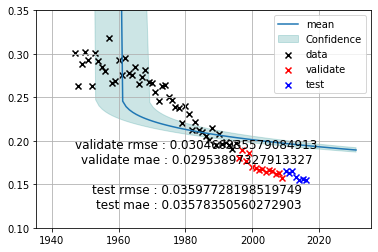

  1%|          | 16/1296 [00:35<54:05,  2.54s/it]

validate rmse : 0.030460935579084913 
 validate mae : 0.02953897327913327 

    test rmse : 0.03597728198519749 
 test mae : 0.03578350560272903
(('sa', 1), ('sa', 1), ('sal', 1), ('box_cox', 1))
params:[-1.16844212e-01  2.29340516e+02]


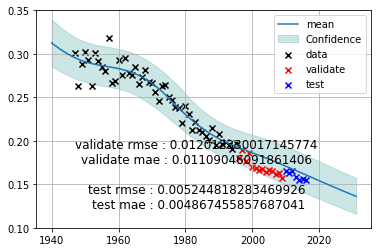

  1%|▏         | 17/1296 [00:37<48:17,  2.27s/it]

validate rmse : 0.012012330017145774 
 validate mae : 0.01109046091861406 

    test rmse : 0.005244818283469926 
 test mae : 0.004867455857687041
(('sa', 1), ('sa', 1), ('sal', 1), ('box_cox', 2))
params:[-1.15734105e-01  2.26100916e+02]


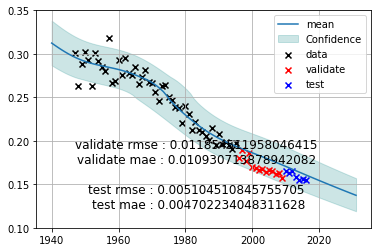

  1%|▏         | 18/1296 [00:38<40:46,  1.91s/it]

validate rmse : 0.011854511958046415 
 validate mae : 0.010930713878942082 

    test rmse : 0.005104510845755705 
 test mae : 0.004702234048311628
(('sa', 1), ('sa', 1), ('sal', 2), ('sa', 1))
params:[-1.19119039e-01  2.34807111e+02]


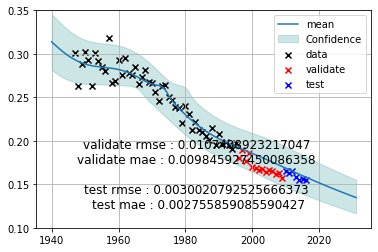

  1%|▏         | 19/1296 [00:45<1:12:35,  3.41s/it]

validate rmse : 0.0107408923217047 
 validate mae : 0.009845927450086358 

    test rmse : 0.0030020792525666373 
 test mae : 0.002755859085590427
(('sa', 1), ('sa', 1), ('sal', 2), ('sa', 2))
params:[-1.16732220e-01  2.30047658e+02]


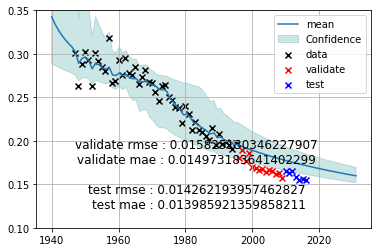

  2%|▏         | 20/1296 [01:21<4:43:17, 13.32s/it]

validate rmse : 0.015825130346227907 
 validate mae : 0.014973183641402299 

    test rmse : 0.014262193957462827 
 test mae : 0.013985921359858211
(('sa', 1), ('sa', 1), ('sal', 2), ('sal', 1))
params:[-1.18380521e-01  2.33358802e+02]


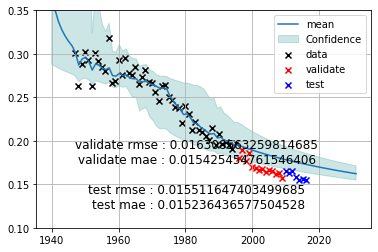

  2%|▏         | 21/1296 [01:45<5:50:04, 16.47s/it]

validate rmse : 0.016308563259814685 
 validate mae : 0.015425454761546406 

    test rmse : 0.015511647403499685 
 test mae : 0.015236436577504528
(('sa', 1), ('sa', 1), ('sal', 2), ('sal', 2))
params:[-1.55090396e-01  3.02742844e+02]


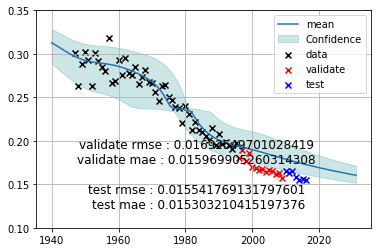

  2%|▏         | 22/1296 [01:50<4:37:53, 13.09s/it]

validate rmse : 0.01692549701028419 
 validate mae : 0.015969905260314308 

    test rmse : 0.015541769131797601 
 test mae : 0.015303210415197376
(('sa', 1), ('sa', 1), ('sal', 2), ('box_cox', 1))
params:[-2.43241726e-01  4.80993279e+02]


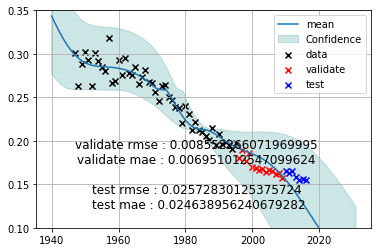

  2%|▏         | 23/1296 [01:54<3:37:20, 10.24s/it]

validate rmse : 0.008552266071969995 
 validate mae : 0.006951012547099624 

    test rmse : 0.02572830125375724 
 test mae : 0.024638956240679282
(('sa', 1), ('sa', 1), ('sal', 2), ('box_cox', 2))
params:[-1.11733184e-01  2.17820765e+02]


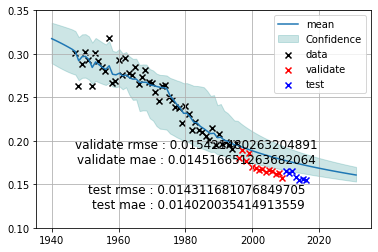

  2%|▏         | 24/1296 [02:11<4:20:07, 12.27s/it]

validate rmse : 0.015421480263204891 
 validate mae : 0.014516651263682064 

    test rmse : 0.014311681076849705 
 test mae : 0.014020035414913559
(('sa', 1), ('sa', 1), ('box_cox', 1), ('sa', 1))
params:[-8.77005893e-02  1.71973567e+02]


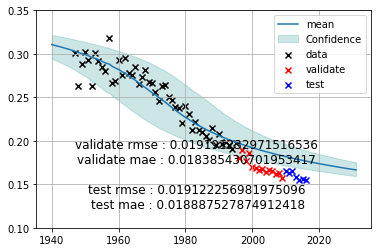

  2%|▏         | 25/1296 [02:11<3:05:26,  8.75s/it]

validate rmse : 0.019191232971516536 
 validate mae : 0.018385430701953417 

    test rmse : 0.019122256981975096 
 test mae : 0.018887527874912418
(('sa', 1), ('sa', 1), ('box_cox', 1), ('sa', 2))
params:[-8.77005591e-02  1.71973508e+02]


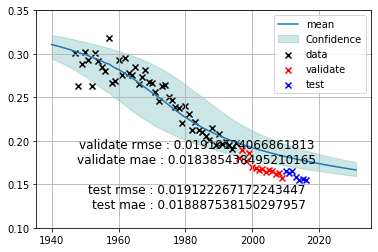

  2%|▏         | 26/1296 [02:12<2:14:12,  6.34s/it]

validate rmse : 0.01919124066861813 
 validate mae : 0.018385438495210165 

    test rmse : 0.019122267172243447 
 test mae : 0.018887538150297957
(('sa', 1), ('sa', 1), ('box_cox', 1), ('sal', 1))
params:[-1.17306316e-01  2.31231731e+02]


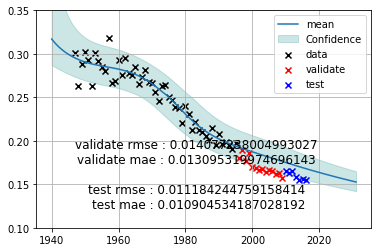

  2%|▏         | 27/1296 [02:16<2:00:23,  5.69s/it]

validate rmse : 0.014077238004993027 
 validate mae : 0.013095319974696143 

    test rmse : 0.011184244759158414 
 test mae : 0.010904534187028192
(('sa', 1), ('sa', 1), ('box_cox', 1), ('sal', 2))
params:[-1.20984209e-01  2.38352438e+02]


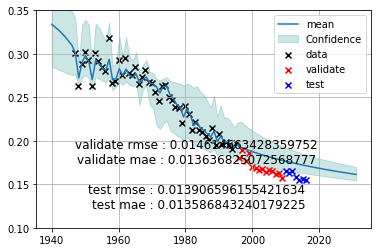

  2%|▏         | 28/1296 [02:25<2:18:09,  6.54s/it]

validate rmse : 0.014614663428359752 
 validate mae : 0.013636825072568777 

    test rmse : 0.013906596155421634 
 test mae : 0.013586843240179225
(('sa', 1), ('sa', 1), ('box_cox', 1), ('box_cox', 1))
params:[-9.49112369e-02  1.84679872e+02]


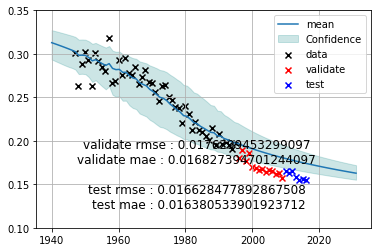

  2%|▏         | 29/1296 [02:25<1:40:55,  4.78s/it]

validate rmse : 0.0176299453299097 
 validate mae : 0.016827394701244097 

    test rmse : 0.016628477892867508 
 test mae : 0.016380533901923712
(('sa', 1), ('sa', 1), ('box_cox', 1), ('box_cox', 2))
params:[-8.88971076e-02  1.71776654e+02]


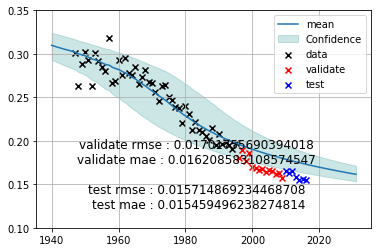

  2%|▏         | 30/1296 [02:26<1:14:51,  3.55s/it]

validate rmse : 0.01701755690394018 
 validate mae : 0.016208583108574547 

    test rmse : 0.015714869234468708 
 test mae : 0.015459496238274814
(('sa', 1), ('sa', 1), ('box_cox', 2), ('sa', 1))
params:[-7.75550260e-02  1.51300868e+02]


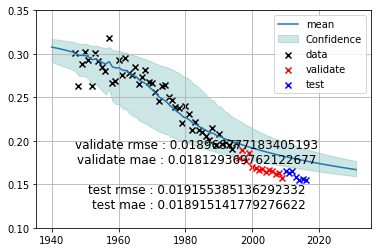

  2%|▏         | 31/1296 [02:27<57:09,  2.71s/it]  

validate rmse : 0.018968777183405193 
 validate mae : 0.018129369762122677 

    test rmse : 0.019155385136292332 
 test mae : 0.018915141779276622
(('sa', 1), ('sa', 1), ('box_cox', 2), ('sa', 2))
params:[-7.75551962e-02  1.51301196e+02]


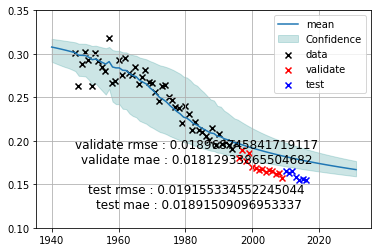

  2%|▏         | 32/1296 [02:28<44:42,  2.12s/it]

validate rmse : 0.018968745841719117 
 validate mae : 0.01812933865504682 

    test rmse : 0.019155334552245044 
 test mae : 0.01891509096953337
(('sa', 1), ('sa', 1), ('box_cox', 2), ('sal', 1))
params:[-1.09345851e-01  2.15649346e+02]


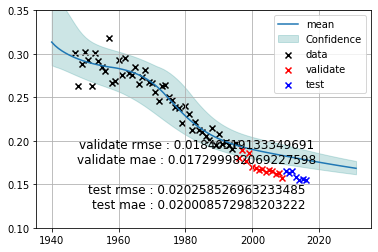

  3%|▎         | 33/1296 [02:29<37:00,  1.76s/it]

validate rmse : 0.01840519133349691 
 validate mae : 0.017299982069227598 

    test rmse : 0.020258526963233485 
 test mae : 0.020008572983203222
(('sa', 1), ('sa', 1), ('box_cox', 2), ('sal', 2))
params:[-1.18137431e-01  2.32861332e+02]


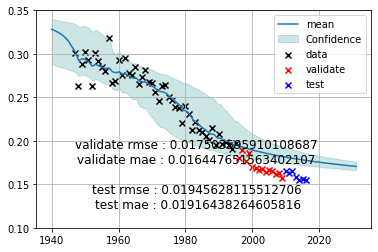

  3%|▎         | 34/1296 [02:31<44:24,  2.11s/it]

validate rmse : 0.017503595910108687 
 validate mae : 0.016447651563402107 

    test rmse : 0.01945628115512706 
 test mae : 0.01916438264605816
(('sa', 1), ('sa', 1), ('box_cox', 2), ('box_cox', 1))
params:[-8.63743890e-02  1.66838301e+02]


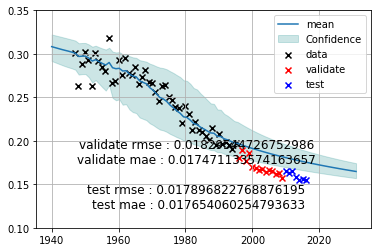

  3%|▎         | 35/1296 [02:32<35:01,  1.67s/it]

validate rmse : 0.01829544726752986 
 validate mae : 0.017471133574163657 

    test rmse : 0.017896822768876195 
 test mae : 0.017654060254793633
(('sa', 1), ('sa', 1), ('box_cox', 2), ('box_cox', 2))
params:[-7.47076214e-02  1.42812378e+02]


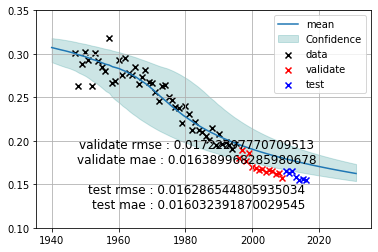

  3%|▎         | 36/1296 [02:33<29:20,  1.40s/it]

validate rmse : 0.01722297770709513 
 validate mae : 0.016389968285980678 

    test rmse : 0.016286544805935034 
 test mae : 0.016032391870029545
(('sa', 1), ('sa', 2), ('sa', 1), ('sa', 1))
params:[-9.23418464e-02  1.81848576e+02]


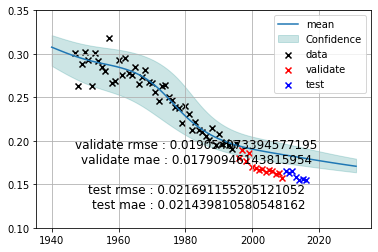

  3%|▎         | 37/1296 [02:34<24:25,  1.16s/it]

validate rmse : 0.019054073394577195 
 validate mae : 0.01790946143815954 

    test rmse : 0.021691155205121052 
 test mae : 0.021439810580548162
(('sa', 1), ('sa', 2), ('sa', 1), ('sa', 2))
params:[-9.23416873e-02  1.81848265e+02]


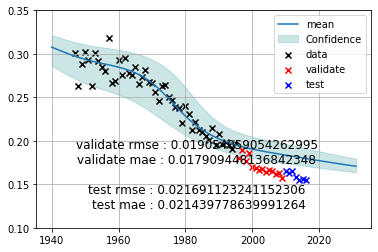

  3%|▎         | 38/1296 [02:34<21:29,  1.02s/it]

validate rmse : 0.019054059054262995 
 validate mae : 0.017909448136842348 

    test rmse : 0.021691123241152306 
 test mae : 0.021439778639991264
(('sa', 1), ('sa', 2), ('sa', 1), ('sal', 1))
params:[-1.18682090e-01  2.33912735e+02]


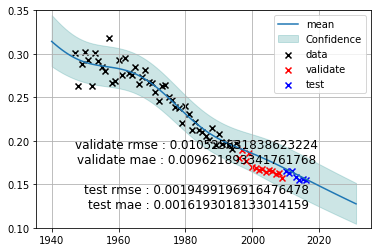

  3%|▎         | 39/1296 [02:36<25:22,  1.21s/it]

validate rmse : 0.010525631838623224 
 validate mae : 0.009621893341761768 

    test rmse : 0.0019499196916476478 
 test mae : 0.0016193018133014159
(('sa', 1), ('sa', 2), ('sa', 1), ('sal', 2))
params:[-6.65473002e+00  1.28715951e+04]


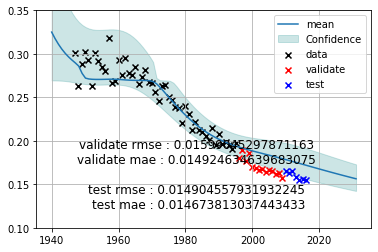

  3%|▎         | 40/1296 [02:49<1:40:03,  4.78s/it]

validate rmse : 0.01599045297871163 
 validate mae : 0.014924634639683075 

    test rmse : 0.014904557931932245 
 test mae : 0.014673813037443433
(('sa', 1), ('sa', 2), ('sa', 1), ('box_cox', 1))
params:[-9.51593408e-02  1.86341460e+02]


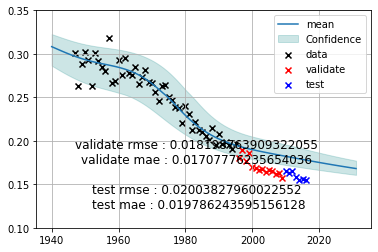

  3%|▎         | 41/1296 [02:50<1:14:43,  3.57s/it]

validate rmse : 0.018198763909322055 
 validate mae : 0.01707776235654036 

    test rmse : 0.02003827960022552 
 test mae : 0.019786243595156128
(('sa', 1), ('sa', 2), ('sa', 1), ('box_cox', 2))
params:[-9.15346357e-02  1.78094207e+02]


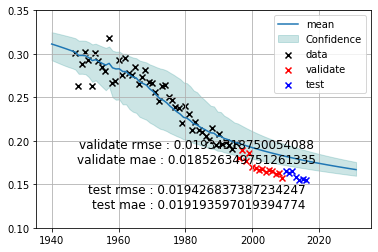

  3%|▎         | 42/1296 [02:50<56:55,  2.72s/it]  

validate rmse : 0.01934318750054088 
 validate mae : 0.018526349751261335 

    test rmse : 0.019426837387234247 
 test mae : 0.019193597019394774
(('sa', 1), ('sa', 2), ('sa', 2), ('sa', 1))
params:[-9.23416887e-02  1.81848268e+02]


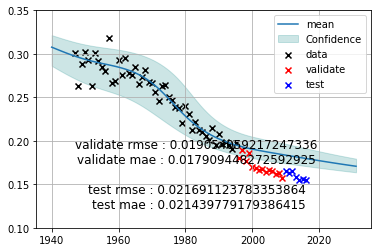

  3%|▎         | 43/1296 [02:51<44:42,  2.14s/it]

validate rmse : 0.019054059217247336 
 validate mae : 0.017909448272592925 

    test rmse : 0.021691123783353864 
 test mae : 0.021439779179386415
(('sa', 1), ('sa', 2), ('sa', 2), ('sa', 2))
params:[-9.23422100e-02  1.81849282e+02]


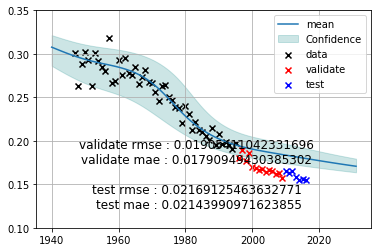

  3%|▎         | 44/1296 [02:52<36:25,  1.75s/it]

validate rmse : 0.01905411042331696 
 validate mae : 0.01790949430385302 

    test rmse : 0.02169125463632771 
 test mae : 0.02143990971623855
(('sa', 1), ('sa', 2), ('sa', 2), ('sal', 1))
params:[-1.18188539e-01  2.32922492e+02]


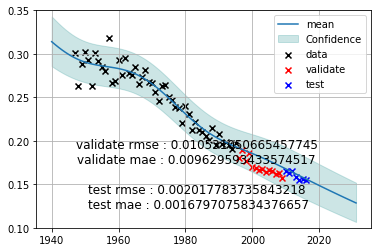

  3%|▎         | 45/1296 [02:53<34:07,  1.64s/it]

validate rmse : 0.010531050665457745 
 validate mae : 0.009629593433574517 

    test rmse : 0.002017783735843218 
 test mae : 0.0016797075834376657
(('sa', 1), ('sa', 2), ('sa', 2), ('sal', 2))
params:[-1.80849624e+07  3.58922809e+10]


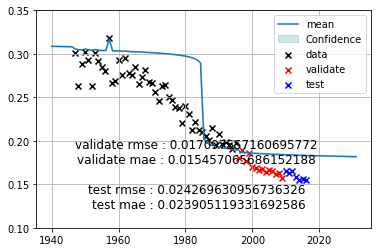

  4%|▎         | 46/1296 [03:19<3:00:30,  8.66s/it]

validate rmse : 0.017097557160695772 
 validate mae : 0.015457065686152188 

    test rmse : 0.024269630956736326 
 test mae : 0.023905119331692586
(('sa', 1), ('sa', 2), ('sa', 2), ('box_cox', 1))
params:[-9.51593405e-02  1.86341457e+02]


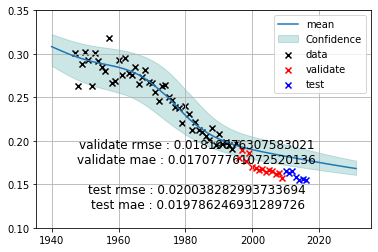

  4%|▎         | 47/1296 [03:19<2:11:27,  6.32s/it]

validate rmse : 0.01819876307583021 
 validate mae : 0.017077761072520136 

    test rmse : 0.020038282993733694 
 test mae : 0.019786246931289726
(('sa', 1), ('sa', 2), ('sa', 2), ('box_cox', 2))
params:[-9.15345893e-02  1.78094115e+02]


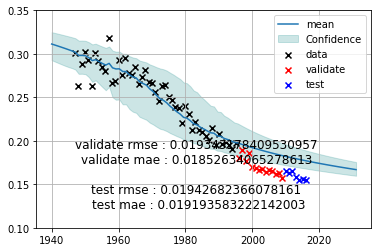

  4%|▎         | 48/1296 [03:20<1:37:34,  4.69s/it]

validate rmse : 0.019343178409530957 
 validate mae : 0.01852634065278613 

    test rmse : 0.01942682366078161 
 test mae : 0.019193583222142003
(('sa', 1), ('sa', 2), ('sal', 1), ('sa', 1))
params:[-1.18437581e-01  2.33495743e+02]


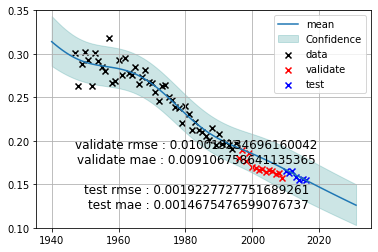

  4%|▍         | 49/1296 [03:22<1:20:57,  3.89s/it]

validate rmse : 0.010019134696160042 
 validate mae : 0.009106758641135365 

    test rmse : 0.0019227727751689261 
 test mae : 0.0014675476599076737
(('sa', 1), ('sa', 2), ('sal', 1), ('sa', 2))
params:[-1.18464504e-01  2.33550058e+02]


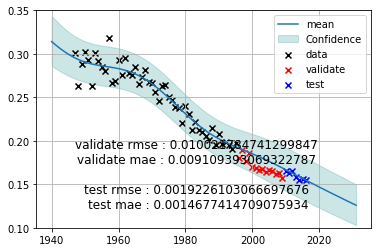

  4%|▍         | 50/1296 [03:25<1:16:28,  3.68s/it]

validate rmse : 0.010021784741299847 
 validate mae : 0.009109393069322787 

    test rmse : 0.0019226103066697676 
 test mae : 0.0014677414709075934
(('sa', 1), ('sa', 2), ('sal', 1), ('sal', 1))
params:[-1.16035068e-01  2.28504895e+02]


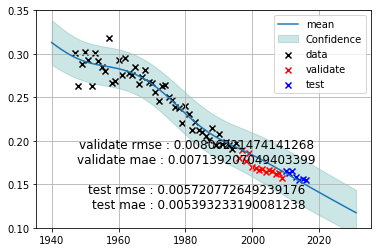

  4%|▍         | 51/1296 [03:28<1:07:01,  3.23s/it]

validate rmse : 0.00806221474141268 
 validate mae : 0.007139207049403399 

    test rmse : 0.005720772649239176 
 test mae : 0.005393233190081238
(('sa', 1), ('sa', 2), ('sal', 1), ('sal', 2))
params:[-1.07045059e-01  2.10815013e+02]


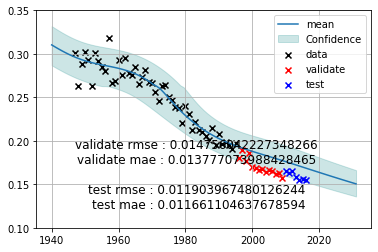

  4%|▍         | 52/1296 [03:33<1:22:09,  3.96s/it]

validate rmse : 0.014756042227348266 
 validate mae : 0.013777073988428465 

    test rmse : 0.011903967480126244 
 test mae : 0.011661104637678594
(('sa', 1), ('sa', 2), ('sal', 1), ('box_cox', 1))
params:[-1.16623563e-01  2.28929463e+02]


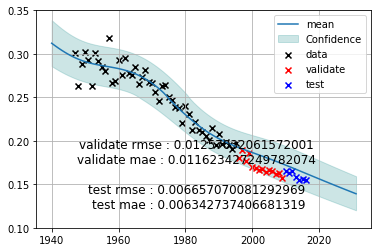

  4%|▍         | 53/1296 [03:35<1:09:03,  3.33s/it]

validate rmse : 0.01257032061572001 
 validate mae : 0.011623427249782074 

    test rmse : 0.006657070081292969 
 test mae : 0.006342737406681319
(('sa', 1), ('sa', 2), ('sal', 1), ('box_cox', 2))
params:[-1.16617325e-01  2.27869653e+02]


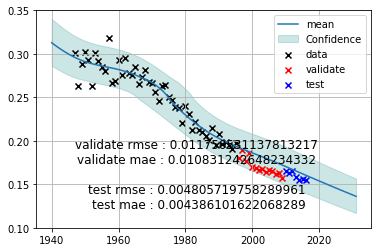

  4%|▍         | 54/1296 [03:37<1:00:45,  2.94s/it]

validate rmse : 0.011750531137813217 
 validate mae : 0.010831242648234332 

    test rmse : 0.004805719758289961 
 test mae : 0.004386101622068289
(('sa', 1), ('sa', 2), ('sal', 2), ('sa', 1))
params:[-1.18510753e-01  2.33585257e+02]


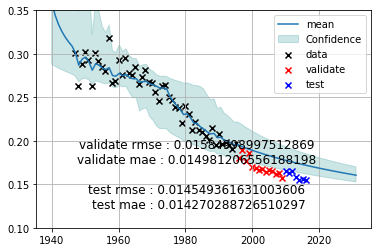

  4%|▍         | 55/1296 [03:50<2:02:10,  5.91s/it]

validate rmse : 0.01584998997512869 
 validate mae : 0.014981206556188198 

    test rmse : 0.014549361631003606 
 test mae : 0.014270288726510297
(('sa', 1), ('sa', 2), ('sal', 2), ('sa', 2))
params:[-7.55286149e-02  1.47476794e+02]


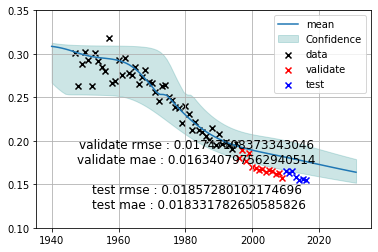

  4%|▍         | 56/1296 [03:56<2:05:06,  6.05s/it]

validate rmse : 0.01747108373343046 
 validate mae : 0.016340797562940514 

    test rmse : 0.01857280102174696 
 test mae : 0.018331782650585826
(('sa', 1), ('sa', 2), ('sal', 2), ('sal', 1))
params:[-1.15282982e-01  2.27248852e+02]


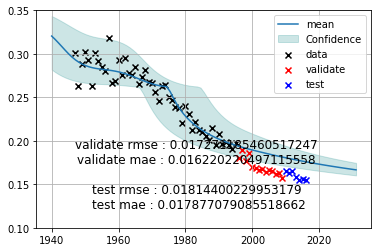

  4%|▍         | 57/1296 [04:02<2:04:14,  6.02s/it]

validate rmse : 0.017271185460517247 
 validate mae : 0.016220220497115558 

    test rmse : 0.01814400229953179 
 test mae : 0.017877079085518662
(('sa', 1), ('sa', 2), ('sal', 2), ('sal', 2))
params:[-1.25570214e-01  2.47828943e+02]


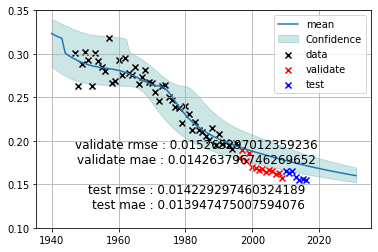

  4%|▍         | 58/1296 [04:15<2:44:58,  8.00s/it]

validate rmse : 0.015265297012359236 
 validate mae : 0.014263796746269652 

    test rmse : 0.014229297460324189 
 test mae : 0.013947475007594076
(('sa', 1), ('sa', 2), ('sal', 2), ('box_cox', 1))
params:[-1.17829879e-01  2.31336386e+02]


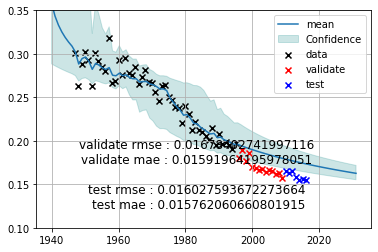

  5%|▍         | 59/1296 [04:30<3:29:48, 10.18s/it]

validate rmse : 0.01678402741997116 
 validate mae : 0.01591964195978051 

    test rmse : 0.016027593672273664 
 test mae : 0.015762060660801915
(('sa', 1), ('sa', 2), ('sal', 2), ('box_cox', 2))
params:[-1.13688367e-01  2.22050972e+02]


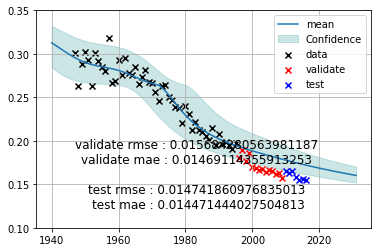

  5%|▍         | 60/1296 [04:42<3:37:35, 10.56s/it]

validate rmse : 0.015684280563981187 
 validate mae : 0.01469114355913253 

    test rmse : 0.014741860976835013 
 test mae : 0.014471444027504813
(('sa', 1), ('sa', 2), ('box_cox', 1), ('sa', 1))
params:[-8.77005804e-02  1.71973549e+02]


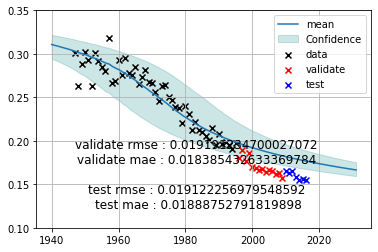

  5%|▍         | 61/1296 [04:42<2:36:02,  7.58s/it]

validate rmse : 0.019191234700027072 
 validate mae : 0.018385432633369784 

    test rmse : 0.019122256979548592 
 test mae : 0.01888752791819898
(('sa', 1), ('sa', 2), ('box_cox', 1), ('sa', 2))
params:[-8.77005783e-02  1.71973545e+02]


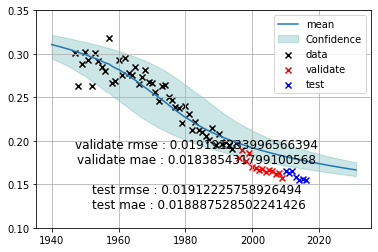

  5%|▍         | 62/1296 [04:43<1:54:04,  5.55s/it]

validate rmse : 0.019191233996566394 
 validate mae : 0.018385431799100568 

    test rmse : 0.01912225758926494 
 test mae : 0.018887528502241426
(('sa', 1), ('sa', 2), ('box_cox', 1), ('sal', 1))
params:[-1.17289989e-01  2.31199451e+02]


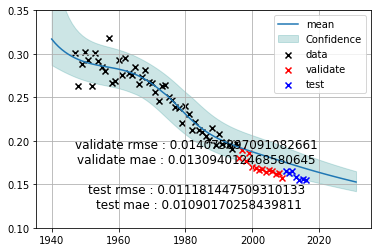

  5%|▍         | 63/1296 [04:46<1:40:09,  4.87s/it]

validate rmse : 0.014075897091082661 
 validate mae : 0.013094012468580645 

    test rmse : 0.011181447509310133 
 test mae : 0.01090170258439811
(('sa', 1), ('sa', 2), ('box_cox', 1), ('sal', 2))
params:[-3.15918853e+08  6.19351037e+11]


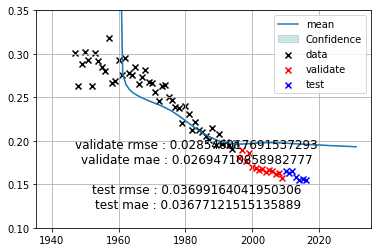

  5%|▍         | 64/1296 [05:08<3:25:39, 10.02s/it]

validate rmse : 0.028546017691537293 
 validate mae : 0.02694710858982777 

    test rmse : 0.03699164041950306 
 test mae : 0.03677121515135889
(('sa', 1), ('sa', 2), ('box_cox', 1), ('box_cox', 1))
params:[-9.49112440e-02  1.84679886e+02]


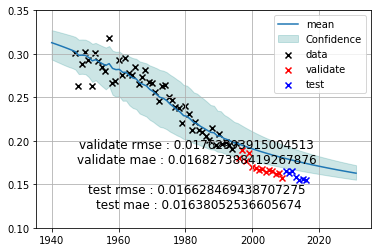

  5%|▌         | 65/1296 [05:09<2:28:04,  7.22s/it]

validate rmse : 0.01762993915004513 
 validate mae : 0.016827388419267876 

    test rmse : 0.016628469438707275 
 test mae : 0.01638052536605674
(('sa', 1), ('sa', 2), ('box_cox', 1), ('box_cox', 2))
params:[-8.88970821e-02  1.71776601e+02]


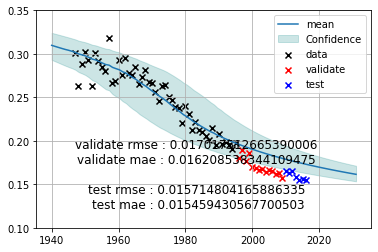

  5%|▌         | 66/1296 [05:10<1:48:30,  5.29s/it]

validate rmse : 0.017017512665390006 
 validate mae : 0.016208538344109475 

    test rmse : 0.015714804165886335 
 test mae : 0.015459430567700503
(('sa', 1), ('sa', 2), ('box_cox', 2), ('sa', 1))
params:[-7.75550229e-02  1.51300860e+02]


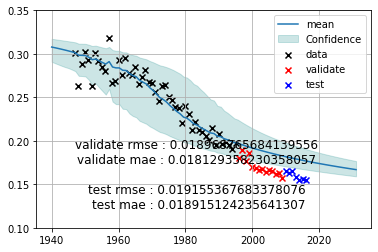

  5%|▌         | 67/1296 [05:11<1:20:51,  3.95s/it]

validate rmse : 0.018968765684139556 
 validate mae : 0.018129358230358057 

    test rmse : 0.019155367683378076 
 test mae : 0.018915124235641307
(('sa', 1), ('sa', 2), ('box_cox', 2), ('sa', 2))
params:[-7.75550701e-02  1.51300953e+02]


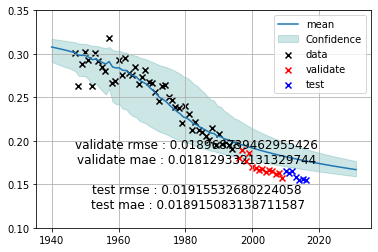

  5%|▌         | 68/1296 [05:12<1:01:44,  3.02s/it]

validate rmse : 0.018968739462955426 
 validate mae : 0.018129332131329744 

    test rmse : 0.01915532680224058 
 test mae : 0.018915083138711587
(('sa', 1), ('sa', 2), ('box_cox', 2), ('sal', 1))
params:[-1.09344927e-01  2.15647529e+02]


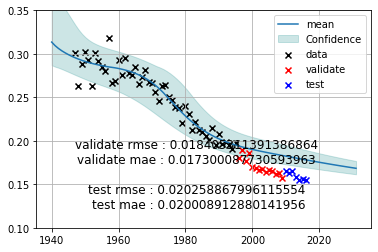

  5%|▌         | 69/1296 [05:13<49:32,  2.42s/it]  

validate rmse : 0.018405311391386864 
 validate mae : 0.017300087730593963 

    test rmse : 0.020258867996115554 
 test mae : 0.020008912880141956
(('sa', 1), ('sa', 2), ('box_cox', 2), ('sal', 2))
params:[-4.97647839e+03  9.75296849e+06]


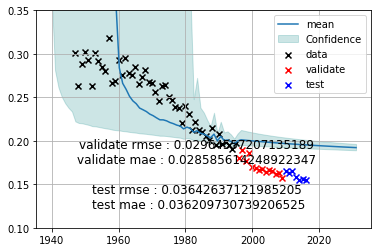

  5%|▌         | 70/1296 [05:15<50:44,  2.48s/it]

validate rmse : 0.02964557207135189 
 validate mae : 0.028585614248922347 

    test rmse : 0.03642637121985205 
 test mae : 0.036209730739206525
(('sa', 1), ('sa', 2), ('box_cox', 2), ('box_cox', 1))
params:[-8.63743126e-02  1.66838147e+02]


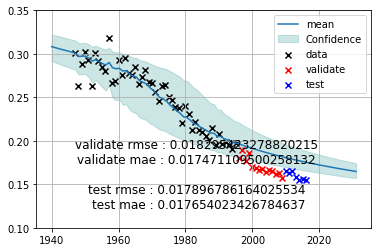

  5%|▌         | 71/1296 [05:16<40:20,  1.98s/it]

validate rmse : 0.018295423278820215 
 validate mae : 0.017471109500258132 

    test rmse : 0.017896786164025534 
 test mae : 0.017654023426784637
(('sa', 1), ('sa', 2), ('box_cox', 2), ('box_cox', 2))
params:[-7.47075347e-02  1.42812205e+02]


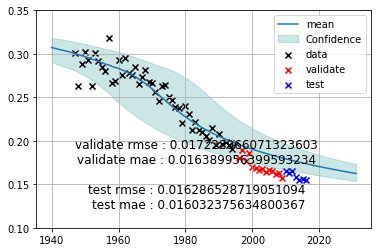

  6%|▌         | 72/1296 [05:17<32:43,  1.60s/it]

validate rmse : 0.017222966071323603 
 validate mae : 0.016389956399593234 

    test rmse : 0.016286528719051094 
 test mae : 0.016032375634800367
(('sa', 1), ('sal', 1), ('sa', 1), ('sa', 1))
params:[-1.18015183e-01  2.32613065e+02]


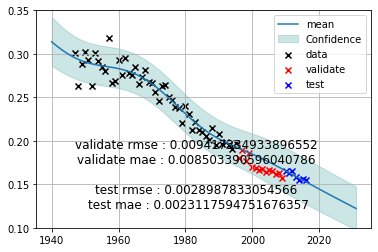

  6%|▌         | 73/1296 [05:19<37:26,  1.84s/it]

validate rmse : 0.009417334933896552 
 validate mae : 0.008503390596040786 

    test rmse : 0.0028987833054566 
 test mae : 0.0023117594751676357
(('sa', 1), ('sal', 1), ('sa', 1), ('sa', 2))
params:[-1.18315858e-01  2.33238935e+02]


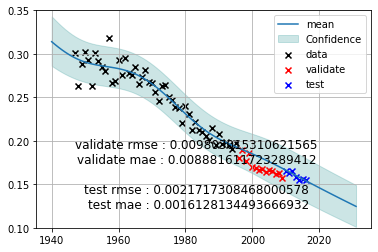

  6%|▌         | 74/1296 [05:21<38:34,  1.89s/it]

validate rmse : 0.009803015310621565 
 validate mae : 0.008881611723289412 

    test rmse : 0.0021717308468000578 
 test mae : 0.0016128134493666932
(('sa', 1), ('sal', 1), ('sa', 1), ('sal', 1))
params:[-1.15567698e-01  2.27582730e+02]


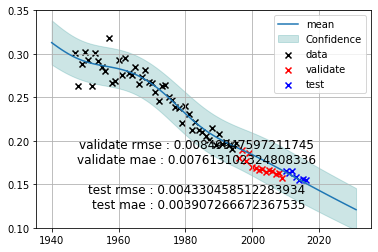

  6%|▌         | 75/1296 [05:23<38:42,  1.90s/it]

validate rmse : 0.00849947597211745 
 validate mae : 0.007613102324808336 

    test rmse : 0.004330458512283934 
 test mae : 0.003907266672367535
(('sa', 1), ('sal', 1), ('sa', 1), ('sal', 2))
params:[-1.50602330e-01  2.94730525e+02]


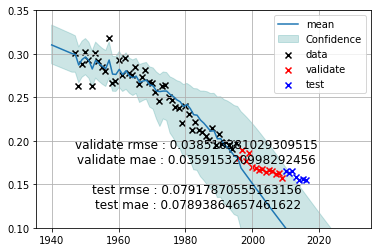

  6%|▌         | 76/1296 [05:29<1:03:00,  3.10s/it]

validate rmse : 0.038516381029309515 
 validate mae : 0.035915320998292456 

    test rmse : 0.07917870555163156 
 test mae : 0.07893864657461622
(('sa', 1), ('sal', 1), ('sa', 1), ('box_cox', 1))
params:[-1.15058490e-01  2.25860898e+02]


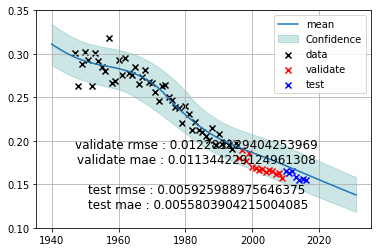

  6%|▌         | 77/1296 [05:31<55:42,  2.74s/it]  

validate rmse : 0.012281129404253969 
 validate mae : 0.011344229124961308 

    test rmse : 0.005925988975646375 
 test mae : 0.0055803904215004085
(('sa', 1), ('sal', 1), ('sa', 1), ('box_cox', 2))
params:[-1.15564765e-01  2.25834657e+02]


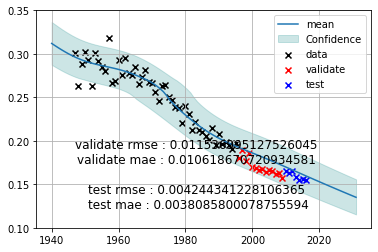

  6%|▌         | 78/1296 [05:33<51:01,  2.51s/it]

validate rmse : 0.011536995127526045 
 validate mae : 0.010618670720934581 

    test rmse : 0.004244341228106365 
 test mae : 0.0038085800078755594
(('sa', 1), ('sal', 1), ('sa', 2), ('sa', 1))
params:[-1.18529027e-01  2.33677953e+02]


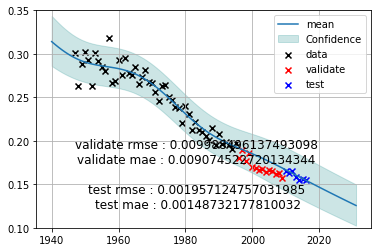

  6%|▌         | 79/1296 [05:36<53:37,  2.64s/it]

validate rmse : 0.009988496137493098 
 validate mae : 0.009074522720134344 

    test rmse : 0.001957124757031985 
 test mae : 0.00148732177810032
(('sa', 1), ('sal', 1), ('sa', 2), ('sa', 2))
params:[-1.18385621e-01  2.33392168e+02]


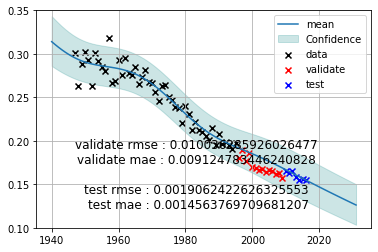

  6%|▌         | 80/1296 [05:38<50:51,  2.51s/it]

validate rmse : 0.010036285926026477 
 validate mae : 0.009124783446240828 

    test rmse : 0.0019062422626325553 
 test mae : 0.0014563769709681207
(('sa', 1), ('sal', 1), ('sa', 2), ('sal', 1))
params:[-1.16694607e-01  2.29806797e+02]


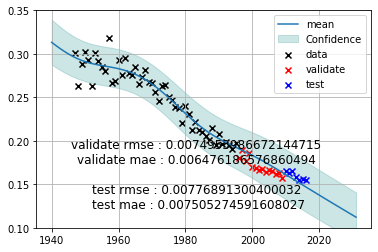

  6%|▋         | 81/1296 [05:41<56:33,  2.79s/it]

validate rmse : 0.0074953986672144715 
 validate mae : 0.006476186576860494 

    test rmse : 0.00776891300400032 
 test mae : 0.007505274591608027
(('sa', 1), ('sal', 1), ('sa', 2), ('sal', 2))
params:[-1.19837034e-01  2.36168329e+02]


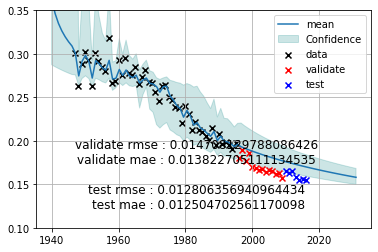

  6%|▋         | 82/1296 [06:07<3:12:34,  9.52s/it]

validate rmse : 0.014708129788086426 
 validate mae : 0.013822705111134535 

    test rmse : 0.012806356940964434 
 test mae : 0.012504702561170098
(('sa', 1), ('sal', 1), ('sa', 2), ('box_cox', 1))
params:[-1.15804470e-01  2.27416881e+02]


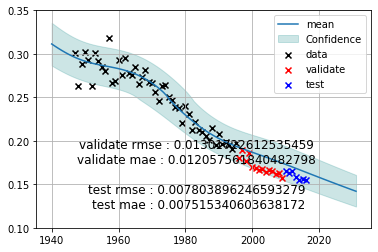

  6%|▋         | 83/1296 [06:09<2:26:10,  7.23s/it]

validate rmse : 0.01301722612535459 
 validate mae : 0.012057561840482798 

    test rmse : 0.007803896246593279 
 test mae : 0.007515340603638172
(('sa', 1), ('sal', 1), ('sa', 2), ('box_cox', 2))
params:[-1.16456000e-01  2.27644104e+02]


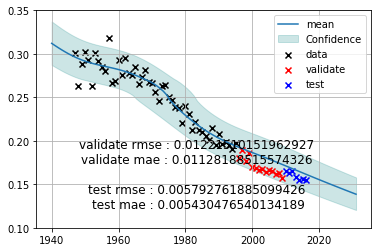

  6%|▋         | 84/1296 [06:10<1:53:06,  5.60s/it]

validate rmse : 0.01221510151962927 
 validate mae : 0.01128188515574326 

    test rmse : 0.005792761885099426 
 test mae : 0.005430476540134189
(('sa', 1), ('sal', 1), ('sal', 1), ('sa', 1))
params:[-1.15289368e-01  2.27033492e+02]


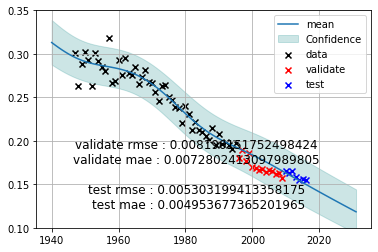

  7%|▋         | 85/1296 [06:12<1:31:39,  4.54s/it]

validate rmse : 0.008190151752498424 
 validate mae : 0.0072802413097989805 

    test rmse : 0.005303199413358175 
 test mae : 0.004953677365201965
(('sa', 1), ('sal', 1), ('sal', 1), ('sa', 2))
params:[-1.15227278e-01  2.26910818e+02]


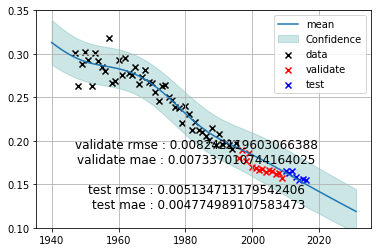

  7%|▋         | 86/1296 [06:15<1:16:50,  3.81s/it]

validate rmse : 0.008242119603066388 
 validate mae : 0.007337010744164025 

    test rmse : 0.005134713179542406 
 test mae : 0.004774989107583473
(('sa', 1), ('sal', 1), ('sal', 1), ('sal', 1))
params:[-1.19145953e-01  2.34666493e+02]


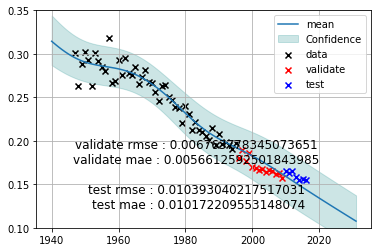

  7%|▋         | 87/1296 [06:16<1:05:29,  3.25s/it]

validate rmse : 0.006763778345073651 
 validate mae : 0.0056612592501843985 

    test rmse : 0.010393040217517031 
 test mae : 0.010172209553148074
(('sa', 1), ('sal', 1), ('sal', 1), ('sal', 2))
params:[-1.28504400e-01  2.53116009e+02]


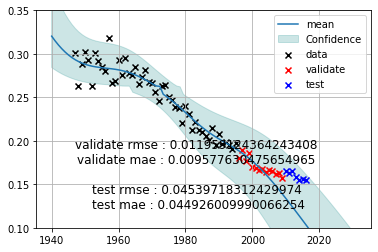

  7%|▋         | 88/1296 [06:33<2:22:57,  7.10s/it]

validate rmse : 0.011959124364243408 
 validate mae : 0.009577630475654965 

    test rmse : 0.04539718312429974 
 test mae : 0.044926009990066254
(('sa', 1), ('sal', 1), ('sal', 1), ('box_cox', 1))
params:[-1.13269612e-01  2.22131450e+02]


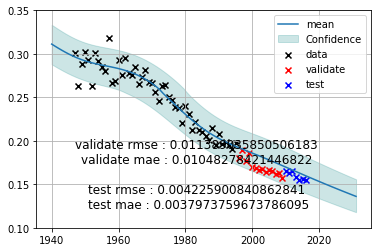

  7%|▋         | 89/1296 [06:34<1:47:14,  5.33s/it]

validate rmse : 0.011389035850506183 
 validate mae : 0.01048278421446822 

    test rmse : 0.004225900840862841 
 test mae : 0.0037973759673786095
(('sa', 1), ('sal', 1), ('sal', 1), ('box_cox', 2))
params:[-1.13948329e-01  2.22375358e+02]


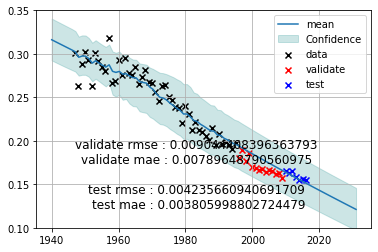

  7%|▋         | 90/1296 [06:36<1:29:56,  4.47s/it]

validate rmse : 0.009044408396363793 
 validate mae : 0.00789648790560975 

    test rmse : 0.004235660940691709 
 test mae : 0.003805998802724479
(('sa', 1), ('sal', 1), ('sal', 2), ('sa', 1))
params:[-1.31351540e-01  2.59110055e+02]


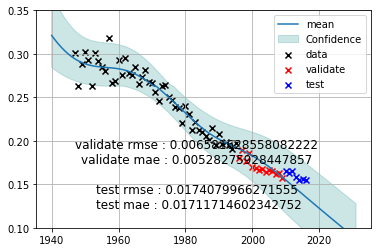

  7%|▋         | 91/1296 [06:45<1:53:18,  5.64s/it]

validate rmse : 0.006581628558082222 
 validate mae : 0.00528275928447857 

    test rmse : 0.0174079966271555 
 test mae : 0.01711714602342752
(('sa', 1), ('sal', 1), ('sal', 2), ('sa', 2))
params:[-1.08410253e-01  2.13304831e+02]


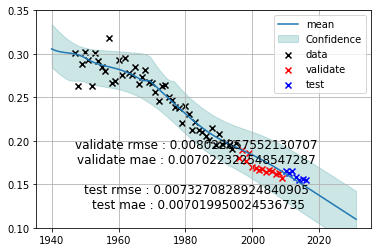

  7%|▋         | 92/1296 [06:51<1:59:22,  5.95s/it]

validate rmse : 0.008022857552130707 
 validate mae : 0.007022322548547287 

    test rmse : 0.0073270828924840905 
 test mae : 0.007019950024536735
(('sa', 1), ('sal', 1), ('sal', 2), ('sal', 1))
params:[-1.20007967e-01  2.36402564e+02]


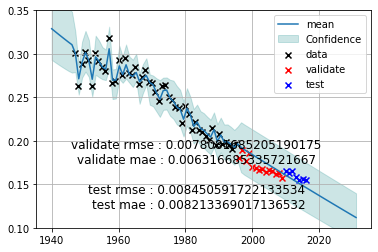

  7%|▋         | 93/1296 [07:08<3:01:57,  9.08s/it]

validate rmse : 0.0078081685205190175 
 validate mae : 0.006316685335721667 

    test rmse : 0.008450591722133534 
 test mae : 0.008213369017136532
(('sa', 1), ('sal', 1), ('sal', 2), ('sal', 2))
params:[-2.28607698e+01  4.47736684e+04]


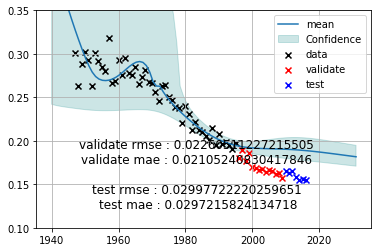

  7%|▋         | 94/1296 [07:22<3:32:10, 10.59s/it]

validate rmse : 0.02260511227215505 
 validate mae : 0.02105240830417846 

    test rmse : 0.02997722220259651 
 test mae : 0.0297215824134718
(('sa', 1), ('sal', 1), ('sal', 2), ('box_cox', 1))
params:[-1.25139016e-01  2.45586906e+02]


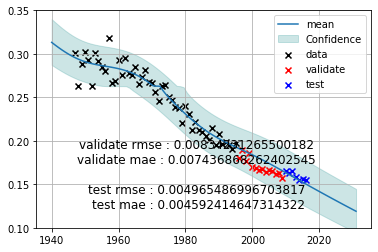

  7%|▋         | 95/1296 [07:28<3:08:10,  9.40s/it]

validate rmse : 0.00834231265500182 
 validate mae : 0.007436868262402545 

    test rmse : 0.004965486996703817 
 test mae : 0.004592414647314322
(('sa', 1), ('sal', 1), ('sal', 2), ('box_cox', 2))
params:[-1.07700786e-01  2.10091602e+02]


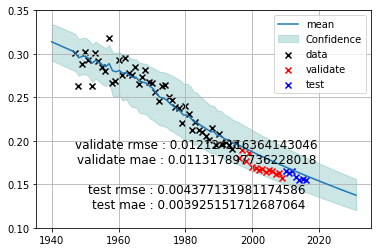

  7%|▋         | 96/1296 [07:38<3:10:16,  9.51s/it]

validate rmse : 0.012124116364143046 
 validate mae : 0.011317897736228018 

    test rmse : 0.004377131981174586 
 test mae : 0.003925151712687064
(('sa', 1), ('sal', 1), ('box_cox', 1), ('sa', 1))
params:[-1.05539397e-01  2.07503607e+02]


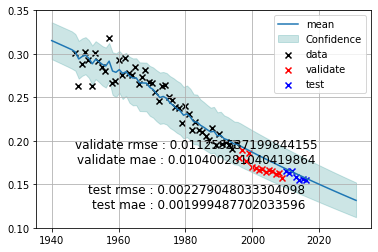

  7%|▋         | 97/1296 [07:41<2:28:20,  7.42s/it]

validate rmse : 0.011259537199844155 
 validate mae : 0.010400281040419864 

    test rmse : 0.002279048033304098 
 test mae : 0.001999487702033596
(('sa', 1), ('sal', 1), ('box_cox', 1), ('sa', 2))
params:[-1.05474596e-01  2.07378380e+02]


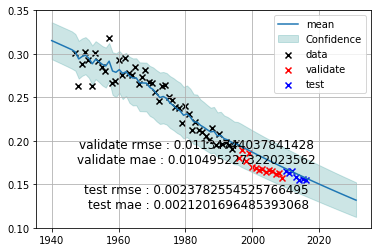

  8%|▊         | 98/1296 [07:43<1:57:00,  5.86s/it]

validate rmse : 0.01134744037841428 
 validate mae : 0.010495227322023562 

    test rmse : 0.0023782554525766495 
 test mae : 0.0021201696485393068
(('sa', 1), ('sal', 1), ('box_cox', 1), ('sal', 1))
params:[-1.23988253e-01  2.44319147e+02]


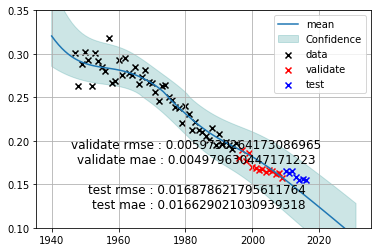

  8%|▊         | 99/1296 [07:45<1:33:42,  4.70s/it]

validate rmse : 0.0059730264173086965 
 validate mae : 0.004979630447171223 

    test rmse : 0.016878621795611764 
 test mae : 0.016629021030939318
(('sa', 1), ('sal', 1), ('box_cox', 1), ('sal', 2))
params:[-1. -1.]


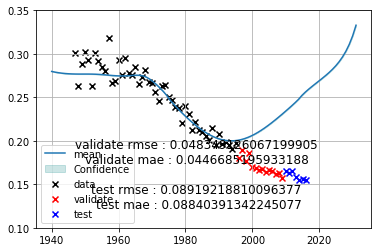

  8%|▊         | 100/1296 [07:50<1:33:33,  4.69s/it]

validate rmse : 0.048349126067199905 
 validate mae : 0.0446685195933188 

    test rmse : 0.08919218810096377 
 test mae : 0.08840391342245077
(('sa', 1), ('sal', 1), ('box_cox', 1), ('box_cox', 1))
params:[-1.16984587e-01  2.28555389e+02]


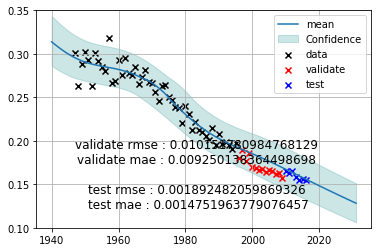

  8%|▊         | 101/1296 [07:51<1:14:14,  3.73s/it]

validate rmse : 0.010151780984768129 
 validate mae : 0.009250138364498698 

    test rmse : 0.001892482059869326 
 test mae : 0.0014751963779076457
(('sa', 1), ('sal', 1), ('box_cox', 1), ('box_cox', 2))
params:[-1.08753826e-01  2.11123902e+02]


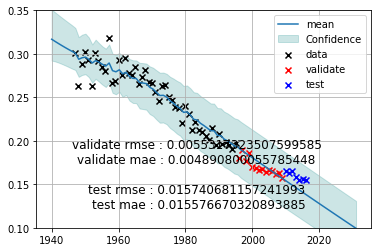

  8%|▊         | 102/1296 [07:53<1:01:10,  3.07s/it]

validate rmse : 0.0055317323507599585 
 validate mae : 0.004890800055785448 

    test rmse : 0.015740681157241993 
 test mae : 0.015576670320893885
(('sa', 1), ('sal', 1), ('box_cox', 2), ('sa', 1))
params:[-9.52740321e-02  1.86635262e+02]


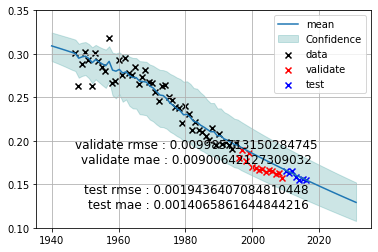

  8%|▊         | 103/1296 [07:54<52:21,  2.63s/it]  

validate rmse : 0.009985713150284745 
 validate mae : 0.00900642127309032 

    test rmse : 0.0019436407084810448 
 test mae : 0.0014065861644844216
(('sa', 1), ('sal', 1), ('box_cox', 2), ('sa', 2))
params:[-9.40612671e-02  1.84186607e+02]


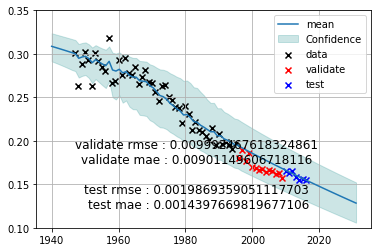

  8%|▊         | 104/1296 [07:56<48:15,  2.43s/it]

validate rmse : 0.009992467618324861 
 validate mae : 0.00901149606718116 

    test rmse : 0.0019869359051117703 
 test mae : 0.0014397669819677106
(('sa', 1), ('sal', 1), ('box_cox', 2), ('sal', 1))
params:[-1.23883586e-01  2.44143598e+02]


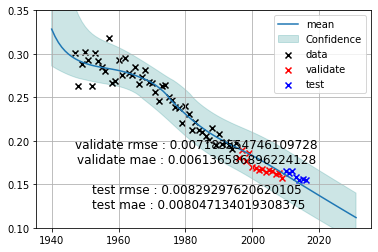

  8%|▊         | 105/1296 [07:58<41:51,  2.11s/it]

validate rmse : 0.007183554746109728 
 validate mae : 0.006136586896224128 

    test rmse : 0.00829297620620105 
 test mae : 0.008047134019308375
(('sa', 1), ('sal', 1), ('box_cox', 2), ('sal', 2))
params:[-1.20814557e-01  2.38097447e+02]


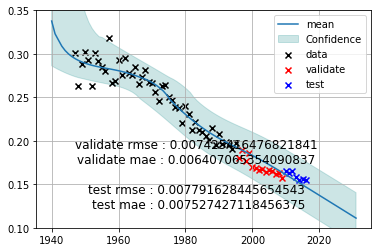

  8%|▊         | 106/1296 [08:06<1:18:10,  3.94s/it]

validate rmse : 0.007425416476821841 
 validate mae : 0.006407065354090837 

    test rmse : 0.007791628445654543 
 test mae : 0.007527427118456375
(('sa', 1), ('sal', 1), ('box_cox', 2), ('box_cox', 1))
params:[-1.09357370e-01  2.12397757e+02]


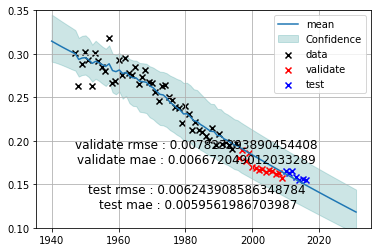

  8%|▊         | 107/1296 [08:08<1:08:13,  3.44s/it]

validate rmse : 0.007823293890454408 
 validate mae : 0.006672049012033289 

    test rmse : 0.006243908586348784 
 test mae : 0.0059561986703987
(('sa', 1), ('sal', 1), ('box_cox', 2), ('box_cox', 2))
params:[-9.42446469e-02  1.81565024e+02]


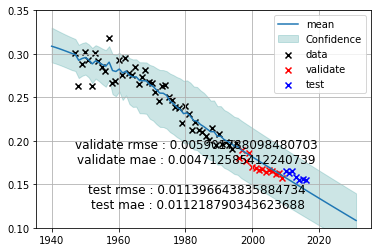

  8%|▊         | 108/1296 [08:10<57:14,  2.89s/it]  

validate rmse : 0.005901788098480703 
 validate mae : 0.004712585412240739 

    test rmse : 0.011396643835884734 
 test mae : 0.011218790343623688
(('sa', 1), ('sal', 2), ('sa', 1), ('sa', 1))
params:[-9.23543175e-02  1.81873784e+02]


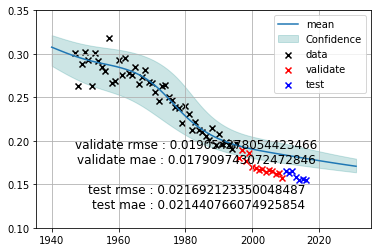

  8%|▊         | 109/1296 [08:13<1:02:06,  3.14s/it]

validate rmse : 0.019054378054423466 
 validate mae : 0.017909743072472846 

    test rmse : 0.021692123350048487 
 test mae : 0.021440766074925854
(('sa', 1), ('sal', 2), ('sa', 1), ('sa', 2))
params:[-1.00802863e-01  1.98554192e+02]


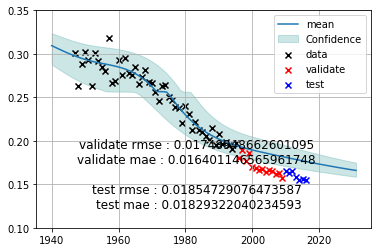

  8%|▊         | 110/1296 [08:18<1:11:21,  3.61s/it]

validate rmse : 0.01748948662601095 
 validate mae : 0.016401146565961748 

    test rmse : 0.01854729076473587 
 test mae : 0.01829322040234593
(('sa', 1), ('sal', 2), ('sa', 1), ('sal', 1))
params:[-1.16110734e-01  2.28724913e+02]


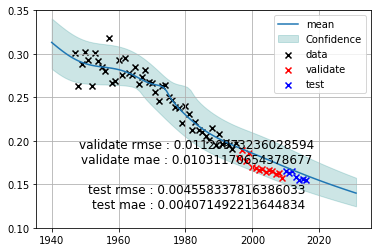

  9%|▊         | 111/1296 [08:22<1:12:07,  3.65s/it]

validate rmse : 0.01120973236028594 
 validate mae : 0.01031170654378677 

    test rmse : 0.004558337816386033 
 test mae : 0.004071492213644834
(('sa', 1), ('sal', 2), ('sa', 1), ('sal', 2))
params:[-1.18256423e-01  2.33018550e+02]


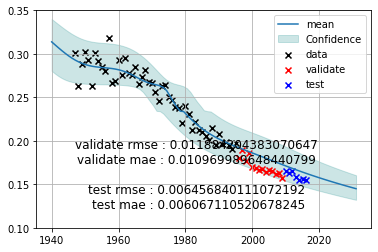

  9%|▊         | 112/1296 [08:32<1:51:53,  5.67s/it]

validate rmse : 0.011884204383070647 
 validate mae : 0.010969989648440799 

    test rmse : 0.006456840111072192 
 test mae : 0.006067110520678245
(('sa', 1), ('sal', 2), ('sa', 1), ('box_cox', 1))
params:[-9.78569245e-02  1.91773460e+02]


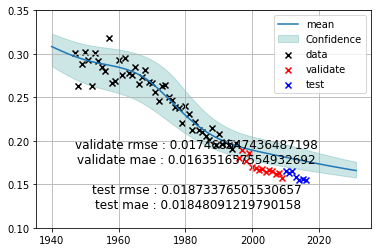

  9%|▊         | 113/1296 [08:33<1:24:32,  4.29s/it]

validate rmse : 0.017468547436487198 
 validate mae : 0.016351657554932692 

    test rmse : 0.01873376501530657 
 test mae : 0.01848091219790158
(('sa', 1), ('sal', 2), ('sa', 1), ('box_cox', 2))
params:[-1.13309630e-01  2.21483943e+02]


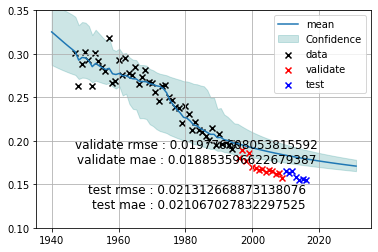

  9%|▉         | 114/1296 [08:39<1:30:35,  4.60s/it]

validate rmse : 0.019776608053815592 
 validate mae : 0.018853596622679387 

    test rmse : 0.021312668873138076 
 test mae : 0.021067027832297525
(('sa', 1), ('sal', 2), ('sa', 2), ('sa', 1))
params:[-9.58752609e-02  1.88960730e+02]


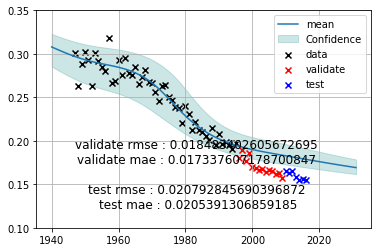

  9%|▉         | 115/1296 [09:02<3:18:41, 10.09s/it]

validate rmse : 0.018483402605672695 
 validate mae : 0.017337607178700847 

    test rmse : 0.020792845690396872 
 test mae : 0.0205391306859185
(('sa', 1), ('sal', 2), ('sa', 2), ('sa', 2))
params:[-1.17900641e-01  2.32352935e+02]


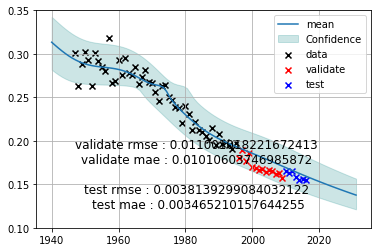

  9%|▉         | 116/1296 [09:20<4:08:29, 12.63s/it]

validate rmse : 0.011001018221672413 
 validate mae : 0.01010603746985872 

    test rmse : 0.0038139299084032122 
 test mae : 0.003465210157644255
(('sa', 1), ('sal', 2), ('sa', 2), ('sal', 1))
params:[-1.06948841e-01  2.11054104e+02]


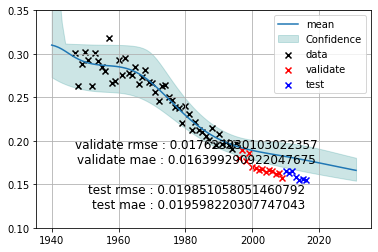

  9%|▉         | 117/1296 [09:32<4:04:19, 12.43s/it]

validate rmse : 0.017623930103022357 
 validate mae : 0.016399290922047675 

    test rmse : 0.019851058051460792 
 test mae : 0.019598220307747043
(('sa', 1), ('sal', 2), ('sa', 2), ('sal', 2))
params:[-1.40042269e+04  2.74568078e+07]


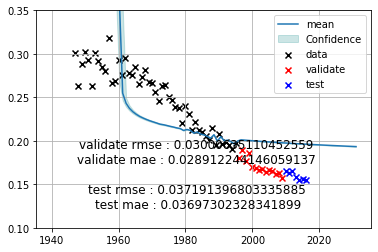

  9%|▉         | 118/1296 [09:40<3:35:12, 10.96s/it]

validate rmse : 0.03000635110452559 
 validate mae : 0.028912244146059137 

    test rmse : 0.037191396803335885 
 test mae : 0.03697302328341899
(('sa', 1), ('sal', 2), ('sa', 2), ('box_cox', 1))
params:[-2.01823162e-01  3.96779393e+02]


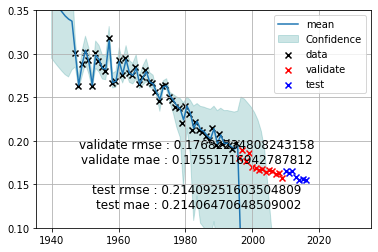

  9%|▉         | 119/1296 [09:47<3:14:00,  9.89s/it]

validate rmse : 0.17682234808243158 
 validate mae : 0.17551716942787812 

    test rmse : 0.21409251603504809 
 test mae : 0.21406470648509002
(('sa', 1), ('sal', 2), ('sa', 2), ('box_cox', 2))
params:[-8.62958975e-02  1.67259439e+02]


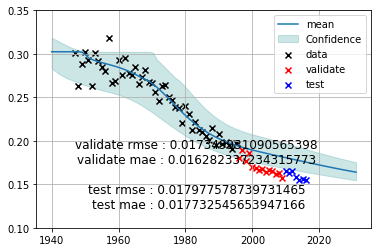

  9%|▉         | 120/1296 [10:04<3:58:26, 12.17s/it]

validate rmse : 0.017349931090565398 
 validate mae : 0.016282337234315773 

    test rmse : 0.017977578739731465 
 test mae : 0.017732545653947166
(('sa', 1), ('sal', 2), ('sal', 1), ('sa', 1))
params:[-1.08943596e-01  2.14088025e+02]


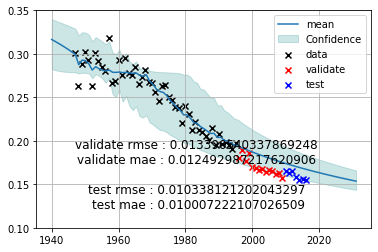

  9%|▉         | 121/1296 [10:12<3:33:25, 10.90s/it]

validate rmse : 0.013390540337869248 
 validate mae : 0.012492987217620906 

    test rmse : 0.010338121202043297 
 test mae : 0.010007222107026509
(('sa', 1), ('sal', 2), ('sal', 1), ('sa', 2))
params:[-1.22411073e-01  2.40852562e+02]


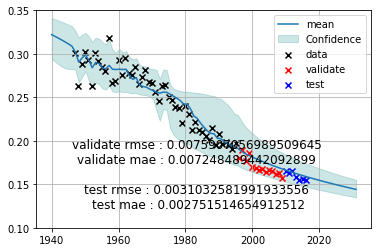

  9%|▉         | 122/1296 [10:15<2:46:04,  8.49s/it]

validate rmse : 0.0075907056989509645 
 validate mae : 0.007248489442092899 

    test rmse : 0.0031032581991933556 
 test mae : 0.002751514654912512
(('sa', 1), ('sal', 2), ('sal', 1), ('sal', 1))
params:[-1.17785622e-01  2.31932617e+02]


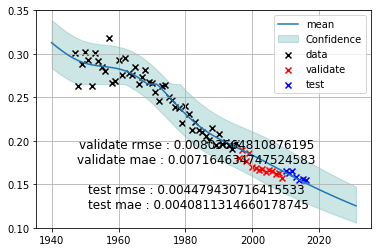

  9%|▉         | 123/1296 [11:19<8:09:12, 25.02s/it]

validate rmse : 0.00803664810876195 
 validate mae : 0.007164634747524583 

    test rmse : 0.004479430716415533 
 test mae : 0.0040811314660178745
(('sa', 1), ('sal', 2), ('sal', 1), ('sal', 2))
params:[-1.24226875e-01  2.45063118e+02]


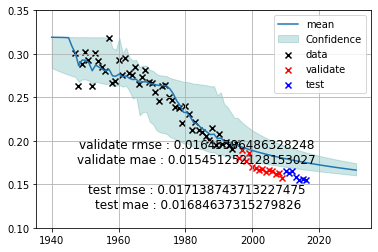

 10%|▉         | 124/1296 [11:49<8:35:59, 26.42s/it]

validate rmse : 0.01645386486328248 
 validate mae : 0.015451252128153027 

    test rmse : 0.017138743713227475 
 test mae : 0.01684637315279826
(('sa', 1), ('sal', 2), ('sal', 1), ('box_cox', 1))
params:[-1.08546922e-01  2.12605973e+02]


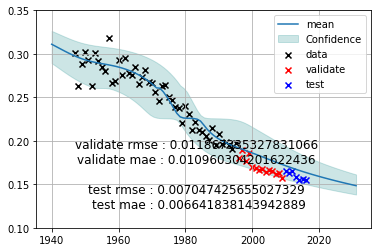

 10%|▉         | 125/1296 [11:53<6:24:44, 19.71s/it]

validate rmse : 0.011867335327831066 
 validate mae : 0.010960304201622436 

    test rmse : 0.007047425655027329 
 test mae : 0.006641838143942889
(('sa', 1), ('sal', 2), ('sal', 1), ('box_cox', 2))
params:[-1.13913727e-01  2.22443219e+02]


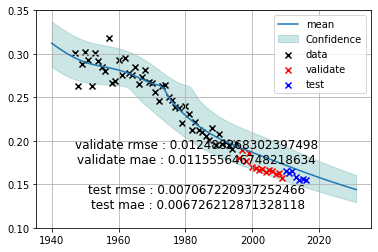

 10%|▉         | 126/1296 [11:58<4:59:13, 15.35s/it]

validate rmse : 0.012488268302397498 
 validate mae : 0.011555646748218634 

    test rmse : 0.007067220937252466 
 test mae : 0.006726212871328118
(('sa', 1), ('sal', 2), ('sal', 2), ('sa', 1))
params:[-1.64578016e-01  3.24103799e+02]


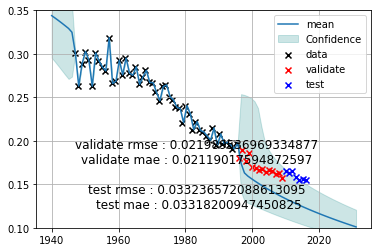

 10%|▉         | 127/1296 [12:10<4:39:00, 14.32s/it]

validate rmse : 0.021989536969334877 
 validate mae : 0.02119017594872597 

    test rmse : 0.033236572088613095 
 test mae : 0.03318200947450825
(('sa', 1), ('sal', 2), ('sal', 2), ('sa', 2))
params:[-1.18771637e-01  2.34149848e+02]


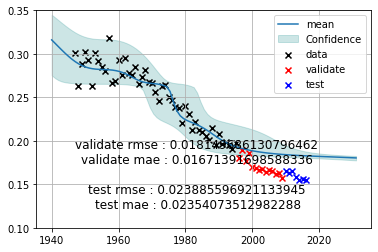

 10%|▉         | 128/1296 [12:21<4:21:45, 13.45s/it]

validate rmse : 0.018149686130796462 
 validate mae : 0.01671391698588336 

    test rmse : 0.023885596921133945 
 test mae : 0.02354073512982288
(('sa', 1), ('sal', 2), ('sal', 2), ('sal', 1))
params:[-1.04929157e-01  2.06378101e+02]


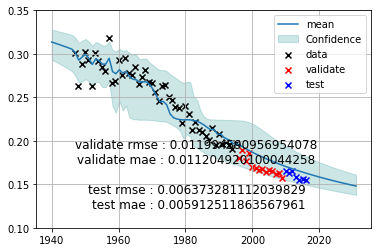

 10%|▉         | 129/1296 [12:26<3:34:43, 11.04s/it]

validate rmse : 0.011994590956954078 
 validate mae : 0.011204920100044258 

    test rmse : 0.006373281112039829 
 test mae : 0.005912511863567961
(('sa', 1), ('sal', 2), ('sal', 2), ('sal', 2))
params:[-1. -1.]


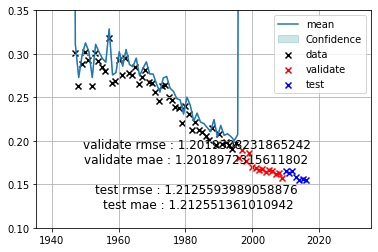

 10%|█         | 130/1296 [12:40<3:46:24, 11.65s/it]

validate rmse : 1.2019308231865242 
 validate mae : 1.2018972315611802 

    test rmse : 1.2125593989058876 
 test mae : 1.212551361010942
(('sa', 1), ('sal', 2), ('sal', 2), ('box_cox', 1))
params:[ 6.09045136e-03 -8.16085952e+00]


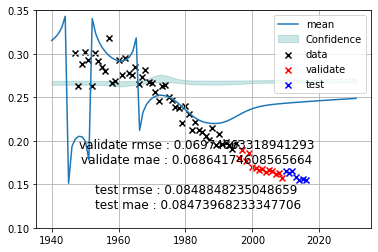

 10%|█         | 131/1296 [12:47<3:21:32, 10.38s/it]

validate rmse : 0.06974863318941293 
 validate mae : 0.06864174608565664 

    test rmse : 0.0848848235048659 
 test mae : 0.08473968233347706
(('sa', 1), ('sal', 2), ('sal', 2), ('box_cox', 2))
params:[ 2.7400008e-02 -5.1576821e+01]


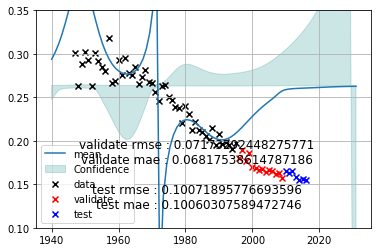

 10%|█         | 132/1296 [12:54<3:00:40,  9.31s/it]

validate rmse : 0.07173292448275771 
 validate mae : 0.06817538614787186 

    test rmse : 0.10071895776693596 
 test mae : 0.10060307589472746
(('sa', 1), ('sal', 2), ('box_cox', 1), ('sa', 1))
params:[ 1.46192525e-02 -2.78489612e+01]


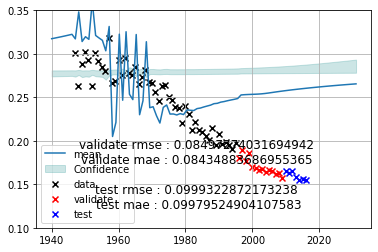

 10%|█         | 133/1296 [13:02<2:56:18,  9.10s/it]

validate rmse : 0.08497274031694942 
 validate mae : 0.08434883686955365 

    test rmse : 0.0999322872173238 
 test mae : 0.09979524904107583
(('sa', 1), ('sal', 2), ('box_cox', 1), ('sa', 2))
params:[-1.63730190e-01  3.22341682e+02]


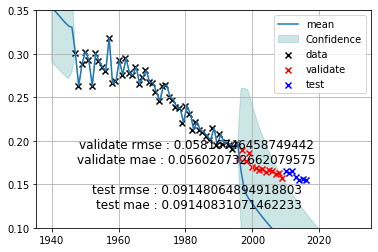

 10%|█         | 134/1296 [13:09<2:39:06,  8.22s/it]

validate rmse : 0.05816746458749442 
 validate mae : 0.056020732662079575 

    test rmse : 0.09148064894918803 
 test mae : 0.09140831071462233
(('sa', 1), ('sal', 2), ('box_cox', 1), ('sal', 1))
params:[-1.24489930e-01  2.45292363e+02]


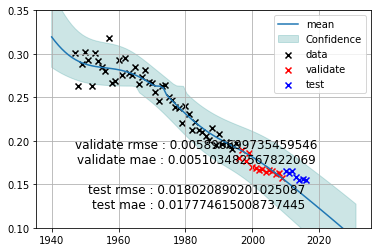

 10%|█         | 135/1296 [13:32<4:09:12, 12.88s/it]

validate rmse : 0.005896699735459546 
 validate mae : 0.005103482567822069 

    test rmse : 0.018020890201025087 
 test mae : 0.017774615008737445
(('sa', 1), ('sal', 2), ('box_cox', 1), ('sal', 2))
params:[-1.16770447e-01  2.30149034e+02]


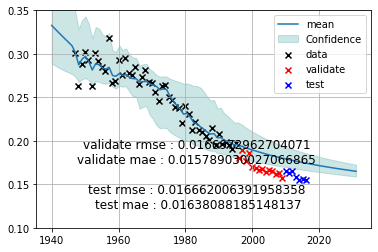

 10%|█         | 136/1296 [14:02<5:48:13, 18.01s/it]

validate rmse : 0.0166972962704071 
 validate mae : 0.015789030027066865 

    test rmse : 0.016662006391958358 
 test mae : 0.01638088185148137
(('sa', 1), ('sal', 2), ('box_cox', 1), ('box_cox', 1))
params:[ 5.57055051e-02 -1.06970673e+02]


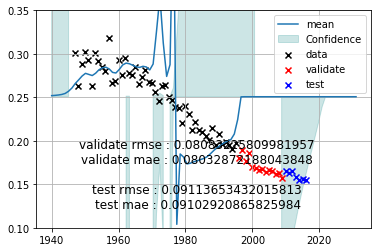

 11%|█         | 137/1296 [14:14<5:12:14, 16.16s/it]

validate rmse : 0.08083225809981957 
 validate mae : 0.08032872188043848 

    test rmse : 0.09113653432015813 
 test mae : 0.09102920865825984
(('sa', 1), ('sal', 2), ('box_cox', 1), ('box_cox', 2))
params:[ 3.85020498e-02 -7.42835684e+01]


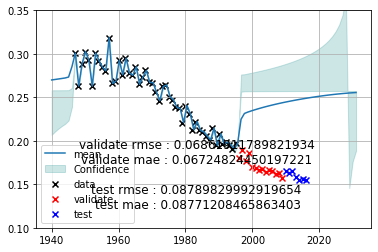

 11%|█         | 138/1296 [14:23<4:31:02, 14.04s/it]

validate rmse : 0.06861911789821934 
 validate mae : 0.06724824450197221 

    test rmse : 0.08789829992919654 
 test mae : 0.08771208465863403
(('sa', 1), ('sal', 2), ('box_cox', 2), ('sa', 1))
params:[-9.19571138e-02  1.79772446e+02]


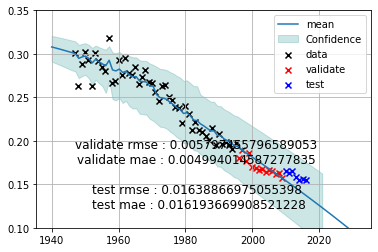

 11%|█         | 139/1296 [14:41<4:55:06, 15.30s/it]

validate rmse : 0.005797455796589053 
 validate mae : 0.004994014587277835 

    test rmse : 0.01638866975055398 
 test mae : 0.016193669908521228
(('sa', 1), ('sal', 2), ('box_cox', 2), ('sa', 2))
params:[-8.98809994e-02  1.75742271e+02]


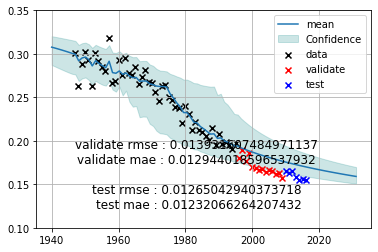

 11%|█         | 140/1296 [14:51<4:23:40, 13.69s/it]

validate rmse : 0.013931607484971137 
 validate mae : 0.012944018596537932 

    test rmse : 0.01265042940373718 
 test mae : 0.01232066264207432
(('sa', 1), ('sal', 2), ('box_cox', 2), ('sal', 1))
params:[-1. -1.]


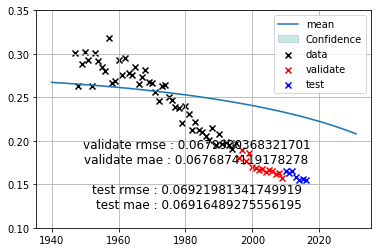

 11%|█         | 141/1296 [15:24<6:10:20, 19.24s/it]

validate rmse : 0.0679900368321701 
 validate mae : 0.0676874119178278 

    test rmse : 0.06921981341749919 
 test mae : 0.06916489275556195
(('sa', 1), ('sal', 2), ('box_cox', 2), ('sal', 2))
params:[-1. -1.]


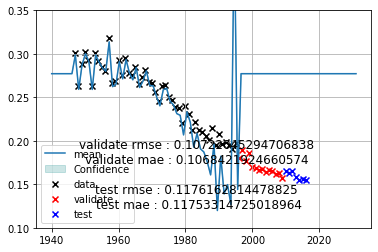

 11%|█         | 142/1296 [15:37<5:36:49, 17.51s/it]

validate rmse : 0.10722045294706838 
 validate mae : 0.1068421924660574 

    test rmse : 0.1176162814478825 
 test mae : 0.11753314725018964
(('sa', 1), ('sal', 2), ('box_cox', 2), ('box_cox', 1))
params:[-5.1477734e-02  1.0437450e+02]


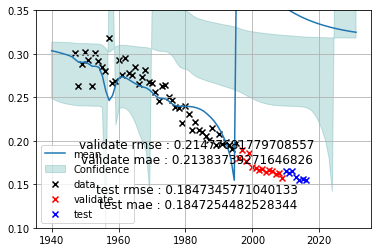

 11%|█         | 143/1296 [15:49<5:02:10, 15.72s/it]

validate rmse : 0.21477681779708557 
 validate mae : 0.21383739271646826 

    test rmse : 0.1847345771040133 
 test mae : 0.1847254482528344
(('sa', 1), ('sal', 2), ('box_cox', 2), ('box_cox', 2))
params:[-9.40266575e-02  1.81144055e+02]


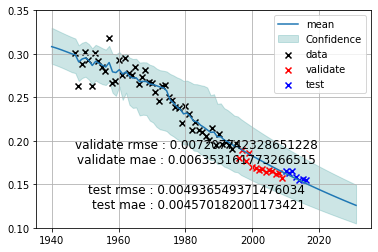

 11%|█         | 144/1296 [15:53<3:54:36, 12.22s/it]

validate rmse : 0.007207742328651228 
 validate mae : 0.006353161773266515 

    test rmse : 0.004936549371476034 
 test mae : 0.004570182001173421
(('sa', 1), ('box_cox', 1), ('sa', 1), ('sa', 1))
params:[-8.77004052e-02  1.71973207e+02]


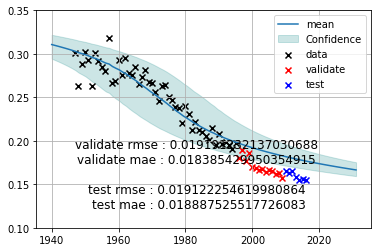

 11%|█         | 145/1296 [15:53<2:47:07,  8.71s/it]

validate rmse : 0.019191232137030688 
 validate mae : 0.018385429950354915 

    test rmse : 0.019122254619980864 
 test mae : 0.018887525517726083
(('sa', 1), ('box_cox', 1), ('sa', 1), ('sa', 2))
params:[-6.89995550e-01  1.36218617e+03]


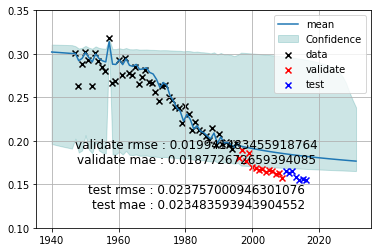

 11%|█▏        | 146/1296 [15:54<2:00:14,  6.27s/it]

validate rmse : 0.019941483455918764 
 validate mae : 0.018772672659394085 

    test rmse : 0.023757000946301076 
 test mae : 0.023483593943904552
(('sa', 1), ('box_cox', 1), ('sa', 1), ('sal', 1))
params:[-1.17296597e-01  2.31212723e+02]


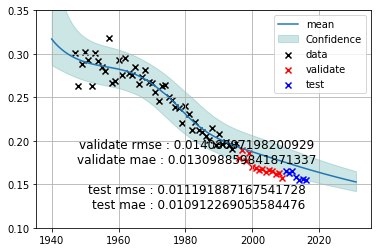

 11%|█▏        | 147/1296 [15:57<1:40:12,  5.23s/it]

validate rmse : 0.01408087198200929 
 validate mae : 0.013098859841871337 

    test rmse : 0.011191887167541728 
 test mae : 0.010912269053584476
(('sa', 1), ('box_cox', 1), ('sa', 1), ('sal', 2))
params:[-1.92019104e+05  3.80976285e+08]


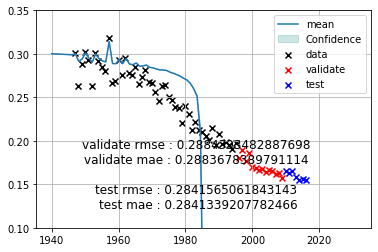

 11%|█▏        | 148/1296 [15:59<1:26:26,  4.52s/it]

validate rmse : 0.2884393482887698 
 validate mae : 0.2883678389791114 

    test rmse : 0.2841565061843143 
 test mae : 0.2841339207782466
(('sa', 1), ('box_cox', 1), ('sa', 1), ('box_cox', 1))
params:[-8.93572758e-02  1.74104458e+02]


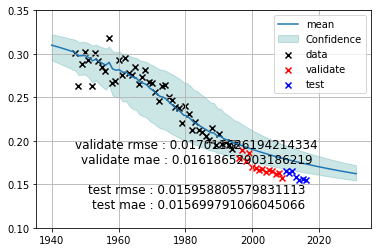

 11%|█▏        | 149/1296 [16:00<1:03:36,  3.33s/it]

validate rmse : 0.017011626194214334 
 validate mae : 0.01618652903186219 

    test rmse : 0.015958805579831113 
 test mae : 0.015699791066045066
(('sa', 1), ('box_cox', 1), ('sa', 1), ('box_cox', 2))
params:[-8.74402926e-02  1.69370947e+02]


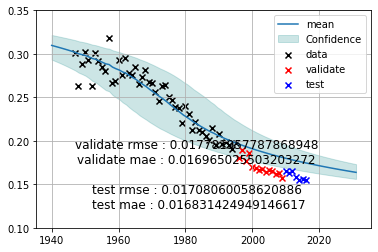

 12%|█▏        | 150/1296 [16:01<47:54,  2.51s/it]  

validate rmse : 0.017781957787868948 
 validate mae : 0.016965025503203272 

    test rmse : 0.01708060058620886 
 test mae : 0.016831424949146617
(('sa', 1), ('box_cox', 1), ('sa', 2), ('sa', 1))
params:[-8.77001068e-02  1.71972607e+02]


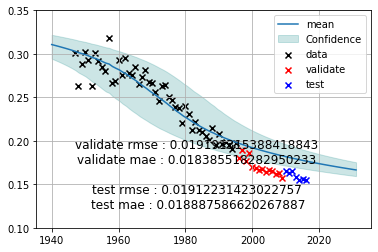

 12%|█▏        | 151/1296 [16:01<36:54,  1.93s/it]

validate rmse : 0.019191315388418843 
 validate mae : 0.018385518282950233 

    test rmse : 0.01912231423022757 
 test mae : 0.018887586620267887
(('sa', 1), ('box_cox', 1), ('sa', 2), ('sa', 2))
params:[-8.77006510e-02  1.71973692e+02]


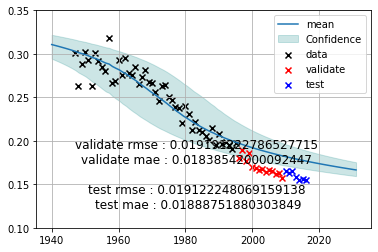

 12%|█▏        | 152/1296 [16:02<29:57,  1.57s/it]

validate rmse : 0.019191222786527715 
 validate mae : 0.01838542000092447 

    test rmse : 0.019122248069159138 
 test mae : 0.01888751880303849
(('sa', 1), ('box_cox', 1), ('sa', 2), ('sal', 1))
params:[-1.17296018e-01  2.31211413e+02]


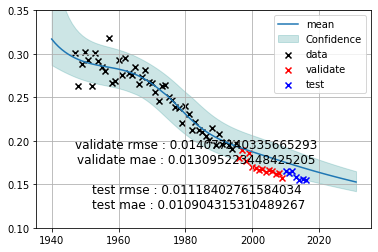

 12%|█▏        | 153/1296 [16:06<43:11,  2.27s/it]

validate rmse : 0.014077140335665293 
 validate mae : 0.013095223448425205 

    test rmse : 0.01118402761584034 
 test mae : 0.010904315310489267
(('sa', 1), ('box_cox', 1), ('sa', 2), ('sal', 2))
params:[-8.62200649e+07  1.69080453e+11]


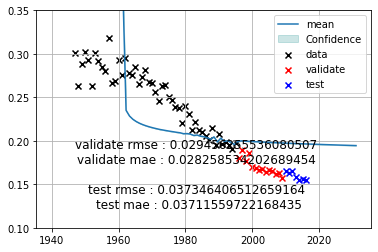

 12%|█▏        | 154/1296 [16:10<55:40,  2.93s/it]

validate rmse : 0.029456255536080507 
 validate mae : 0.028258534202689454 

    test rmse : 0.037346406512659164 
 test mae : 0.03711559722168435
(('sa', 1), ('box_cox', 1), ('sa', 2), ('box_cox', 1))
params:[-8.93572492e-02  1.74104400e+02]


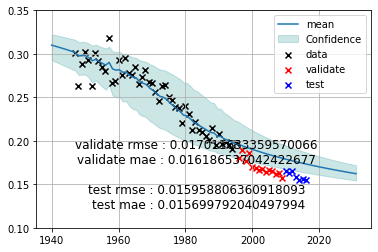

 12%|█▏        | 155/1296 [16:11<42:47,  2.25s/it]

validate rmse : 0.017011633359570066 
 validate mae : 0.016186537042422677 

    test rmse : 0.015958806360918093 
 test mae : 0.015699792040497994
(('sa', 1), ('box_cox', 1), ('sa', 2), ('box_cox', 2))
params:[-8.74403716e-02  1.69371101e+02]


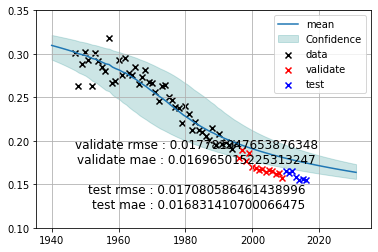

 12%|█▏        | 156/1296 [16:12<33:32,  1.77s/it]

validate rmse : 0.017781947653876348 
 validate mae : 0.016965015225313247 

    test rmse : 0.017080586461438996 
 test mae : 0.016831410700066475
(('sa', 1), ('box_cox', 1), ('sal', 1), ('sa', 1))
params:[-8.79762389e-02  1.72512300e+02]


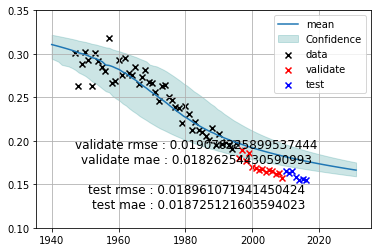

 12%|█▏        | 157/1296 [16:14<34:38,  1.82s/it]

validate rmse : 0.019070325899537444 
 validate mae : 0.01826254430590993 

    test rmse : 0.018961071941450424 
 test mae : 0.018725121603594023
(('sa', 1), ('box_cox', 1), ('sal', 1), ('sa', 2))
params:[-1.16865141e-01  2.30414450e+02]


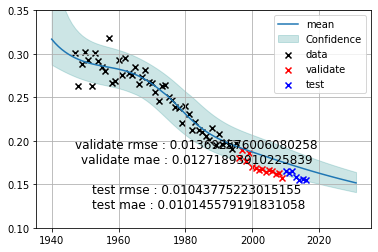

 12%|█▏        | 158/1296 [16:17<43:07,  2.27s/it]

validate rmse : 0.013692576006080258 
 validate mae : 0.01271893910225839 

    test rmse : 0.01043775223015155 
 test mae : 0.010145579191831058
(('sa', 1), ('box_cox', 1), ('sal', 1), ('sal', 1))
params:[-1.16513072e-01  2.29515443e+02]


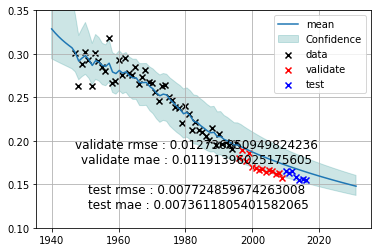

 12%|█▏        | 159/1296 [16:20<47:21,  2.50s/it]

validate rmse : 0.012736850949824236 
 validate mae : 0.01191396025175605 

    test rmse : 0.007724859674263008 
 test mae : 0.0073611805401582065
(('sa', 1), ('box_cox', 1), ('sal', 1), ('sal', 2))
params:[-1.17322343e-01  2.31098920e+02]


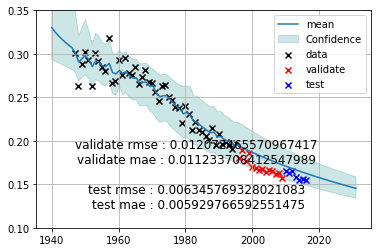

 12%|█▏        | 160/1296 [16:35<1:57:02,  6.18s/it]

validate rmse : 0.012072465570967417 
 validate mae : 0.011233708412547989 

    test rmse : 0.006345769328021083 
 test mae : 0.005929766592551475
(('sa', 1), ('box_cox', 1), ('sal', 1), ('box_cox', 1))
params:[-1.14674427e-01  2.25153061e+02]


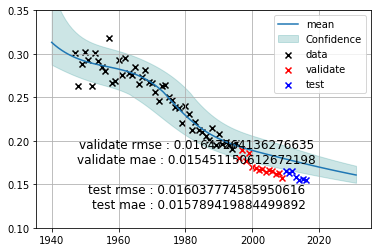

 12%|█▏        | 161/1296 [16:38<1:40:06,  5.29s/it]

validate rmse : 0.01647264136276635 
 validate mae : 0.015451150612672198 

    test rmse : 0.016037774585950616 
 test mae : 0.015789419884499892
(('sa', 1), ('box_cox', 1), ('sal', 1), ('box_cox', 2))
params:[-1.1504115e-01  2.2481911e+02]


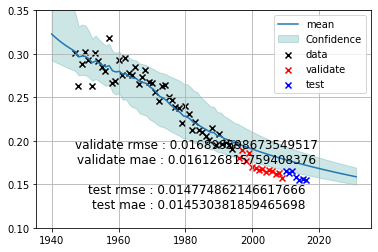

 12%|█▎        | 162/1296 [16:41<1:27:54,  4.65s/it]

validate rmse : 0.016899598673549517 
 validate mae : 0.016126815759408376 

    test rmse : 0.014774862146617666 
 test mae : 0.014530381859465698
(('sa', 1), ('box_cox', 1), ('sal', 2), ('sa', 1))
params:[-8.21131888e-02  1.60692847e+02]


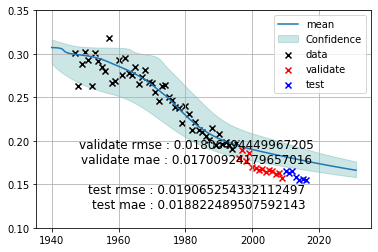

 13%|█▎        | 163/1296 [16:45<1:22:34,  4.37s/it]

validate rmse : 0.01806494449967205 
 validate mae : 0.01700924179657016 

    test rmse : 0.019065254332112497 
 test mae : 0.018822489507592143
(('sa', 1), ('box_cox', 1), ('sal', 2), ('sa', 2))
params:[-1.17350978e-01  2.31297336e+02]


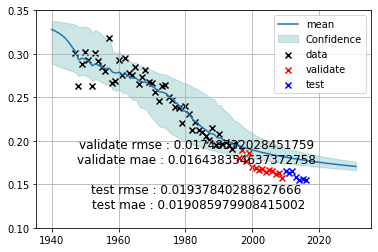

 13%|█▎        | 164/1296 [16:51<1:34:10,  4.99s/it]

validate rmse : 0.01748332028451759 
 validate mae : 0.016438354637372758 

    test rmse : 0.01937840288627666 
 test mae : 0.019085979908415002
(('sa', 1), ('box_cox', 1), ('sal', 2), ('sal', 1))
params:[-1.15291994e-01  2.27289968e+02]


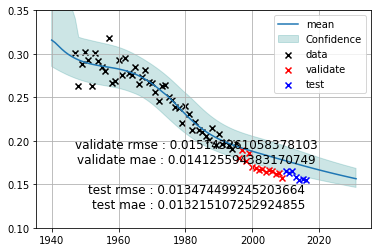

 13%|█▎        | 165/1296 [16:54<1:24:34,  4.49s/it]

validate rmse : 0.015143261058378103 
 validate mae : 0.014125594383170749 

    test rmse : 0.013474499245203664 
 test mae : 0.013215107252924855
(('sa', 1), ('box_cox', 1), ('sal', 2), ('sal', 2))
params:[-1.17985689e-01  2.32556997e+02]


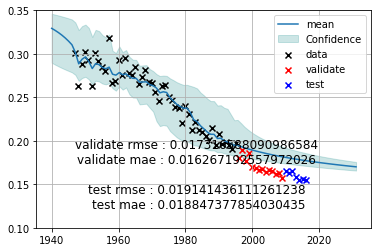

 13%|█▎        | 166/1296 [17:16<2:58:03,  9.45s/it]

validate rmse : 0.017316588090986584 
 validate mae : 0.016267192557972026 

    test rmse : 0.019141436111261238 
 test mae : 0.018847377854030435
(('sa', 1), ('box_cox', 1), ('sal', 2), ('box_cox', 1))
params:[-1.18721653e-01  2.33160177e+02]


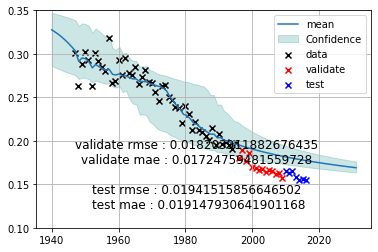

 13%|█▎        | 167/1296 [17:24<2:53:29,  9.22s/it]

validate rmse : 0.018203911882676435 
 validate mae : 0.01724759481559728 

    test rmse : 0.01941515856646502 
 test mae : 0.019147930641901168
(('sa', 1), ('box_cox', 1), ('sal', 2), ('box_cox', 2))
params:[-1.20837333e-01  2.36421810e+02]


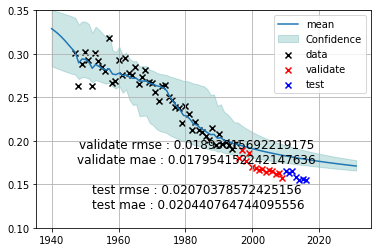

 13%|█▎        | 168/1296 [17:35<3:01:55,  9.68s/it]

validate rmse : 0.01893015692219175 
 validate mae : 0.017954152242147636 

    test rmse : 0.02070378572425156 
 test mae : 0.020440764744095556
(('sa', 1), ('box_cox', 1), ('box_cox', 1), ('sa', 1))
params:[-8.04086060e-02  1.56938197e+02]


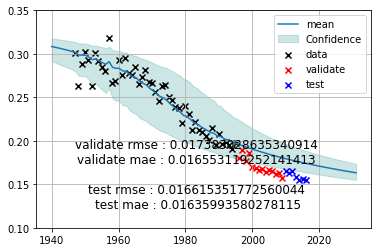

 13%|█▎        | 169/1296 [17:36<2:10:26,  6.94s/it]

validate rmse : 0.017383028635340914 
 validate mae : 0.016553119252141413 

    test rmse : 0.016615351772560044 
 test mae : 0.01635993580278115
(('sa', 1), ('box_cox', 1), ('box_cox', 1), ('sa', 2))
params:[-8.04086081e-02  1.56938196e+02]


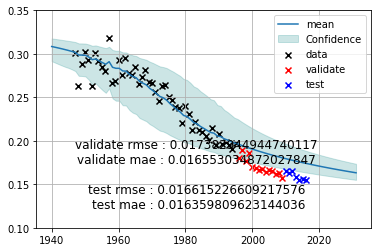

 13%|█▎        | 170/1296 [17:36<1:34:25,  5.03s/it]

validate rmse : 0.017382944944740117 
 validate mae : 0.016553034872027847 

    test rmse : 0.016615226609217576 
 test mae : 0.016359809623144036
(('sa', 1), ('box_cox', 1), ('box_cox', 1), ('sal', 1))
params:[-1.13024450e-01  2.22870126e+02]


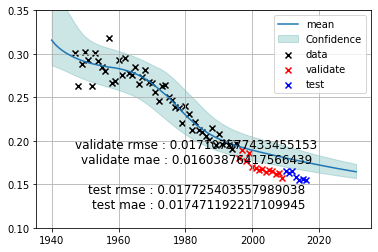

 13%|█▎        | 171/1296 [17:37<1:10:59,  3.79s/it]

validate rmse : 0.017107577433455153 
 validate mae : 0.01603876417566439 

    test rmse : 0.017725403557989038 
 test mae : 0.017471192217109945
(('sa', 1), ('box_cox', 1), ('box_cox', 1), ('sal', 2))
params:[-2.10926792e-01  4.16081128e+02]


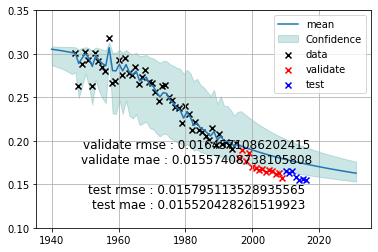

 13%|█▎        | 172/1296 [17:39<1:02:11,  3.32s/it]

validate rmse : 0.0164571086202415 
 validate mae : 0.01557408738105808 

    test rmse : 0.015795113528935565 
 test mae : 0.015520428261519923
(('sa', 1), ('box_cox', 1), ('box_cox', 1), ('box_cox', 1))
params:[-8.91450969e-02  1.72231909e+02]


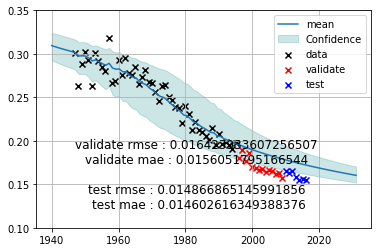

 13%|█▎        | 173/1296 [17:40<46:29,  2.48s/it]  

validate rmse : 0.016423933607256507 
 validate mae : 0.0156051795166544 

    test rmse : 0.014866865145991856 
 test mae : 0.014602616349388376
(('sa', 1), ('box_cox', 1), ('box_cox', 1), ('box_cox', 2))
params:[-7.56513484e-02  1.44605167e+02]


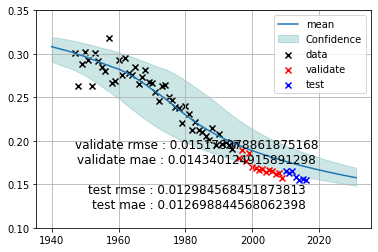

 13%|█▎        | 174/1296 [17:40<35:45,  1.91s/it]

validate rmse : 0.015178978861875168 
 validate mae : 0.014340124915891298 

    test rmse : 0.012984568451873813 
 test mae : 0.012698844568062398
(('sa', 1), ('box_cox', 1), ('box_cox', 2), ('sa', 1))
params:[-7.43967044e-02  1.44895840e+02]


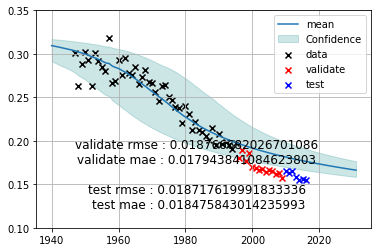

 14%|█▎        | 175/1296 [17:41<28:50,  1.54s/it]

validate rmse : 0.018766682026701086 
 validate mae : 0.017943841084623803 

    test rmse : 0.018717619991833336 
 test mae : 0.018475843014235993
(('sa', 1), ('box_cox', 1), ('box_cox', 2), ('sa', 2))
params:[-7.43963595e-02  1.44895156e+02]


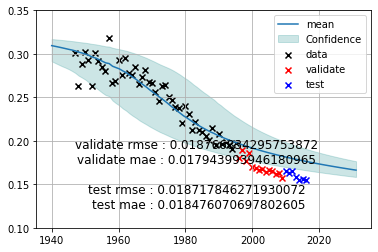

 14%|█▎        | 176/1296 [17:42<24:07,  1.29s/it]

validate rmse : 0.018766834295753872 
 validate mae : 0.017943993946180965 

    test rmse : 0.018717846271930072 
 test mae : 0.018476070697802605
(('sa', 1), ('box_cox', 1), ('box_cox', 2), ('sal', 1))
params:[-1.08613166e-01  2.14282177e+02]


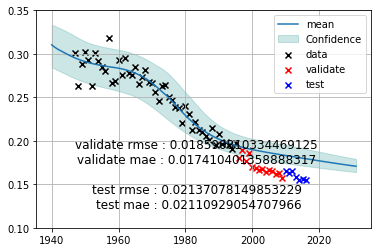

 14%|█▎        | 177/1296 [17:43<22:01,  1.18s/it]

validate rmse : 0.018590810334469125 
 validate mae : 0.017410401358888317 

    test rmse : 0.02137078149853229 
 test mae : 0.02110929054707966
(('sa', 1), ('box_cox', 1), ('box_cox', 2), ('sal', 2))
params:[-1.18178542e-01  2.32927476e+02]


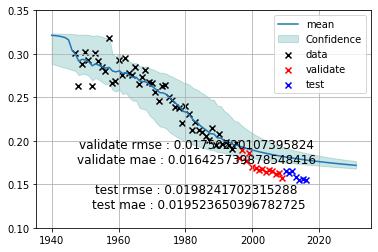

 14%|█▎        | 178/1296 [17:55<1:22:49,  4.44s/it]

validate rmse : 0.01750220107395824 
 validate mae : 0.016425739878548416 

    test rmse : 0.0198241702315288 
 test mae : 0.019523650396782725
(('sa', 1), ('box_cox', 1), ('box_cox', 2), ('box_cox', 1))
params:[-7.34444052e-02  1.40248975e+02]


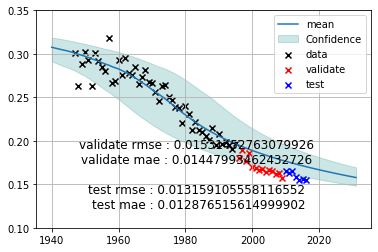

 14%|█▍        | 179/1296 [17:55<1:01:22,  3.30s/it]

validate rmse : 0.01531452763079926 
 validate mae : 0.01447993462432726 

    test rmse : 0.013159105558116552 
 test mae : 0.012876515614999902
(('sa', 1), ('box_cox', 1), ('box_cox', 2), ('box_cox', 2))
params:[-5.88498167e-02  1.10626986e+02]


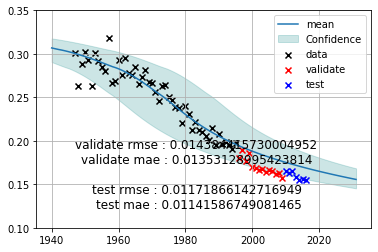

 14%|█▍        | 180/1296 [17:56<46:31,  2.50s/it]  

validate rmse : 0.014384415730004952 
 validate mae : 0.01353128995423814 

    test rmse : 0.01171866142716949 
 test mae : 0.01141586749081465
(('sa', 1), ('box_cox', 2), ('sa', 1), ('sa', 1))
params:[-7.75550435e-02  1.51300895e+02]


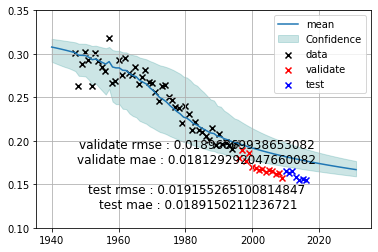

 14%|█▍        | 181/1296 [17:57<36:13,  1.95s/it]

validate rmse : 0.01896869938653082 
 validate mae : 0.018129292047660082 

    test rmse : 0.019155265100814847 
 test mae : 0.0189150211236721
(('sa', 1), ('box_cox', 2), ('sa', 1), ('sa', 2))
params:[-7.75551405e-02  1.51301104e+02]


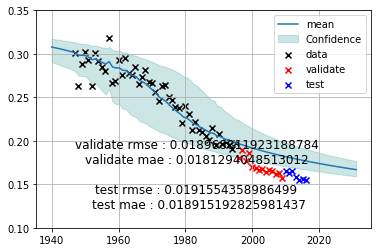

 14%|█▍        | 182/1296 [17:57<29:11,  1.57s/it]

validate rmse : 0.018968811923188784 
 validate mae : 0.0181294048513012 

    test rmse : 0.0191554358986499 
 test mae : 0.018915192825981437
(('sa', 1), ('box_cox', 2), ('sa', 1), ('sal', 1))
params:[-1.09344985e-01  2.15647623e+02]


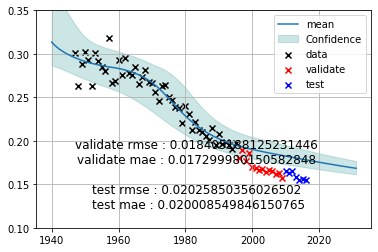

 14%|█▍        | 183/1296 [17:58<25:39,  1.38s/it]

validate rmse : 0.018405188125231446 
 validate mae : 0.017299980150582848 

    test rmse : 0.02025850356026502 
 test mae : 0.020008549846150765
(('sa', 1), ('box_cox', 2), ('sa', 1), ('sal', 2))
params:[-1.18144830e-01  2.32875709e+02]


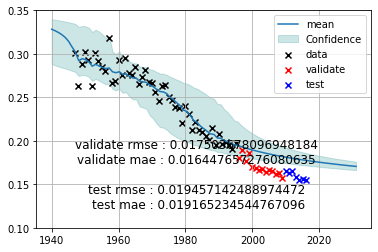

 14%|█▍        | 184/1296 [18:04<49:41,  2.68s/it]

validate rmse : 0.017503678096948184 
 validate mae : 0.016447657276080635 

    test rmse : 0.019457142488974472 
 test mae : 0.019165234544767096
(('sa', 1), ('box_cox', 2), ('sa', 1), ('box_cox', 1))
params:[-7.93498335e-02  1.53923845e+02]


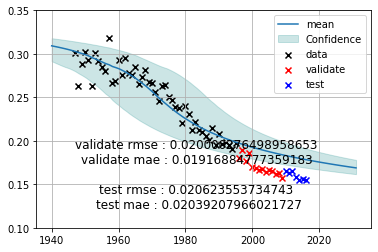

 14%|█▍        | 185/1296 [18:05<37:54,  2.05s/it]

validate rmse : 0.020000276498958653 
 validate mae : 0.01916884777359183 

    test rmse : 0.020623553734743 
 test mae : 0.02039207966021727
(('sa', 1), ('box_cox', 2), ('sa', 1), ('box_cox', 2))
params:[-7.92973385e-02  1.52793597e+02]


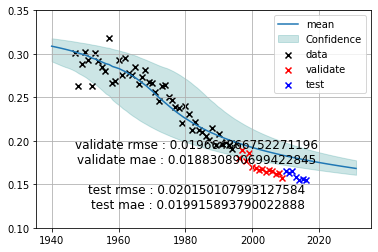

 14%|█▍        | 186/1296 [18:05<30:15,  1.64s/it]

validate rmse : 0.019664866752271196 
 validate mae : 0.018830890699422845 

    test rmse : 0.020150107993127584 
 test mae : 0.019915893790022888
(('sa', 1), ('box_cox', 2), ('sa', 2), ('sa', 1))
params:[-7.75550556e-02  1.51300924e+02]


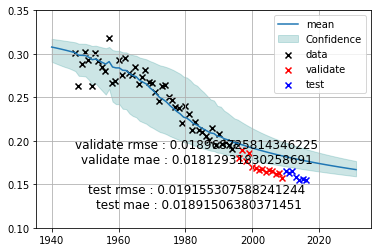

 14%|█▍        | 187/1296 [18:06<25:25,  1.38s/it]

validate rmse : 0.018968725814346225 
 validate mae : 0.01812931830258691 

    test rmse : 0.019155307588241244 
 test mae : 0.01891506380371451
(('sa', 1), ('box_cox', 2), ('sa', 2), ('sa', 2))
params:[-7.75550609e-02  1.51300938e+02]


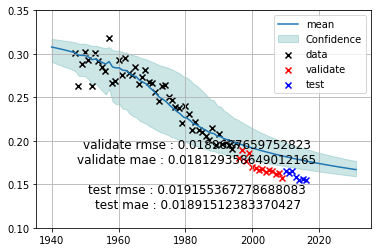

 15%|█▍        | 188/1296 [18:07<22:22,  1.21s/it]

validate rmse : 0.0189687659752823 
 validate mae : 0.018129358649012165 

    test rmse : 0.019155367278688083 
 test mae : 0.01891512383370427
(('sa', 1), ('box_cox', 2), ('sa', 2), ('sal', 1))
params:[-1.09345883e-01  2.15649407e+02]


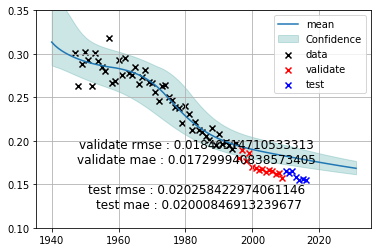

 15%|█▍        | 189/1296 [18:08<21:20,  1.16s/it]

validate rmse : 0.01840514710533313 
 validate mae : 0.017299940838573405 

    test rmse : 0.020258422974061146 
 test mae : 0.02000846913239677
(('sa', 1), ('box_cox', 2), ('sa', 2), ('sal', 2))
params:[-1.18146342e-01  2.32878263e+02]


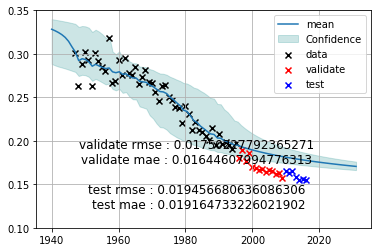

 15%|█▍        | 190/1296 [18:13<42:20,  2.30s/it]

validate rmse : 0.01750227792365271 
 validate mae : 0.01644607994776313 

    test rmse : 0.019456680636086306 
 test mae : 0.019164733226021902
(('sa', 1), ('box_cox', 2), ('sa', 2), ('box_cox', 1))
params:[-7.93496460e-02  1.53923484e+02]


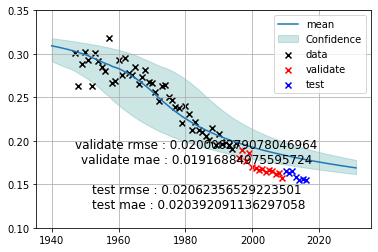

 15%|█▍        | 191/1296 [18:13<33:22,  1.81s/it]

validate rmse : 0.020000279078046964 
 validate mae : 0.01916884975595724 

    test rmse : 0.02062356529223501 
 test mae : 0.020392091136297058
(('sa', 1), ('box_cox', 2), ('sa', 2), ('box_cox', 2))
params:[-7.92973639e-02  1.52793652e+02]


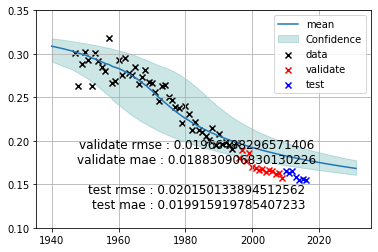

 15%|█▍        | 192/1296 [18:14<26:57,  1.47s/it]

validate rmse : 0.01966488296571406 
 validate mae : 0.018830906830130226 

    test rmse : 0.020150133894512562 
 test mae : 0.019915919785407233
(('sa', 1), ('box_cox', 2), ('sal', 1), ('sa', 1))
params:[-1.07512700e-01  2.12122808e+02]


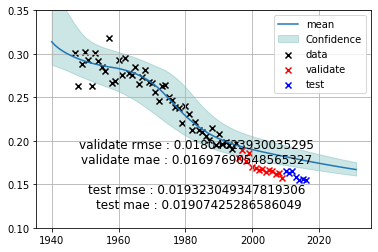

 15%|█▍        | 193/1296 [18:15<25:32,  1.39s/it]

validate rmse : 0.01804623930035295 
 validate mae : 0.01697690548565327 

    test rmse : 0.019323049347819306 
 test mae : 0.01907425286586049
(('sa', 1), ('box_cox', 2), ('sal', 1), ('sa', 2))
params:[-1.07512248e-01  2.12121924e+02]


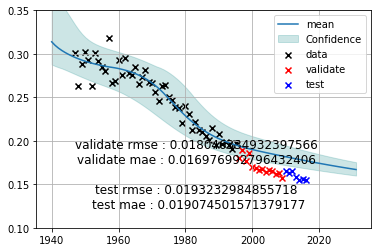

 15%|█▍        | 194/1296 [18:16<23:46,  1.29s/it]

validate rmse : 0.018046334932397566 
 validate mae : 0.016976992796432406 

    test rmse : 0.0193232984855718 
 test mae : 0.019074501571379177
(('sa', 1), ('box_cox', 2), ('sal', 1), ('sal', 1))
params:[-1.16039006e-01  2.28624291e+02]


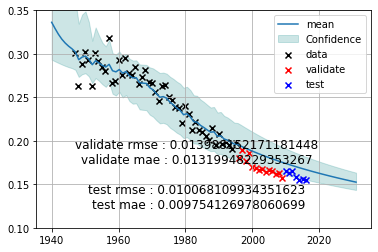

 15%|█▌        | 195/1296 [18:17<21:47,  1.19s/it]

validate rmse : 0.013988152171181448 
 validate mae : 0.01319948229353267 

    test rmse : 0.010068109934351623 
 test mae : 0.009754126978060699
(('sa', 1), ('box_cox', 2), ('sal', 1), ('sal', 2))
params:[-4.4588781e+00  8.7639363e+03]


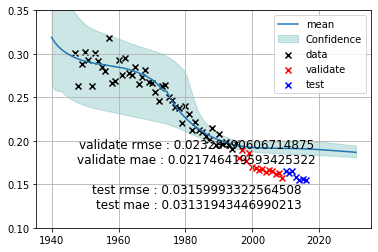

 15%|█▌        | 196/1296 [18:19<26:40,  1.45s/it]

validate rmse : 0.02328490606714875 
 validate mae : 0.021746419593425322 

    test rmse : 0.03159993322564508 
 test mae : 0.03131943446990213
(('sa', 1), ('box_cox', 2), ('sal', 1), ('box_cox', 1))
params:[-1.10111612e-01  2.16138254e+02]


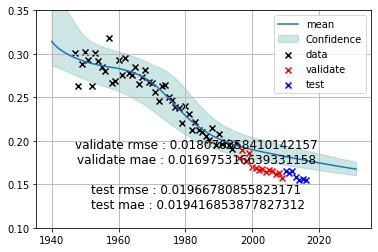

 15%|█▌        | 197/1296 [18:21<26:44,  1.46s/it]

validate rmse : 0.018076358410142157 
 validate mae : 0.016975316639331158 

    test rmse : 0.01966780855823171 
 test mae : 0.019416853877827312
(('sa', 1), ('box_cox', 2), ('sal', 1), ('box_cox', 2))
params:[-1.09604968e-01  2.14049005e+02]


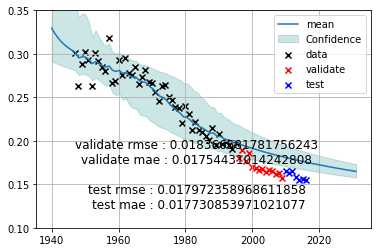

 15%|█▌        | 198/1296 [18:22<23:02,  1.26s/it]

validate rmse : 0.018366581781756243 
 validate mae : 0.01754431014242808 

    test rmse : 0.017972358968611858 
 test mae : 0.017730853971021077
(('sa', 1), ('box_cox', 2), ('sal', 2), ('sa', 1))
params:[-7.91664029e-02  1.54368066e+02]


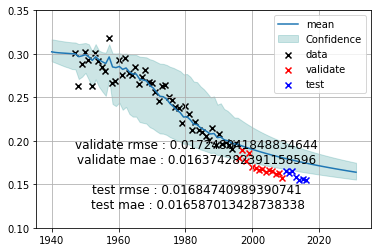

 15%|█▌        | 199/1296 [18:24<29:49,  1.63s/it]

validate rmse : 0.017248041848834644 
 validate mae : 0.016374282391158596 

    test rmse : 0.01684740989390741 
 test mae : 0.016587013428738338
(('sa', 1), ('box_cox', 2), ('sal', 2), ('sa', 2))
params:[-7.35294305e-02  1.43053320e+02]


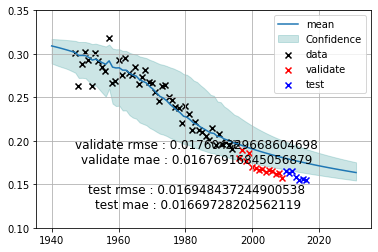

 15%|█▌        | 200/1296 [18:26<31:56,  1.75s/it]

validate rmse : 0.017604329668604698 
 validate mae : 0.01676916845056879 

    test rmse : 0.016948437244900538 
 test mae : 0.01669728202562119
(('sa', 1), ('box_cox', 2), ('sal', 2), ('sal', 1))
params:[-1.18702086e-01  2.33976916e+02]


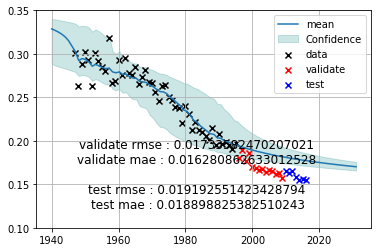

 16%|█▌        | 201/1296 [18:32<54:47,  3.00s/it]

validate rmse : 0.01733582470207021 
 validate mae : 0.016280862633012528 

    test rmse : 0.019192551423428794 
 test mae : 0.018898825382510243
(('sa', 1), ('box_cox', 2), ('sal', 2), ('sal', 2))
params:[-2.01618939e+10  4.00269241e+13]


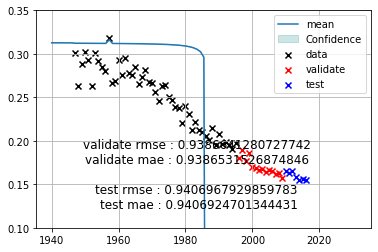

 16%|█▌        | 202/1296 [18:35<54:51,  3.01s/it]

validate rmse : 0.9386641280727742 
 validate mae : 0.9386531526874846 

    test rmse : 0.9406967929859783 
 test mae : 0.9406924701344431
(('sa', 1), ('box_cox', 2), ('sal', 2), ('box_cox', 1))
params:[-1.16032829e-01  2.27840039e+02]


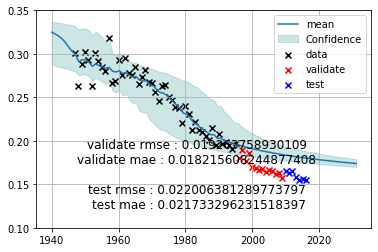

 16%|█▌        | 203/1296 [18:43<1:22:20,  4.52s/it]

validate rmse : 0.019263758930109 
 validate mae : 0.018215608244877408 

    test rmse : 0.022006381289773797 
 test mae : 0.021733296231518397
(('sa', 1), ('box_cox', 2), ('sal', 2), ('box_cox', 2))
params:[-1.15974582e-01  2.26727360e+02]


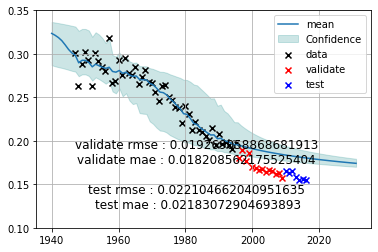

 16%|█▌        | 204/1296 [18:52<1:47:37,  5.91s/it]

validate rmse : 0.019269058868681913 
 validate mae : 0.018208562175525404 

    test rmse : 0.022104662040951635 
 test mae : 0.02183072904693893
(('sa', 1), ('box_cox', 2), ('box_cox', 1), ('sa', 1))
params:[-7.17833106e-02  1.39682763e+02]


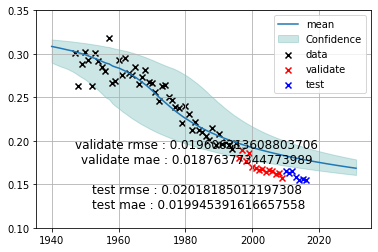

 16%|█▌        | 205/1296 [18:53<1:18:46,  4.33s/it]

validate rmse : 0.019606313608803706 
 validate mae : 0.01876377344773989 

    test rmse : 0.02018185012197308 
 test mae : 0.019945391616657558
(('sa', 1), ('box_cox', 2), ('box_cox', 1), ('sa', 2))
params:[-7.17833381e-02  1.39682812e+02]


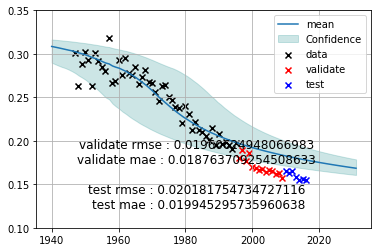

 16%|█▌        | 206/1296 [18:54<58:54,  3.24s/it]  

validate rmse : 0.01960624948066983 
 validate mae : 0.018763709254508633 

    test rmse : 0.020181754734727116 
 test mae : 0.019945295735960638
(('sa', 1), ('box_cox', 2), ('box_cox', 1), ('sal', 1))
params:[-1.05535731e-01  2.08257540e+02]


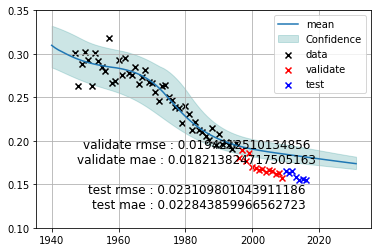

 16%|█▌        | 207/1296 [18:55<45:54,  2.53s/it]

validate rmse : 0.0194212510134856 
 validate mae : 0.018213824717505163 

    test rmse : 0.023109801043911186 
 test mae : 0.022843859966562723
(('sa', 1), ('box_cox', 2), ('box_cox', 1), ('sal', 2))
params:[-147634.6832776    -2205.73777721]


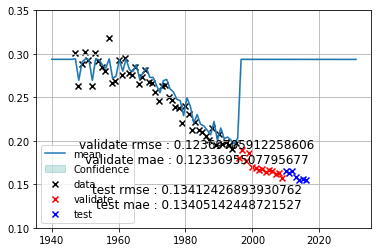

 16%|█▌        | 208/1296 [19:03<1:19:18,  4.37s/it]

validate rmse : 0.12369705912258606 
 validate mae : 0.1233695507795677 

    test rmse : 0.13412426893930762 
 test mae : 0.13405142448721527
(('sa', 1), ('box_cox', 2), ('box_cox', 1), ('box_cox', 1))
params:[-7.40155119e-02  1.41430621e+02]


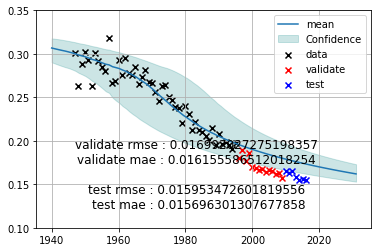

 16%|█▌        | 209/1296 [19:04<58:26,  3.23s/it]  

validate rmse : 0.016992027275198357 
 validate mae : 0.016155586512018254 

    test rmse : 0.015953472601819556 
 test mae : 0.015696301307677858
(('sa', 1), ('box_cox', 2), ('box_cox', 1), ('box_cox', 2))
params:[-5.95215393e-02  1.11993609e+02]


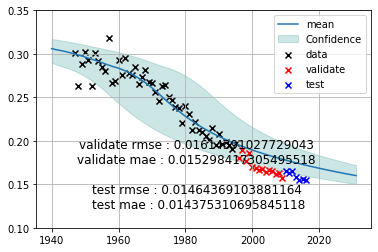

 16%|█▌        | 210/1296 [19:04<43:57,  2.43s/it]

validate rmse : 0.01614391027729043 
 validate mae : 0.015298417305495518 

    test rmse : 0.01464369103881164 
 test mae : 0.014375310695845118
(('sa', 1), ('box_cox', 2), ('box_cox', 2), ('sa', 1))
params:[-7.03754064e-02  1.36960582e+02]


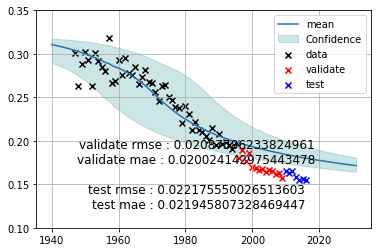

 16%|█▋        | 211/1296 [19:05<34:09,  1.89s/it]

validate rmse : 0.02087386233824961 
 validate mae : 0.020024142975443478 

    test rmse : 0.022175550026513603 
 test mae : 0.021945807328469447
(('sa', 1), ('box_cox', 2), ('box_cox', 2), ('sa', 2))
params:[-7.03791735e-02  1.36968229e+02]


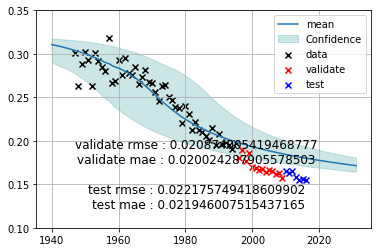

 16%|█▋        | 212/1296 [19:06<28:35,  1.58s/it]

validate rmse : 0.020874005419468777 
 validate mae : 0.020024287905578503 

    test rmse : 0.022175749418609902 
 test mae : 0.021946007515437165
(('sa', 1), ('box_cox', 2), ('box_cox', 2), ('sal', 1))
params:[-1.03297361e-01  2.03856033e+02]


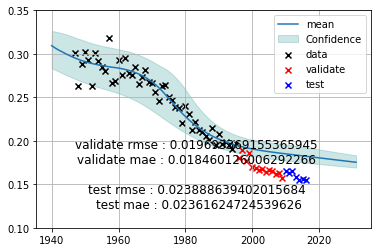

 16%|█▋        | 213/1296 [19:07<28:12,  1.56s/it]

validate rmse : 0.019693369155365945 
 validate mae : 0.018460126006292266 

    test rmse : 0.023888639402015684 
 test mae : 0.02361624724539626
(('sa', 1), ('box_cox', 2), ('box_cox', 2), ('sal', 2))
params:[-1.67016761e+05  3.27433800e+08]


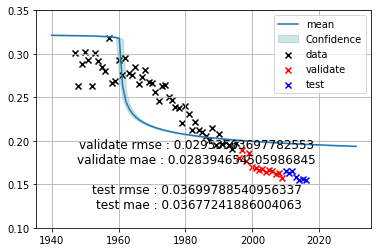

 17%|█▋        | 214/1296 [19:11<37:01,  2.05s/it]

validate rmse : 0.02953563697782553 
 validate mae : 0.028394654505986845 

    test rmse : 0.03699788540956337 
 test mae : 0.03677241886004063
(('sa', 1), ('box_cox', 2), ('box_cox', 2), ('box_cox', 1))
params:[-5.80693190e-02  1.09123468e+02]


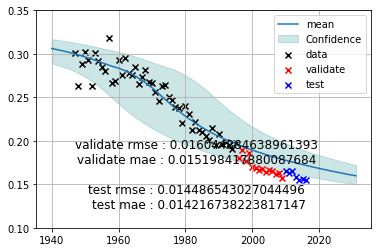

 17%|█▋        | 215/1296 [19:11<29:01,  1.61s/it]

validate rmse : 0.016044884638961393 
 validate mae : 0.015198417880087684 

    test rmse : 0.014486543027044496 
 test mae : 0.014216738223817147
(('sa', 1), ('box_cox', 2), ('box_cox', 2), ('box_cox', 2))
params:[-4.39509247e-02  8.06271407e+01]


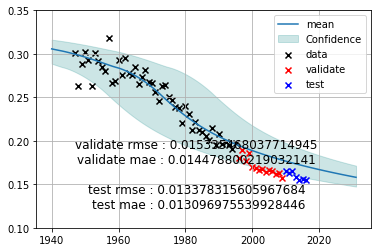

 17%|█▋        | 216/1296 [19:12<23:58,  1.33s/it]

validate rmse : 0.015335468037714945 
 validate mae : 0.014478800219032141 

    test rmse : 0.013378315605967684 
 test mae : 0.013096975539928446
(('sa', 2), ('sa', 1), ('sa', 1), ('sa', 1))
params:[-9.23416890e-02  1.81848268e+02]


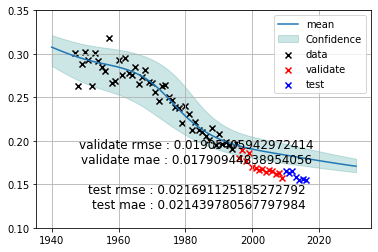

 17%|█▋        | 217/1296 [19:13<20:34,  1.14s/it]

validate rmse : 0.01905405942972414 
 validate mae : 0.01790944838954056 

    test rmse : 0.021691125185272792 
 test mae : 0.021439780567797984
(('sa', 2), ('sa', 1), ('sa', 1), ('sa', 2))
params:[-9.23416922e-02  1.81848274e+02]


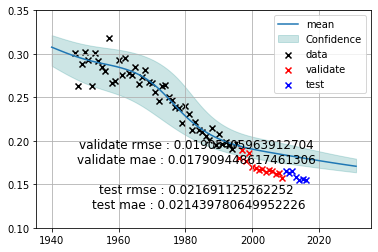

 17%|█▋        | 218/1296 [19:13<18:49,  1.05s/it]

validate rmse : 0.01905405963912704 
 validate mae : 0.017909448617461306 

    test rmse : 0.021691125262252 
 test mae : 0.021439780649952226
(('sa', 2), ('sa', 1), ('sa', 1), ('sal', 1))
params:[-1.18457476e-01  2.33447994e+02]


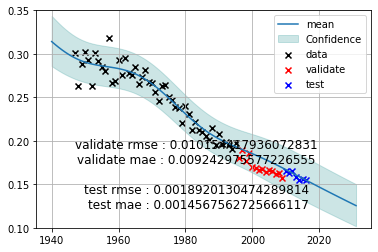

 17%|█▋        | 219/1296 [19:15<22:31,  1.25s/it]

validate rmse : 0.010154417936072831 
 validate mae : 0.009242975577226555 

    test rmse : 0.0018920130474289814 
 test mae : 0.0014567562725666117
(('sa', 2), ('sa', 1), ('sa', 1), ('sal', 2))
params:[-1.19402827e-01  2.35323143e+02]


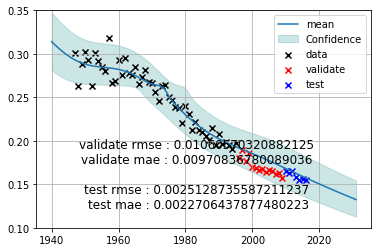

 17%|█▋        | 220/1296 [19:20<44:03,  2.46s/it]

validate rmse : 0.01060570320882125 
 validate mae : 0.00970836780089036 

    test rmse : 0.0025128735587211237 
 test mae : 0.0022706437877480223
(('sa', 2), ('sa', 1), ('sa', 1), ('box_cox', 1))
params:[-9.51593832e-02  1.86341542e+02]


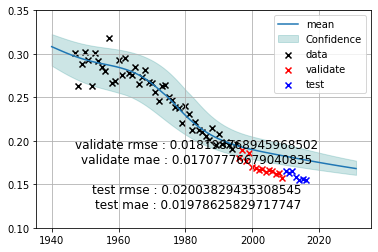

 17%|█▋        | 221/1296 [19:21<34:03,  1.90s/it]

validate rmse : 0.018198768945968502 
 validate mae : 0.01707776679040835 

    test rmse : 0.02003829435308545 
 test mae : 0.01978625829717747
(('sa', 2), ('sa', 1), ('sa', 1), ('box_cox', 2))
params:[-9.15346192e-02  1.78094172e+02]


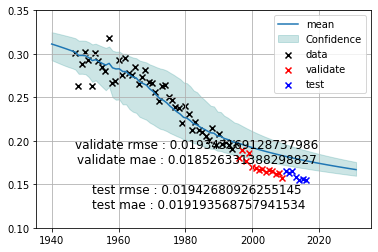

 17%|█▋        | 222/1296 [19:22<27:35,  1.54s/it]

validate rmse : 0.019343169128737986 
 validate mae : 0.018526331388298827 

    test rmse : 0.01942680926255145 
 test mae : 0.019193568757941534
(('sa', 2), ('sa', 1), ('sa', 2), ('sa', 1))
params:[-9.23420100e-02  1.81848898e+02]


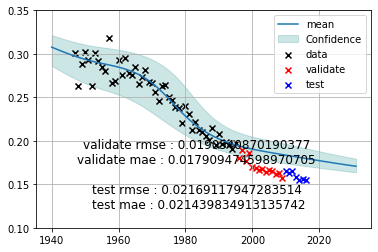

 17%|█▋        | 223/1296 [19:23<23:50,  1.33s/it]

validate rmse : 0.0190540870190377 
 validate mae : 0.017909474598970705 

    test rmse : 0.02169117947283514 
 test mae : 0.021439834913135742
(('sa', 2), ('sa', 1), ('sa', 2), ('sa', 2))
params:[-9.23416928e-02  1.81848276e+02]


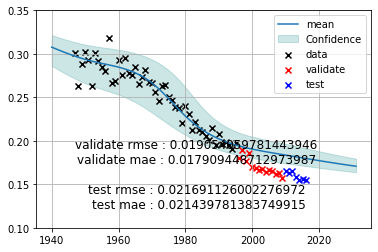

 17%|█▋        | 224/1296 [19:23<20:43,  1.16s/it]

validate rmse : 0.019054059781443946 
 validate mae : 0.017909448712973987 

    test rmse : 0.021691126002276972 
 test mae : 0.021439781383749915
(('sa', 2), ('sa', 1), ('sa', 2), ('sal', 1))
params:[-1.17351044e-01  2.31174894e+02]


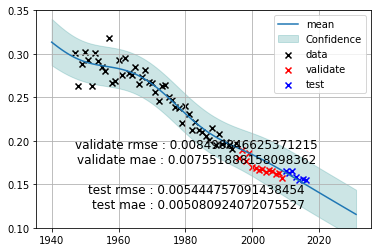

 17%|█▋        | 225/1296 [19:25<26:20,  1.48s/it]

validate rmse : 0.008490846625371215 
 validate mae : 0.007551888158098362 

    test rmse : 0.005444757091438454 
 test mae : 0.005080924072075527
(('sa', 2), ('sa', 1), ('sa', 2), ('sal', 2))
params:[-1.82476142e+05  3.57850018e+08]


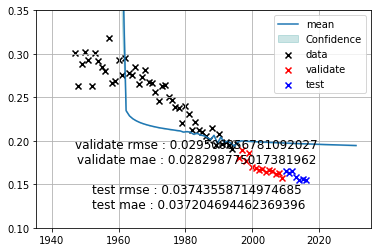

 17%|█▋        | 226/1296 [19:28<32:09,  1.80s/it]

validate rmse : 0.029500856781092027 
 validate mae : 0.028298775017381962 

    test rmse : 0.03743558714974685 
 test mae : 0.037204694462369396
(('sa', 2), ('sa', 1), ('sa', 2), ('box_cox', 1))
params:[-9.51593480e-02  1.86341474e+02]


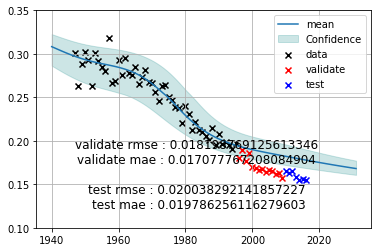

 18%|█▊        | 227/1296 [19:29<26:39,  1.50s/it]

validate rmse : 0.018198769125613346 
 validate mae : 0.017077767208084904 

    test rmse : 0.020038292141857227 
 test mae : 0.019786256116279603
(('sa', 2), ('sa', 1), ('sa', 2), ('box_cox', 2))
params:[-9.15345909e-02  1.78094117e+02]


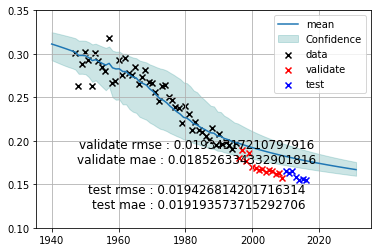

 18%|█▊        | 228/1296 [19:30<23:29,  1.32s/it]

validate rmse : 0.01934317210797916 
 validate mae : 0.018526334332901816 

    test rmse : 0.019426814201716314 
 test mae : 0.019193573715292706
(('sa', 2), ('sa', 1), ('sal', 1), ('sa', 1))
params:[-1.17942719e-01  2.32500413e+02]


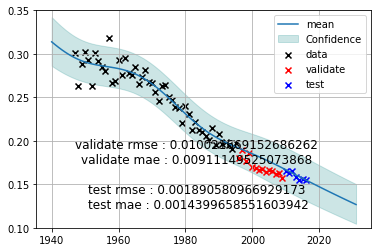

 18%|█▊        | 229/1296 [19:31<23:25,  1.32s/it]

validate rmse : 0.010021669152686262 
 validate mae : 0.00911149525073868 

    test rmse : 0.001890580966929173 
 test mae : 0.0014399658551603942
(('sa', 2), ('sa', 1), ('sal', 1), ('sa', 2))
params:[-1.18475194e-01  2.33570517e+02]


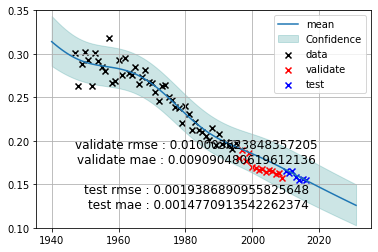

 18%|█▊        | 230/1296 [19:33<29:12,  1.64s/it]

validate rmse : 0.010003623848357205 
 validate mae : 0.009090480619612136 

    test rmse : 0.0019386890955825648 
 test mae : 0.0014770913542262374
(('sa', 2), ('sa', 1), ('sal', 1), ('sal', 1))
params:[-1.15373248e-01  2.27200880e+02]


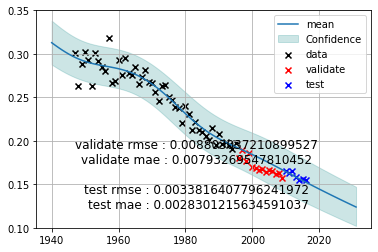

 18%|█▊        | 231/1296 [19:35<28:31,  1.61s/it]

validate rmse : 0.008803037210899527 
 validate mae : 0.00793269547810452 

    test rmse : 0.0033816407796241972 
 test mae : 0.0028301215634591037
(('sa', 2), ('sa', 1), ('sal', 1), ('sal', 2))
params:[-1.30698472e-01  2.57627417e+02]


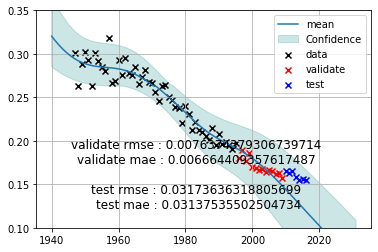

 18%|█▊        | 232/1296 [19:47<1:23:10,  4.69s/it]

validate rmse : 0.0076374379306739714 
 validate mae : 0.006664409357617487 

    test rmse : 0.03173636318805699 
 test mae : 0.03137535502504734
(('sa', 2), ('sa', 1), ('sal', 1), ('box_cox', 1))
params:[-1.16992811e-01  2.29634418e+02]


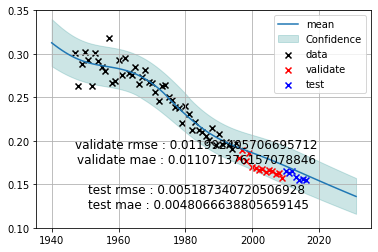

 18%|█▊        | 233/1296 [19:48<1:06:42,  3.76s/it]

validate rmse : 0.011992405706695712 
 validate mae : 0.011071376157078846 

    test rmse : 0.005187340720506928 
 test mae : 0.0048066638805659145
(('sa', 2), ('sa', 1), ('sal', 1), ('box_cox', 2))
params:[-1.16136557e-01  2.26896100e+02]


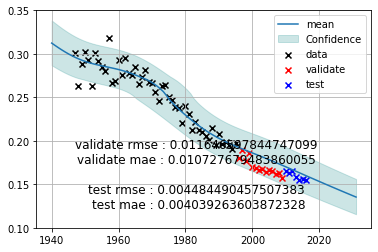

 18%|█▊        | 234/1296 [19:50<56:09,  3.17s/it]  

validate rmse : 0.011646597844747099 
 validate mae : 0.010727679483860055 

    test rmse : 0.004484490457507383 
 test mae : 0.004039263603872328
(('sa', 2), ('sa', 1), ('sal', 2), ('sa', 1))
params:[-1.22356779e-01  2.41206538e+02]


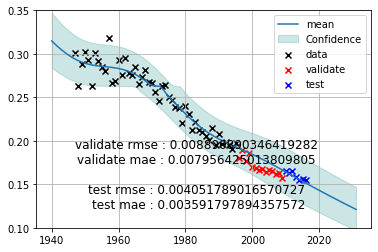

 18%|█▊        | 235/1296 [19:55<1:03:02,  3.56s/it]

validate rmse : 0.008890890346419282 
 validate mae : 0.007956425013809805 

    test rmse : 0.004051789016570727 
 test mae : 0.003591797894357572
(('sa', 2), ('sa', 1), ('sal', 2), ('sa', 2))
params:[-8.27874697e-02  1.61863277e+02]


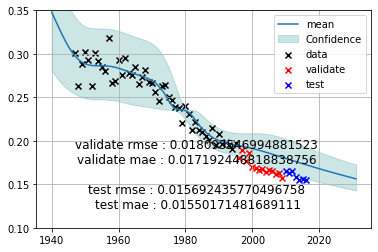

 18%|█▊        | 236/1296 [19:59<1:04:19,  3.64s/it]

validate rmse : 0.018093546994881523 
 validate mae : 0.017192448818838756 

    test rmse : 0.015692435770496758 
 test mae : 0.01550171481689111
(('sa', 2), ('sa', 1), ('sal', 2), ('sal', 1))
params:[-466.63906651   -2.08227734]


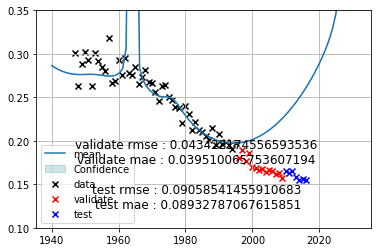

 18%|█▊        | 237/1296 [20:02<1:03:42,  3.61s/it]

validate rmse : 0.043422174556593536 
 validate mae : 0.039510065753607194 

    test rmse : 0.09058541455910683 
 test mae : 0.08932787067615851
(('sa', 2), ('sa', 1), ('sal', 2), ('sal', 2))
params:[-1.15500805e-01  2.27647600e+02]


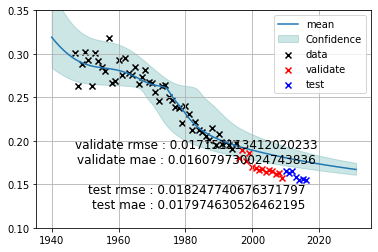

 18%|█▊        | 238/1296 [20:20<2:17:39,  7.81s/it]

validate rmse : 0.017151113412020233 
 validate mae : 0.016079730024743836 

    test rmse : 0.018247740676371797 
 test mae : 0.017974630526462195
(('sa', 2), ('sa', 1), ('sal', 2), ('box_cox', 1))
params:[ 0.00144082 -0.98494081]


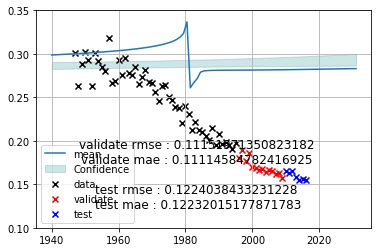

 18%|█▊        | 239/1296 [20:24<1:58:13,  6.71s/it]

validate rmse : 0.11151971350823182 
 validate mae : 0.11114584782416925 

    test rmse : 0.1224038433231228 
 test mae : 0.12232015177871783
(('sa', 2), ('sa', 1), ('sal', 2), ('box_cox', 2))
params:[-5.24563501e-01  1.02902837e+03]


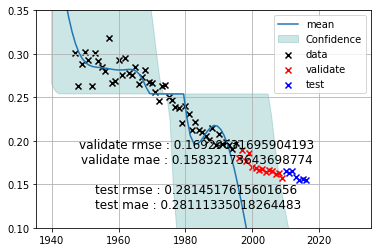

 19%|█▊        | 240/1296 [20:54<4:01:58, 13.75s/it]

validate rmse : 0.16929631695904193 
 validate mae : 0.15832173643698774 

    test rmse : 0.2814517615601656 
 test mae : 0.28111335018264483
(('sa', 2), ('sa', 1), ('box_cox', 1), ('sa', 1))
params:[-8.77005740e-02  1.71973537e+02]


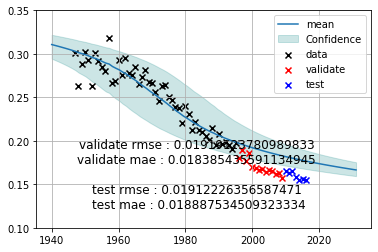

 19%|█▊        | 241/1296 [20:55<2:52:47,  9.83s/it]

validate rmse : 0.01919123780989833 
 validate mae : 0.018385435591134945 

    test rmse : 0.01912226356587471 
 test mae : 0.018887534509323334
(('sa', 2), ('sa', 1), ('box_cox', 1), ('sa', 2))
params:[-8.77005704e-02  1.71973531e+02]


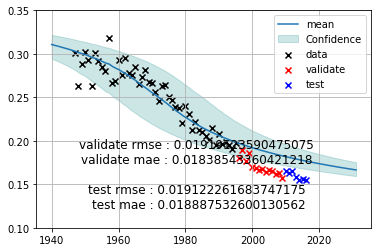

 19%|█▊        | 242/1296 [20:56<2:05:19,  7.13s/it]

validate rmse : 0.01919123590475075 
 validate mae : 0.01838543360421218 

    test rmse : 0.019122261683747175 
 test mae : 0.018887532600130562
(('sa', 2), ('sa', 1), ('box_cox', 1), ('sal', 1))
params:[-1.17297111e-01  2.31213297e+02]


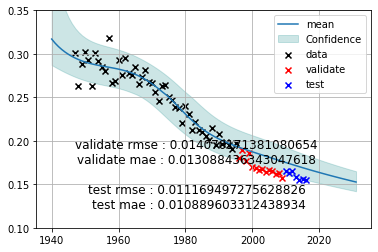

 19%|█▉        | 243/1296 [20:58<1:42:32,  5.84s/it]

validate rmse : 0.014070171381080654 
 validate mae : 0.013088436343047618 

    test rmse : 0.011169497275628826 
 test mae : 0.010889603312438934
(('sa', 2), ('sa', 1), ('box_cox', 1), ('sal', 2))
params:[ -602.05619127 -4190.55665622]


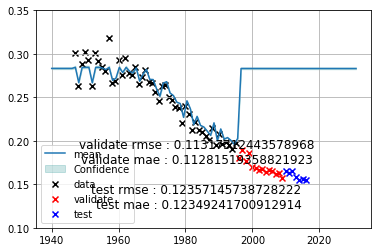

 19%|█▉        | 244/1296 [21:01<1:24:38,  4.83s/it]

validate rmse : 0.11317312443578968 
 validate mae : 0.11281519358821923 

    test rmse : 0.12357145738728222 
 test mae : 0.12349241700912914
(('sa', 2), ('sa', 1), ('box_cox', 1), ('box_cox', 1))
params:[-9.49112208e-02  1.84679840e+02]


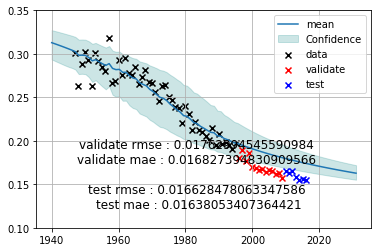

 19%|█▉        | 245/1296 [21:02<1:04:29,  3.68s/it]

validate rmse : 0.01762994545590984 
 validate mae : 0.016827394830909566 

    test rmse : 0.016628478063347586 
 test mae : 0.01638053407364421
(('sa', 2), ('sa', 1), ('box_cox', 1), ('box_cox', 2))
params:[-8.88970642e-02  1.71776565e+02]


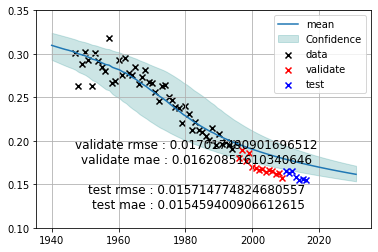

 19%|█▉        | 246/1296 [21:03<48:39,  2.78s/it]  

validate rmse : 0.017017490901696512 
 validate mae : 0.01620851610340646 

    test rmse : 0.015714774824680557 
 test mae : 0.015459400906612615
(('sa', 2), ('sa', 1), ('box_cox', 2), ('sa', 1))
params:[-7.75550443e-02  1.51300901e+02]


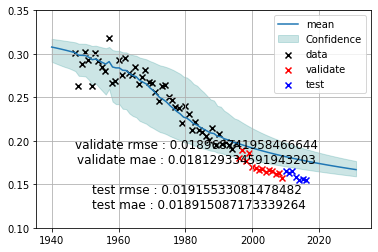

 19%|█▉        | 247/1296 [21:03<38:11,  2.18s/it]

validate rmse : 0.018968741958466644 
 validate mae : 0.018129334591943203 

    test rmse : 0.01915533081478482 
 test mae : 0.018915087173339264
(('sa', 2), ('sa', 1), ('box_cox', 2), ('sa', 2))
params:[-7.75550433e-02  1.51300900e+02]


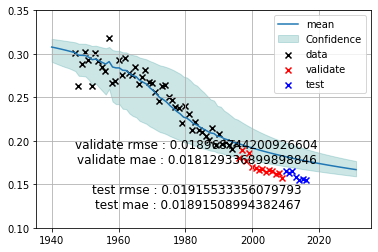

 19%|█▉        | 248/1296 [21:04<31:55,  1.83s/it]

validate rmse : 0.018968744200926604 
 validate mae : 0.018129336899898846 

    test rmse : 0.01915533356079793 
 test mae : 0.01891508994382467
(('sa', 2), ('sa', 1), ('box_cox', 2), ('sal', 1))
params:[-1.09345942e-01  2.15649543e+02]


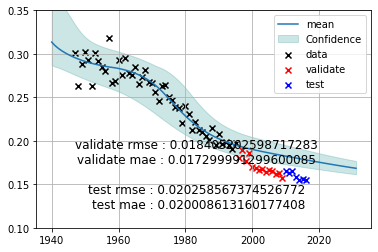

 19%|█▉        | 249/1296 [21:05<27:55,  1.60s/it]

validate rmse : 0.018405202598717283 
 validate mae : 0.017299991299600085 

    test rmse : 0.020258567374526772 
 test mae : 0.020008613160177408
(('sa', 2), ('sa', 1), ('box_cox', 2), ('sal', 2))
params:[-2.31381503e+05  4.53530686e+08]


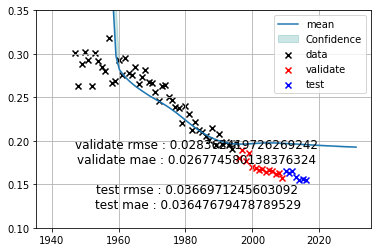

 19%|█▉        | 250/1296 [21:07<28:38,  1.64s/it]

validate rmse : 0.028362419726269242 
 validate mae : 0.026774580138376324 

    test rmse : 0.0366971245603092 
 test mae : 0.03647679478789529
(('sa', 2), ('sa', 1), ('box_cox', 2), ('box_cox', 1))
params:[-8.63744140e-02  1.66838349e+02]


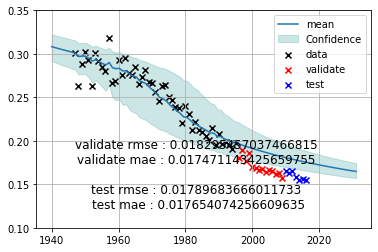

 19%|█▉        | 251/1296 [21:08<23:42,  1.36s/it]

validate rmse : 0.018295457037466815 
 validate mae : 0.017471143425659755 

    test rmse : 0.01789683666011733 
 test mae : 0.017654074256609635
(('sa', 2), ('sa', 1), ('box_cox', 2), ('box_cox', 2))
params:[-7.47076707e-02  1.42812478e+02]


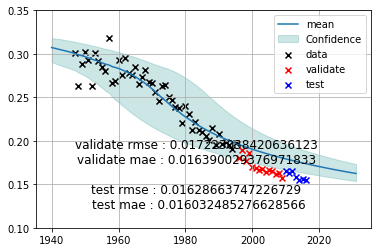

 19%|█▉        | 252/1296 [21:09<20:15,  1.16s/it]

validate rmse : 0.017223038420636123 
 validate mae : 0.016390029376971833 

    test rmse : 0.01628663747226729 
 test mae : 0.016032485276628566
(('sa', 2), ('sa', 2), ('sa', 1), ('sa', 1))
params:[-9.23416917e-02  1.81848274e+02]


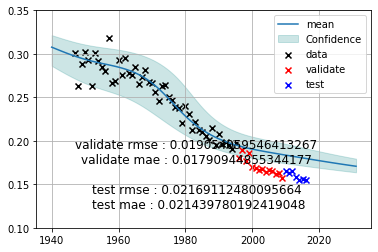

 20%|█▉        | 253/1296 [21:09<18:02,  1.04s/it]

validate rmse : 0.019054059546413267 
 validate mae : 0.01790944855344177 

    test rmse : 0.02169112480095664 
 test mae : 0.021439780192419048
(('sa', 2), ('sa', 2), ('sa', 1), ('sa', 2))
params:[-9.23416852e-02  1.81848261e+02]


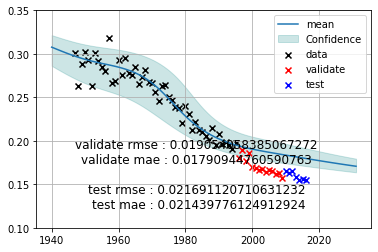

 20%|█▉        | 254/1296 [21:10<17:23,  1.00s/it]

validate rmse : 0.019054058385067272 
 validate mae : 0.01790944760590763 

    test rmse : 0.021691120710631232 
 test mae : 0.021439776124912924
(('sa', 2), ('sa', 2), ('sa', 1), ('sal', 1))
params:[-1.18321323e-01  2.33162172e+02]


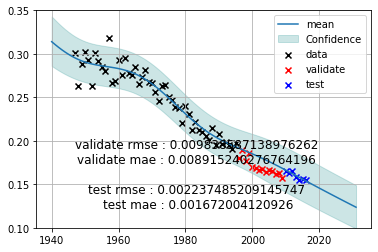

 20%|█▉        | 255/1296 [21:12<22:20,  1.29s/it]

validate rmse : 0.009838587138976262 
 validate mae : 0.008915240276764196 

    test rmse : 0.002237485209145747 
 test mae : 0.001672004120926
(('sa', 2), ('sa', 2), ('sa', 1), ('sal', 2))
params:[-8.90639816e+04  1.76750631e+08]


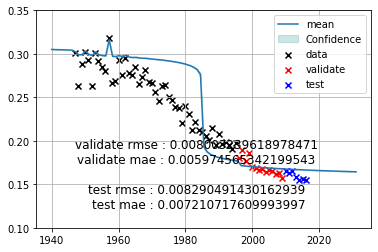

 20%|█▉        | 256/1296 [21:22<1:04:56,  3.75s/it]

validate rmse : 0.008003239618978471 
 validate mae : 0.005974565342199543 

    test rmse : 0.008290491430162939 
 test mae : 0.007210717609993997
(('sa', 2), ('sa', 2), ('sa', 1), ('box_cox', 1))
params:[-9.51593271e-02  1.86341433e+02]


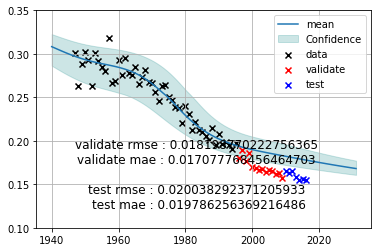

 20%|█▉        | 257/1296 [21:22<49:26,  2.85s/it]  

validate rmse : 0.018198770222756365 
 validate mae : 0.017077768456464703 

    test rmse : 0.020038292371205933 
 test mae : 0.019786256369216486
(('sa', 2), ('sa', 2), ('sa', 1), ('box_cox', 2))
params:[-9.15345818e-02  1.78094099e+02]


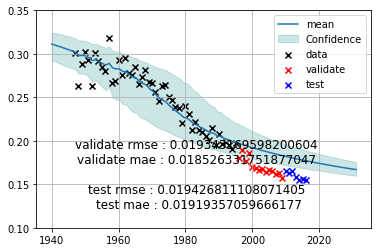

 20%|█▉        | 258/1296 [21:23<38:47,  2.24s/it]

validate rmse : 0.019343169598200604 
 validate mae : 0.018526331751877047 

    test rmse : 0.019426811108071405 
 test mae : 0.01919357059666177
(('sa', 2), ('sa', 2), ('sa', 2), ('sa', 1))
params:[-9.23417101e-02  1.81848310e+02]


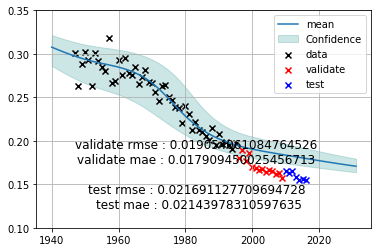

 20%|█▉        | 259/1296 [21:24<31:56,  1.85s/it]

validate rmse : 0.019054061084764526 
 validate mae : 0.017909450025456713 

    test rmse : 0.021691127709694728 
 test mae : 0.02143978310597635
(('sa', 2), ('sa', 2), ('sa', 2), ('sa', 2))
params:[-9.23416361e-02  1.81848165e+02]


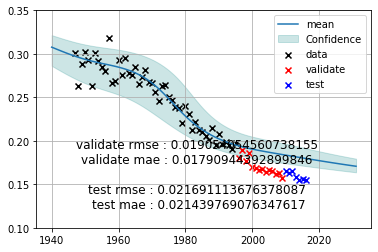

 20%|██        | 260/1296 [21:25<28:03,  1.63s/it]

validate rmse : 0.019054054560738155 
 validate mae : 0.01790944392899846 

    test rmse : 0.021691113676378087 
 test mae : 0.021439769076347617
(('sa', 2), ('sa', 2), ('sa', 2), ('sal', 1))
params:[-1.18488112e-01  2.33508947e+02]


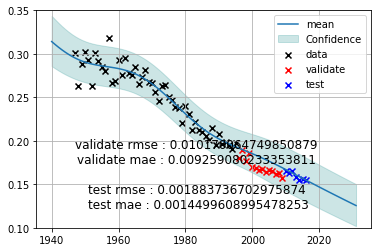

 20%|██        | 261/1296 [21:27<30:35,  1.77s/it]

validate rmse : 0.010170064749850879 
 validate mae : 0.009259080233353811 

    test rmse : 0.001883736702975874 
 test mae : 0.0014499608995478253
(('sa', 2), ('sa', 2), ('sa', 2), ('sal', 2))
params:[-1.17946408e-01  2.32449350e+02]


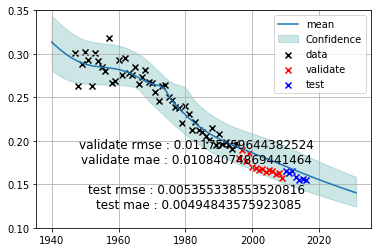

 20%|██        | 262/1296 [21:39<1:23:00,  4.82s/it]

validate rmse : 0.01175459644382524 
 validate mae : 0.01084074869441464 

    test rmse : 0.005355338553520816 
 test mae : 0.00494843575923085
(('sa', 2), ('sa', 2), ('sa', 2), ('box_cox', 1))
params:[-9.51593360e-02  1.86341451e+02]


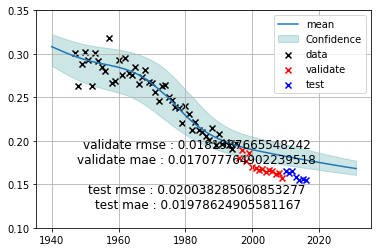

 20%|██        | 263/1296 [21:40<1:02:58,  3.66s/it]

validate rmse : 0.0181987665548242 
 validate mae : 0.017077764902239518 

    test rmse : 0.020038285060853277 
 test mae : 0.01978624905581167
(('sa', 2), ('sa', 2), ('sa', 2), ('box_cox', 2))
params:[-9.15347803e-02  1.78094486e+02]


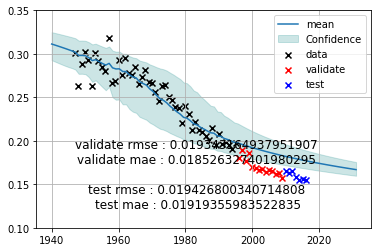

 20%|██        | 264/1296 [21:41<49:03,  2.85s/it]  

validate rmse : 0.019343164937951907 
 validate mae : 0.018526327401980295 

    test rmse : 0.019426800340714808 
 test mae : 0.01919355983522835
(('sa', 2), ('sa', 2), ('sal', 1), ('sa', 1))
params:[-1.18479374e-01  2.33579771e+02]


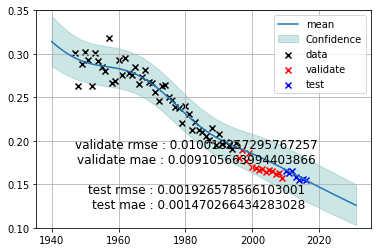

 20%|██        | 265/1296 [21:43<44:34,  2.59s/it]

validate rmse : 0.010018257295767257 
 validate mae : 0.009105663994403866 

    test rmse : 0.001926578566103001 
 test mae : 0.001470266434283028
(('sa', 2), ('sa', 2), ('sal', 1), ('sa', 2))
params:[-1.18506662e-01  2.33634588e+02]


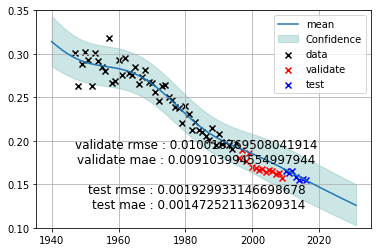

 21%|██        | 266/1296 [21:45<42:37,  2.48s/it]

validate rmse : 0.010016769508041914 
 validate mae : 0.009103994554997944 

    test rmse : 0.001929933146698678 
 test mae : 0.001472521136209314
(('sa', 2), ('sa', 2), ('sal', 1), ('sal', 1))
params:[-1.15023933e-01  2.26510129e+02]


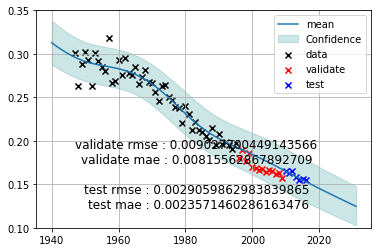

 21%|██        | 267/1296 [21:48<41:50,  2.44s/it]

validate rmse : 0.009027700449143566 
 validate mae : 0.00815562867892709 

    test rmse : 0.0029059862983839865 
 test mae : 0.0023571460286163476
(('sa', 2), ('sa', 2), ('sal', 1), ('sal', 2))
params:[-1.16300125e-01  2.29203274e+02]


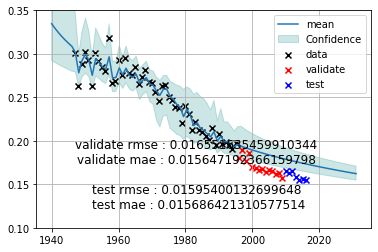

 21%|██        | 268/1296 [22:12<2:35:00,  9.05s/it]

validate rmse : 0.016551635459910344 
 validate mae : 0.015647192366159798 

    test rmse : 0.01595400132699648 
 test mae : 0.015686421310577514
(('sa', 2), ('sa', 2), ('sal', 1), ('box_cox', 1))
params:[-1.16481630e-01  2.28658506e+02]


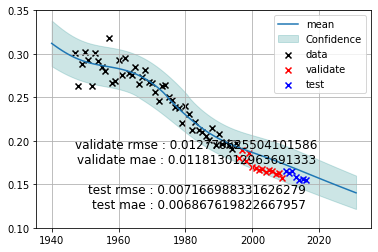

 21%|██        | 269/1296 [22:14<1:57:46,  6.88s/it]

validate rmse : 0.012770625504101586 
 validate mae : 0.011813012963691333 

    test rmse : 0.007166988331626279 
 test mae : 0.006867619822667957
(('sa', 2), ('sa', 2), ('sal', 1), ('box_cox', 2))
params:[-1.16613611e-01  2.27859887e+02]


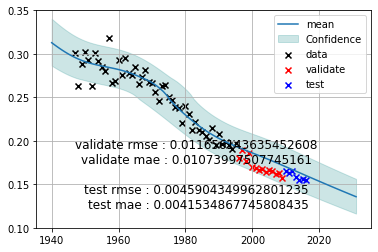

 21%|██        | 270/1296 [22:16<1:30:55,  5.32s/it]

validate rmse : 0.011656143635452608 
 validate mae : 0.01073997507745161 

    test rmse : 0.0045904349962801235 
 test mae : 0.0041534867745808435
(('sa', 2), ('sa', 2), ('sal', 2), ('sa', 1))
params:[-1.21006488e-01  2.38650029e+02]


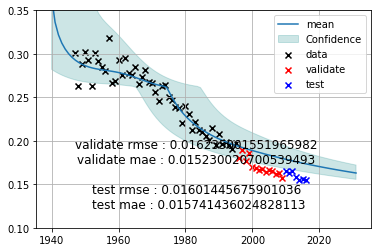

 21%|██        | 271/1296 [22:42<3:18:37, 11.63s/it]

validate rmse : 0.016235001551965982 
 validate mae : 0.015230020700539493 

    test rmse : 0.01601445675901036 
 test mae : 0.015741436024828113
(('sa', 2), ('sa', 2), ('sal', 2), ('sa', 2))
params:[-1.23157175e-01  2.42791774e+02]


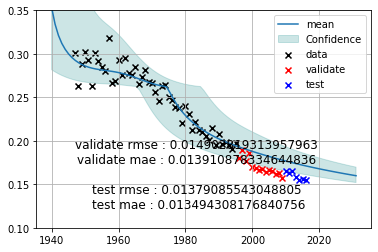

 21%|██        | 272/1296 [22:50<2:59:12, 10.50s/it]

validate rmse : 0.014902819313957963 
 validate mae : 0.013910878334644836 

    test rmse : 0.01379085543048805 
 test mae : 0.013494308176840756
(('sa', 2), ('sa', 2), ('sal', 2), ('sal', 1))
params:[-1. -1.]


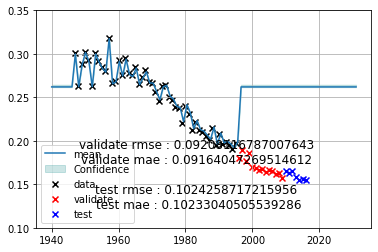

 21%|██        | 273/1296 [22:54<2:25:41,  8.54s/it]

validate rmse : 0.09208116787007643 
 validate mae : 0.09164047269514612 

    test rmse : 0.1024258717215956 
 test mae : 0.10233040505539286
(('sa', 2), ('sa', 2), ('sal', 2), ('sal', 2))
params:[-5.77550405e-01  1.13355811e+03]


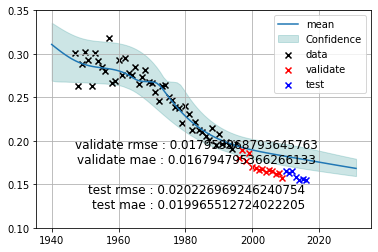

 21%|██        | 274/1296 [22:59<2:08:55,  7.57s/it]

validate rmse : 0.017959968793645763 
 validate mae : 0.016794795366266133 

    test rmse : 0.020226969246240754 
 test mae : 0.019965512724022205
(('sa', 2), ('sa', 2), ('sal', 2), ('box_cox', 1))
params:[-1.17468675e-05  2.66564127e+00]


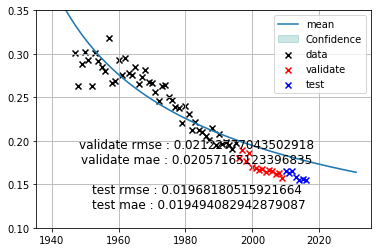

 21%|██        | 275/1296 [23:07<2:07:43,  7.51s/it]

validate rmse : 0.02122777043502918 
 validate mae : 0.02057165123396835 

    test rmse : 0.01968180515921664 
 test mae : 0.019494082942879087
(('sa', 2), ('sa', 2), ('sal', 2), ('box_cox', 2))
params:[ 2.07959059e-02 -3.80720689e+01]


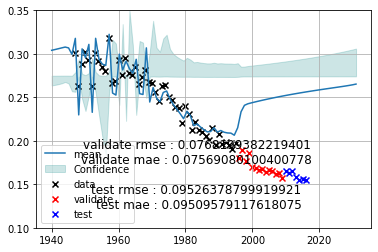

 21%|██▏       | 276/1296 [23:12<1:58:10,  6.95s/it]

validate rmse : 0.0768199382219401 
 validate mae : 0.07569080100400778 

    test rmse : 0.09526378799919921 
 test mae : 0.09509579117618075
(('sa', 2), ('sa', 2), ('box_cox', 1), ('sa', 1))
params:[-8.77005729e-02  1.71973535e+02]


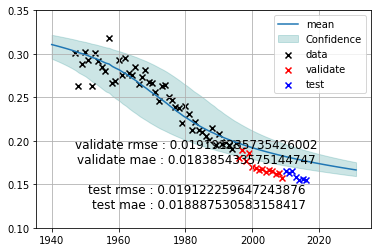

 21%|██▏       | 277/1296 [23:13<1:26:38,  5.10s/it]

validate rmse : 0.019191235735426002 
 validate mae : 0.018385433575144747 

    test rmse : 0.019122259647243876 
 test mae : 0.018887530583158417
(('sa', 2), ('sa', 2), ('box_cox', 1), ('sa', 2))
params:[-8.77005498e-02  1.71973489e+02]


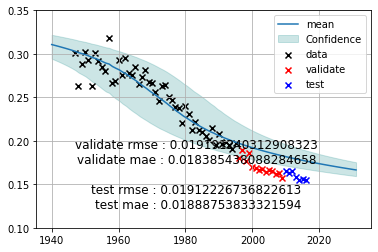

 21%|██▏       | 278/1296 [23:14<1:04:53,  3.82s/it]

validate rmse : 0.019191240312908323 
 validate mae : 0.018385438088284658 

    test rmse : 0.01912226736822613 
 test mae : 0.01888753833321594
(('sa', 2), ('sa', 2), ('box_cox', 1), ('sal', 1))
params:[-1.17286048e-01  2.31191325e+02]


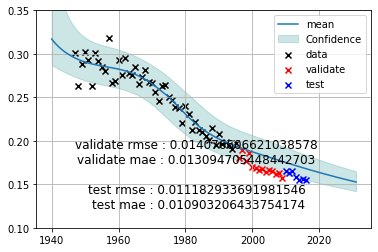

 22%|██▏       | 279/1296 [23:17<1:02:06,  3.66s/it]

validate rmse : 0.014076606621038578 
 validate mae : 0.013094705448442703 

    test rmse : 0.011182933691981546 
 test mae : 0.010903206433754174
(('sa', 2), ('sa', 2), ('box_cox', 1), ('sal', 2))
params:[-1.20913718e-01  2.38319573e+02]


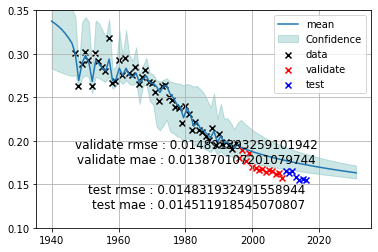

 22%|██▏       | 280/1296 [23:24<1:19:06,  4.67s/it]

validate rmse : 0.014891393259101942 
 validate mae : 0.013870107201079744 

    test rmse : 0.014831932491558944 
 test mae : 0.014511918545070807
(('sa', 2), ('sa', 2), ('box_cox', 1), ('box_cox', 1))
params:[-9.49112405e-02  1.84679879e+02]


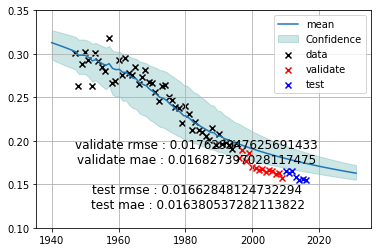

 22%|██▏       | 281/1296 [23:25<59:18,  3.51s/it]  

validate rmse : 0.017629947625691433 
 validate mae : 0.016827397028117475 

    test rmse : 0.01662848124732294 
 test mae : 0.016380537282113822
(('sa', 2), ('sa', 2), ('box_cox', 1), ('box_cox', 2))
params:[-8.88971061e-02  1.71776649e+02]


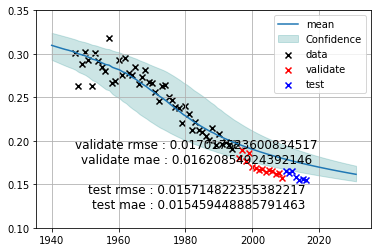

 22%|██▏       | 282/1296 [23:26<45:39,  2.70s/it]

validate rmse : 0.017017523600834517 
 validate mae : 0.01620854924392146 

    test rmse : 0.015714822355382217 
 test mae : 0.015459448885791463
(('sa', 2), ('sa', 2), ('box_cox', 2), ('sa', 1))
params:[-7.75550481e-02  1.51300910e+02]


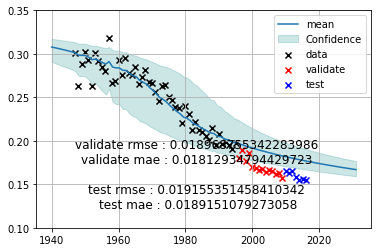

 22%|██▏       | 283/1296 [23:27<35:59,  2.13s/it]

validate rmse : 0.018968755342283986 
 validate mae : 0.01812934794429723 

    test rmse : 0.019155351458410342 
 test mae : 0.0189151079273058
(('sa', 2), ('sa', 2), ('box_cox', 2), ('sa', 2))
params:[-7.75550178e-02  1.51300849e+02]


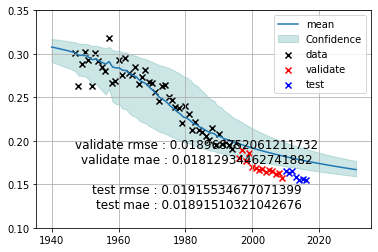

 22%|██▏       | 284/1296 [23:27<29:26,  1.75s/it]

validate rmse : 0.018968752061211732 
 validate mae : 0.01812934462741882 

    test rmse : 0.01915534677071399 
 test mae : 0.01891510321042676
(('sa', 2), ('sa', 2), ('box_cox', 2), ('sal', 1))
params:[-1.09345791e-01  2.15649224e+02]


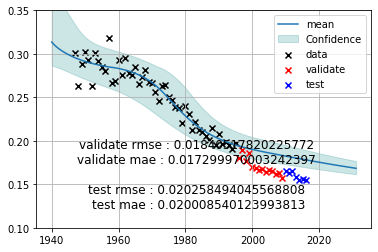

 22%|██▏       | 285/1296 [23:29<27:09,  1.61s/it]

validate rmse : 0.01840517820225772 
 validate mae : 0.017299970003242397 

    test rmse : 0.020258494045568808 
 test mae : 0.020008540123993813
(('sa', 2), ('sa', 2), ('box_cox', 2), ('sal', 2))
params:[-1.18147065e-01  2.32879959e+02]


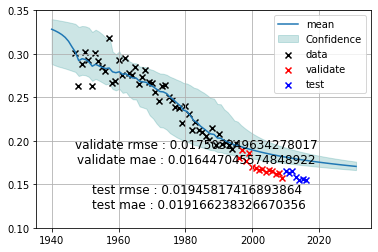

 22%|██▏       | 286/1296 [23:32<37:44,  2.24s/it]

validate rmse : 0.017503249634278017 
 validate mae : 0.016447045574848922 

    test rmse : 0.01945817416893864 
 test mae : 0.019166238326670356
(('sa', 2), ('sa', 2), ('box_cox', 2), ('box_cox', 1))
params:[-8.63743416e-02  1.66838209e+02]


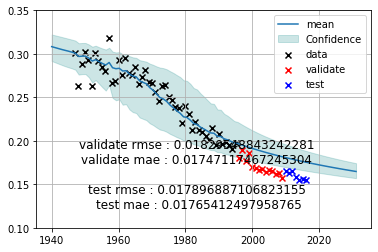

 22%|██▏       | 287/1296 [23:33<30:05,  1.79s/it]

validate rmse : 0.01829548843242281 
 validate mae : 0.01747117467245304 

    test rmse : 0.017896887106823155 
 test mae : 0.01765412497958765
(('sa', 2), ('sa', 2), ('box_cox', 2), ('box_cox', 2))
params:[-7.47075661e-02  1.42812271e+02]


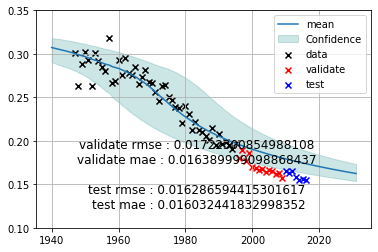

 22%|██▏       | 288/1296 [23:34<25:21,  1.51s/it]

validate rmse : 0.01722300854988108 
 validate mae : 0.016389999098868437 

    test rmse : 0.016286594415301617 
 test mae : 0.016032441832998352
(('sa', 2), ('sal', 1), ('sa', 1), ('sa', 1))
params:[-1.17927555e-01  2.32470815e+02]


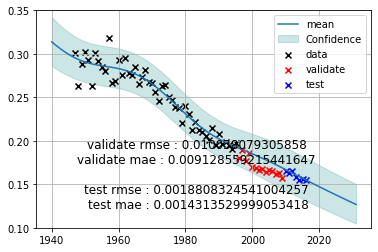

 22%|██▏       | 289/1296 [23:35<24:04,  1.43s/it]

validate rmse : 0.010038079305858 
 validate mae : 0.009128559215441647 

    test rmse : 0.0018808324541004257 
 test mae : 0.0014313529999053418
(('sa', 2), ('sal', 1), ('sa', 1), ('sa', 2))
params:[-1.18378363e-01  2.33367941e+02]


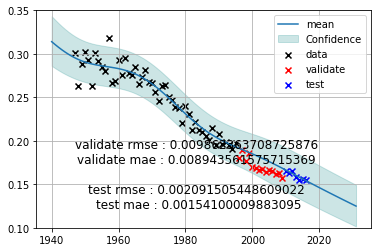

 22%|██▏       | 290/1296 [23:37<26:36,  1.59s/it]

validate rmse : 0.009862363708725876 
 validate mae : 0.008943561575715369 

    test rmse : 0.002091505448609022 
 test mae : 0.00154100009883095
(('sa', 2), ('sal', 1), ('sa', 1), ('sal', 1))
params:[-1.15088294e-01  2.26637308e+02]


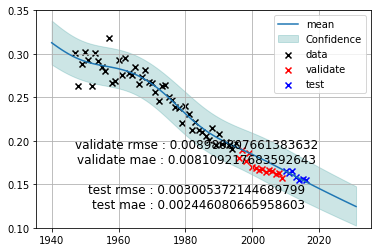

 22%|██▏       | 291/1296 [23:39<29:03,  1.74s/it]

validate rmse : 0.008980807661383632 
 validate mae : 0.008109217683592643 

    test rmse : 0.003005372144689799 
 test mae : 0.002446080665958603
(('sa', 2), ('sal', 1), ('sa', 1), ('sal', 2))
params:[-1.18335935e-01  2.33278574e+02]


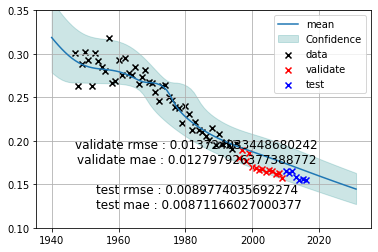

 23%|██▎       | 292/1296 [23:51<1:20:41,  4.82s/it]

validate rmse : 0.013724033448680242 
 validate mae : 0.012797926377388772 

    test rmse : 0.0089774035692274 
 test mae : 0.00871166027000377
(('sa', 2), ('sal', 1), ('sa', 1), ('box_cox', 1))
params:[-1.15803325e-01  2.27407374e+02]


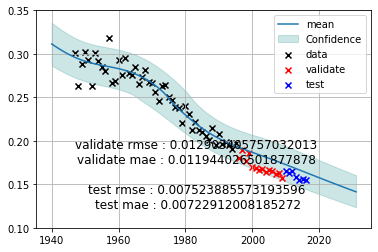

 23%|██▎       | 293/1296 [23:53<1:05:04,  3.89s/it]

validate rmse : 0.012903405757032013 
 validate mae : 0.011944026501877878 

    test rmse : 0.007523885573193596 
 test mae : 0.00722912008185272
(('sa', 2), ('sal', 1), ('sa', 1), ('box_cox', 2))
params:[-1.16281228e-01  2.27292596e+02]


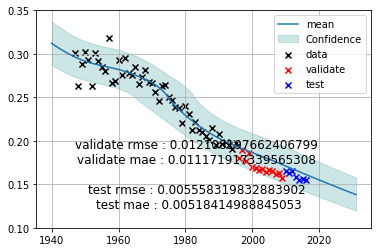

 23%|██▎       | 294/1296 [23:55<54:52,  3.29s/it]  

validate rmse : 0.012108197662406799 
 validate mae : 0.011171917339565308 

    test rmse : 0.005558319832883902 
 test mae : 0.00518414988845053
(('sa', 2), ('sal', 1), ('sa', 2), ('sa', 1))
params:[-1.18493769e-01  2.33605975e+02]


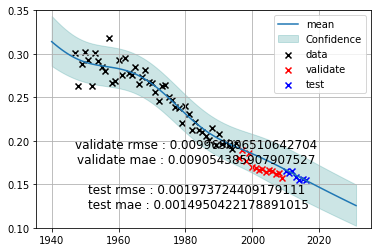

 23%|██▎       | 295/1296 [23:57<49:49,  2.99s/it]

validate rmse : 0.009969006510642704 
 validate mae : 0.009054385907907527 

    test rmse : 0.001973724409179111 
 test mae : 0.0014950422178891015
(('sa', 2), ('sal', 1), ('sa', 2), ('sa', 2))
params:[-1.17026065e-01  2.30563351e+02]


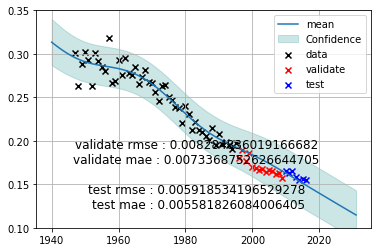

 23%|██▎       | 296/1296 [24:00<48:02,  2.88s/it]

validate rmse : 0.008284836019166682 
 validate mae : 0.0073368752626644705 

    test rmse : 0.005918534196529278 
 test mae : 0.005581826084006405
(('sa', 2), ('sal', 1), ('sa', 2), ('sal', 1))
params:[-1.15044545e-01  2.26551090e+02]


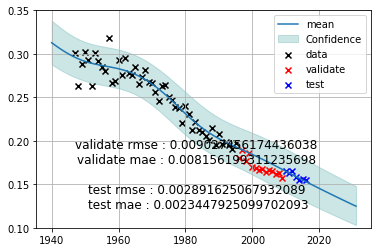

 23%|██▎       | 297/1296 [24:02<43:46,  2.63s/it]

validate rmse : 0.009027456174436038 
 validate mae : 0.008156199311235698 

    test rmse : 0.002891625067932089 
 test mae : 0.0023447925099702093
(('sa', 2), ('sal', 1), ('sa', 2), ('sal', 2))
params:[-1.13922960e-01  2.24305517e+02]


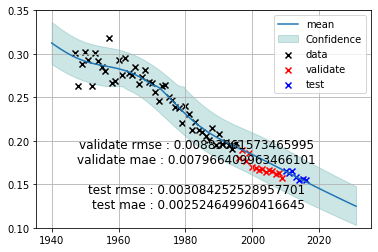

 23%|██▎       | 298/1296 [24:16<1:42:43,  6.18s/it]

validate rmse : 0.00883061573465995 
 validate mae : 0.007966409963466101 

    test rmse : 0.003084252528957701 
 test mae : 0.002524649960416645
(('sa', 2), ('sal', 1), ('sa', 2), ('box_cox', 1))
params:[-1.15606871e-01  2.26955637e+02]


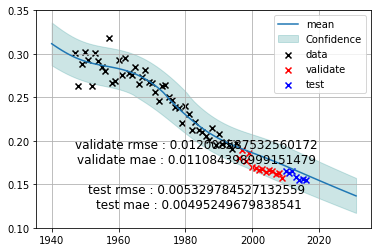

 23%|██▎       | 299/1296 [24:18<1:21:37,  4.91s/it]

validate rmse : 0.012008587532560172 
 validate mae : 0.011084398999151479 

    test rmse : 0.005329784527132559 
 test mae : 0.00495249679838541
(('sa', 2), ('sal', 1), ('sa', 2), ('box_cox', 2))
params:[-1.16126285e-01  2.26978391e+02]


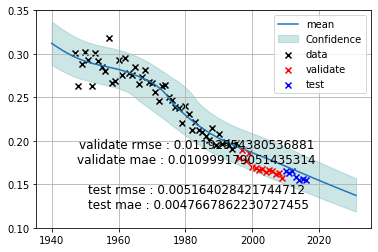

 23%|██▎       | 300/1296 [24:20<1:05:57,  3.97s/it]

validate rmse : 0.01192954380536881 
 validate mae : 0.010999179051435314 

    test rmse : 0.005164028421744712 
 test mae : 0.0047667862230727455
(('sa', 2), ('sal', 1), ('sal', 1), ('sa', 1))
params:[-1.14370414e-01  2.25218816e+02]


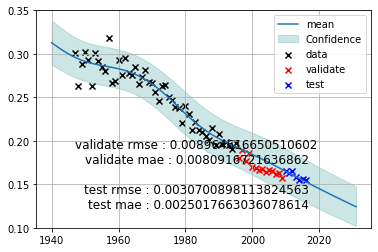

 23%|██▎       | 301/1296 [24:23<58:10,  3.51s/it]  

validate rmse : 0.008964616650510602 
 validate mae : 0.0080916721636862 

    test rmse : 0.0030700898113824563 
 test mae : 0.0025017663036078614
(('sa', 2), ('sal', 1), ('sal', 1), ('sa', 2))
params:[-1.14363960e-01  2.25206084e+02]


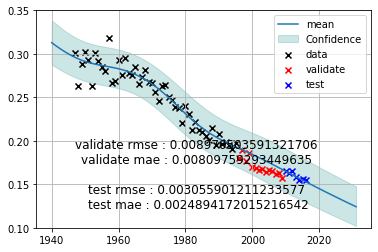

 23%|██▎       | 302/1296 [24:25<51:19,  3.10s/it]

validate rmse : 0.008970503591321706 
 validate mae : 0.00809759293449635 

    test rmse : 0.003055901211233577 
 test mae : 0.0024894172015216542
(('sa', 2), ('sal', 1), ('sal', 1), ('sal', 1))
params:[-1.19227553e-01  2.34835239e+02]


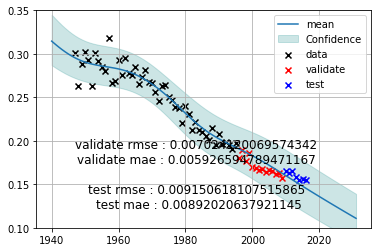

 23%|██▎       | 303/1296 [24:27<45:56,  2.78s/it]

validate rmse : 0.007024120069574342 
 validate mae : 0.005926594789471167 

    test rmse : 0.009150618107515865 
 test mae : 0.00892020637921145
(('sa', 2), ('sal', 1), ('sal', 1), ('sal', 2))
params:[-1.15304781e-01  2.27328825e+02]


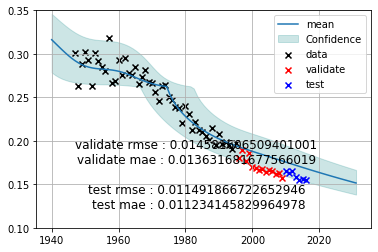

 23%|██▎       | 304/1296 [24:35<1:14:03,  4.48s/it]

validate rmse : 0.014581606509401001 
 validate mae : 0.013631681677566019 

    test rmse : 0.011491866722652946 
 test mae : 0.011234145829964978
(('sa', 2), ('sal', 1), ('sal', 1), ('box_cox', 1))
params:[-1.12956878e-01  2.21512194e+02]


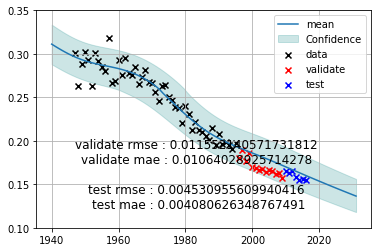

 24%|██▎       | 305/1296 [24:38<1:03:27,  3.84s/it]

validate rmse : 0.011552140571731812 
 validate mae : 0.01064028925714278 

    test rmse : 0.004530955609940416 
 test mae : 0.004080626348767491
(('sa', 2), ('sal', 1), ('sal', 1), ('box_cox', 2))
params:[-1.12702207e-01  2.19944580e+02]


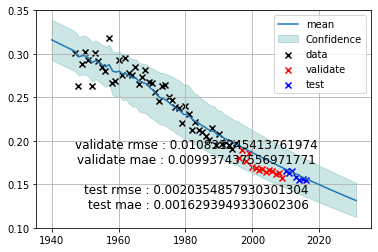

 24%|██▎       | 306/1296 [24:39<51:21,  3.11s/it]  

validate rmse : 0.010831245413761974 
 validate mae : 0.009937437556971771 

    test rmse : 0.0020354857930301304 
 test mae : 0.0016293949330602306
(('sa', 2), ('sal', 1), ('sal', 2), ('sa', 1))
params:[-1.33754225e-01  2.63640430e+02]


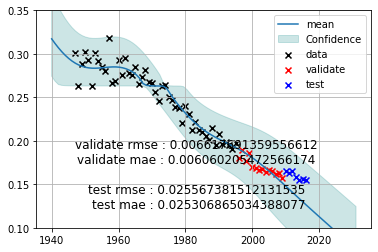

 24%|██▎       | 307/1296 [24:44<1:01:15,  3.72s/it]

validate rmse : 0.006617691359556612 
 validate mae : 0.006060205472566174 

    test rmse : 0.025567381512131535 
 test mae : 0.025306865034388077
(('sa', 2), ('sal', 1), ('sal', 2), ('sa', 2))
params:[-1.17041501e-01  2.30529369e+02]


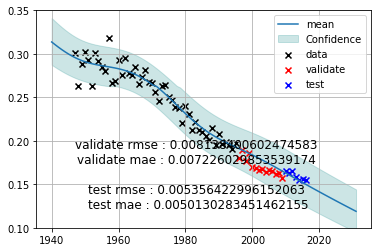

 24%|██▍       | 308/1296 [24:55<1:37:38,  5.93s/it]

validate rmse : 0.008138400602474583 
 validate mae : 0.007226029853539174 

    test rmse : 0.005356422996152063 
 test mae : 0.0050130283451462155
(('sa', 2), ('sal', 1), ('sal', 2), ('sal', 1))
params:[-1.15368378e-01  2.27347136e+02]


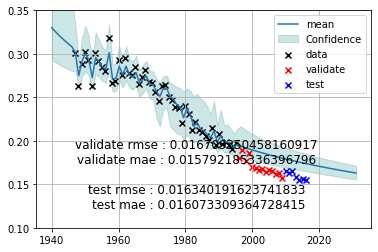

 24%|██▍       | 309/1296 [25:12<2:33:22,  9.32s/it]

validate rmse : 0.016709350458160917 
 validate mae : 0.015792185336396796 

    test rmse : 0.016340191623741833 
 test mae : 0.016073309364728415
(('sa', 2), ('sal', 1), ('sal', 2), ('sal', 2))
params:[-1.20186896e-01  2.36879688e+02]


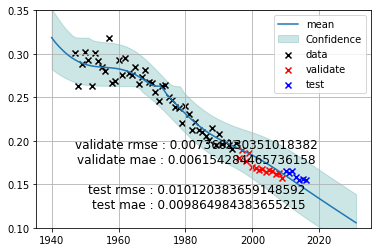

 24%|██▍       | 310/1296 [25:35<3:40:15, 13.40s/it]

validate rmse : 0.007360130351018382 
 validate mae : 0.006154284465736158 

    test rmse : 0.010120383659148592 
 test mae : 0.009864984383655215
(('sa', 2), ('sal', 1), ('sal', 2), ('box_cox', 1))
params:[-1.17172608e-01  2.29518478e+02]


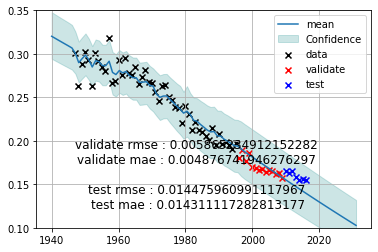

 24%|██▍       | 311/1296 [26:00<4:37:42, 16.92s/it]

validate rmse : 0.005865234912152282 
 validate mae : 0.004876741946276297 

    test rmse : 0.014475960991117967 
 test mae : 0.014311117282813177
(('sa', 2), ('sal', 1), ('sal', 2), ('box_cox', 2))
params:[-1.29240548e-01  2.52713499e+02]


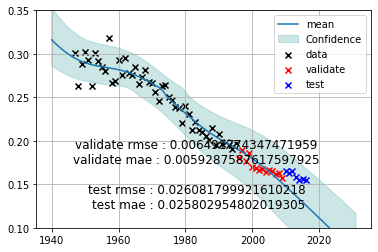

 24%|██▍       | 312/1296 [26:06<3:42:00, 13.54s/it]

validate rmse : 0.006491774347471959 
 validate mae : 0.0059287587617597925 

    test rmse : 0.026081799921610218 
 test mae : 0.025802954802019305
(('sa', 2), ('sal', 1), ('box_cox', 1), ('sa', 1))
params:[-1.05600719e-01  2.07624411e+02]


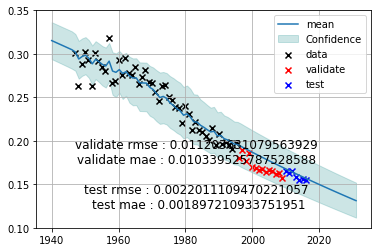

 24%|██▍       | 313/1296 [26:08<2:44:53, 10.06s/it]

validate rmse : 0.011203631079563929 
 validate mae : 0.010339525787528588 

    test rmse : 0.0022011109470221057 
 test mae : 0.001897210933751951
(('sa', 2), ('sal', 1), ('box_cox', 1), ('sa', 2))
params:[-1.05481794e-01  2.07391516e+02]


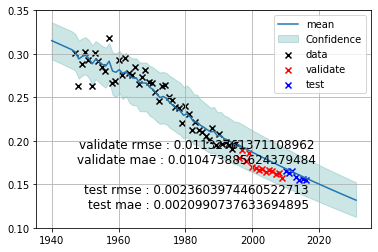

 24%|██▍       | 314/1296 [26:10<2:06:51,  7.75s/it]

validate rmse : 0.01132761371108962 
 validate mae : 0.010473885624379484 

    test rmse : 0.0023603974460522713 
 test mae : 0.0020990737633694895
(('sa', 2), ('sal', 1), ('box_cox', 1), ('sal', 1))
params:[-1.23487308e-01  2.43320494e+02]


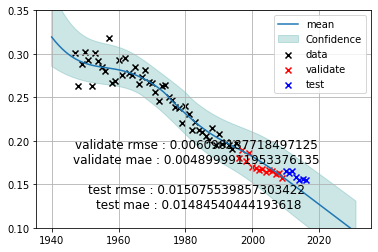

 24%|██▍       | 315/1296 [26:13<1:40:34,  6.15s/it]

validate rmse : 0.006090187718497125 
 validate mae : 0.0048999911953376135 

    test rmse : 0.015075539857303422 
 test mae : 0.01484540444193618
(('sa', 2), ('sal', 1), ('box_cox', 1), ('sal', 2))
params:[-1.27255643e-01  2.50650023e+02]


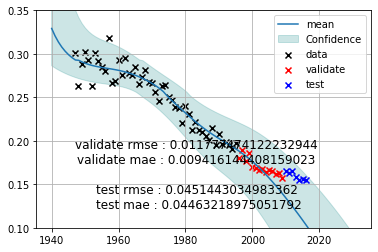

 24%|██▍       | 316/1296 [26:20<1:44:39,  6.41s/it]

validate rmse : 0.011777474122232944 
 validate mae : 0.009416144408159023 

    test rmse : 0.0451443034983362 
 test mae : 0.04463218975051792
(('sa', 2), ('sal', 1), ('box_cox', 1), ('box_cox', 1))
params:[-1.16294535e-01  2.27181125e+02]


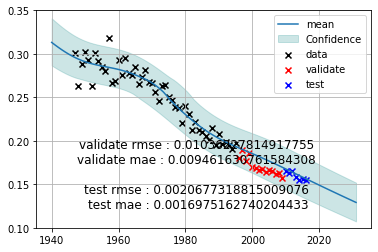

 24%|██▍       | 317/1296 [26:22<1:22:34,  5.06s/it]

validate rmse : 0.01036227814917755 
 validate mae : 0.009461630761584308 

    test rmse : 0.0020677318815009076 
 test mae : 0.0016975162740204433
(('sa', 2), ('sal', 1), ('box_cox', 1), ('box_cox', 2))
params:[-1.07899591e-01  2.09492660e+02]


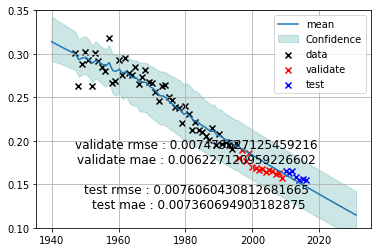

 25%|██▍       | 318/1296 [26:24<1:06:51,  4.10s/it]

validate rmse : 0.007479627125459216 
 validate mae : 0.006227120959226602 

    test rmse : 0.0076060430812681665 
 test mae : 0.007360694903182875
(('sa', 2), ('sal', 1), ('box_cox', 2), ('sa', 1))
params:[-9.66503908e-02  1.89349366e+02]


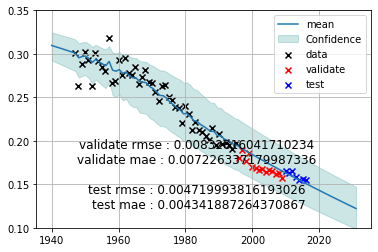

 25%|██▍       | 319/1296 [26:25<55:14,  3.39s/it]  

validate rmse : 0.00832816041710234 
 validate mae : 0.007226337179987336 

    test rmse : 0.004719993816193026 
 test mae : 0.004341887264370867
(('sa', 2), ('sal', 1), ('box_cox', 2), ('sa', 2))
params:[-9.51665225e-02  1.86424278e+02]


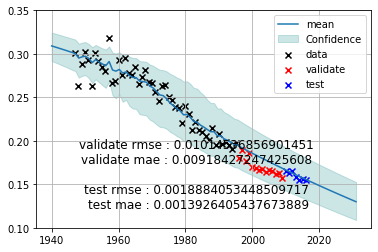

 25%|██▍       | 320/1296 [26:27<48:36,  2.99s/it]

validate rmse : 0.01014536856901451 
 validate mae : 0.00918427247425608 

    test rmse : 0.0018884053448509717 
 test mae : 0.0013926405437673889
(('sa', 2), ('sal', 1), ('box_cox', 2), ('sal', 1))
params:[-1.22688556e-01  2.41796301e+02]


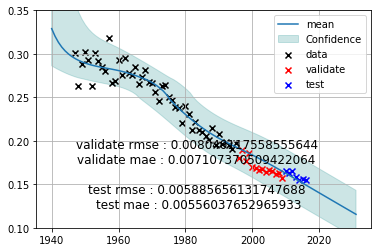

 25%|██▍       | 321/1296 [26:29<43:23,  2.67s/it]

validate rmse : 0.008040117558555644 
 validate mae : 0.007107370509422064 

    test rmse : 0.005885656131747688 
 test mae : 0.00556037652965933
(('sa', 2), ('sal', 1), ('box_cox', 2), ('sal', 2))
params:[-4.25180240e+07  8.33295164e+10]


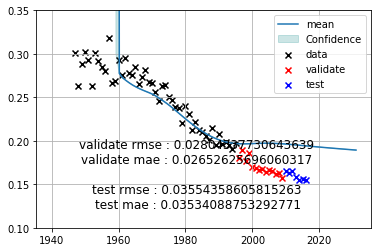

 25%|██▍       | 322/1296 [26:32<43:35,  2.69s/it]

validate rmse : 0.02804337730643639 
 validate mae : 0.02652625696060317 

    test rmse : 0.03554358605815263 
 test mae : 0.03534088753292771
(('sa', 2), ('sal', 1), ('box_cox', 2), ('box_cox', 1))
params:[-1.09454468e-01  2.12596367e+02]


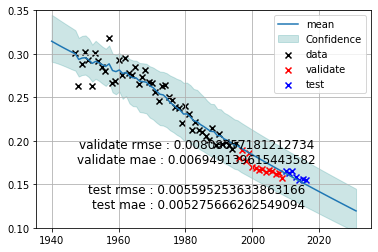

 25%|██▍       | 323/1296 [26:34<40:38,  2.51s/it]

validate rmse : 0.00808057181212734 
 validate mae : 0.006949139615443582 

    test rmse : 0.005595253633863166 
 test mae : 0.005275666262549094
(('sa', 2), ('sal', 1), ('box_cox', 2), ('box_cox', 2))
params:[-9.42140226e-02  1.81502724e+02]


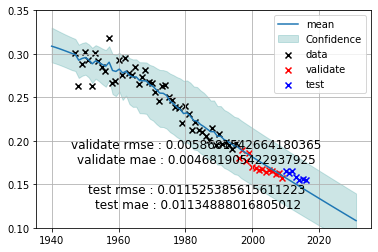

 25%|██▌       | 324/1296 [26:36<37:01,  2.29s/it]

validate rmse : 0.0058681542664180365 
 validate mae : 0.004681905422937925 

    test rmse : 0.011525385615611223 
 test mae : 0.01134888016805012
(('sa', 2), ('sal', 2), ('sa', 1), ('sa', 1))
params:[-1.44185897e-01  2.84228508e+02]


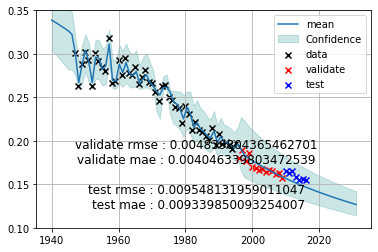

 25%|██▌       | 325/1296 [26:40<43:42,  2.70s/it]

validate rmse : 0.004839804365462701 
 validate mae : 0.004046339803472539 

    test rmse : 0.009548131959011047 
 test mae : 0.009339850093254007
(('sa', 2), ('sal', 2), ('sa', 1), ('sa', 2))
params:[-1.20997271e-01  2.38533897e+02]


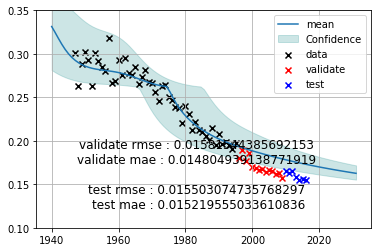

 25%|██▌       | 326/1296 [26:55<1:46:23,  6.58s/it]

validate rmse : 0.01581544385692153 
 validate mae : 0.014804939138771919 

    test rmse : 0.015503074735768297 
 test mae : 0.015219555033610836
(('sa', 2), ('sal', 2), ('sa', 1), ('sal', 1))
params:[-1.09506887e-01  2.15940077e+02]


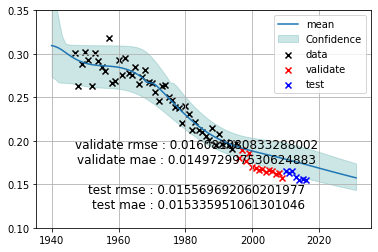

 25%|██▌       | 327/1296 [27:14<2:45:04, 10.22s/it]

validate rmse : 0.016081080833288002 
 validate mae : 0.014972997530624883 

    test rmse : 0.015569692060201977 
 test mae : 0.015335951061301046
(('sa', 2), ('sal', 2), ('sa', 1), ('sal', 2))
params:[-1.71848103e+00  3.40206357e+03]


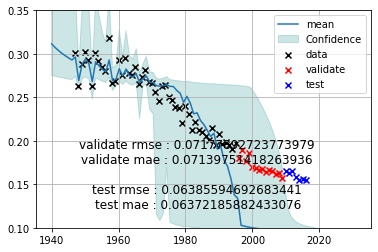

 25%|██▌       | 328/1296 [27:26<2:55:37, 10.89s/it]

validate rmse : 0.07177892723773979 
 validate mae : 0.07139751418263936 

    test rmse : 0.06385594692683441 
 test mae : 0.06372185882433076
(('sa', 2), ('sal', 2), ('sa', 1), ('box_cox', 1))
params:[-1.14116644e-01  2.23954589e+02]


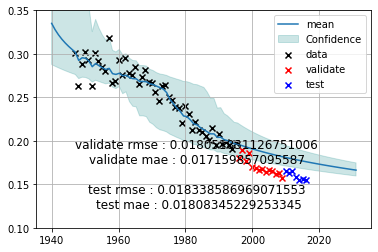

 25%|██▌       | 329/1296 [27:35<2:42:20, 10.07s/it]

validate rmse : 0.018051831126751006 
 validate mae : 0.017159857095587 

    test rmse : 0.018338586969071553 
 test mae : 0.01808345229253345
(('sa', 2), ('sal', 2), ('sa', 1), ('box_cox', 2))
params:[-1.19345543e-01  2.33415348e+02]


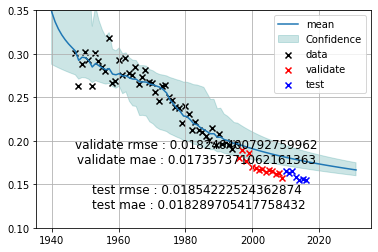

 25%|██▌       | 330/1296 [27:40<2:21:30,  8.79s/it]

validate rmse : 0.018240400792759962 
 validate mae : 0.017357371062161363 

    test rmse : 0.01854222524362874 
 test mae : 0.018289705417758432
(('sa', 2), ('sal', 2), ('sa', 2), ('sa', 1))
params:[-1.21225958e-01  2.39055521e+02]


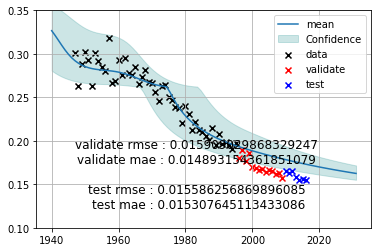

 26%|██▌       | 331/1296 [27:49<2:18:37,  8.62s/it]

validate rmse : 0.015909029868329247 
 validate mae : 0.014893154361851079 

    test rmse : 0.015586256869896085 
 test mae : 0.015307645113433086
(('sa', 2), ('sal', 2), ('sa', 2), ('sa', 2))
params:[-1.22217448e-01  2.40903459e+02]


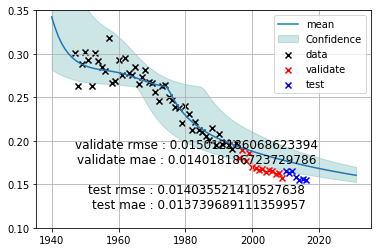

 26%|██▌       | 332/1296 [28:02<2:40:49, 10.01s/it]

validate rmse : 0.015012186068623394 
 validate mae : 0.014018186723729786 

    test rmse : 0.014035521410527638 
 test mae : 0.013739689111359957
(('sa', 2), ('sal', 2), ('sa', 2), ('sal', 1))
params:[-1.10123298e-01  2.16817379e+02]


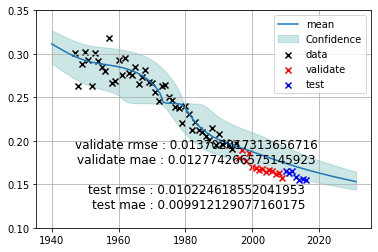

 26%|██▌       | 333/1296 [28:10<2:31:05,  9.41s/it]

validate rmse : 0.013702017313656716 
 validate mae : 0.012774266575145923 

    test rmse : 0.010224618552041953 
 test mae : 0.009912129077160175
(('sa', 2), ('sal', 2), ('sa', 2), ('sal', 2))
params:[-1.13763618e-01  2.24212514e+02]


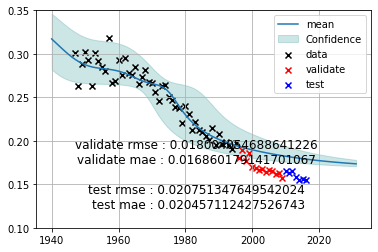

 26%|██▌       | 334/1296 [28:22<2:43:39, 10.21s/it]

validate rmse : 0.018004054688641226 
 validate mae : 0.016860179141701067 

    test rmse : 0.020751347649542024 
 test mae : 0.020457112427526743
(('sa', 2), ('sal', 2), ('sa', 2), ('box_cox', 1))
params:[-1.04933714e-01  2.05846429e+02]


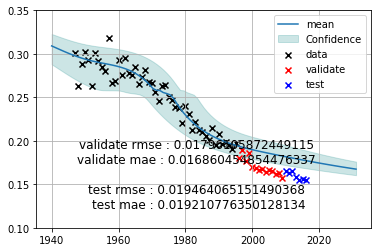

 26%|██▌       | 335/1296 [28:24<2:05:21,  7.83s/it]

validate rmse : 0.01796105872449115 
 validate mae : 0.016860454854476337 

    test rmse : 0.019464065151490368 
 test mae : 0.019210776350128134
(('sa', 2), ('sal', 2), ('sa', 2), ('box_cox', 2))
params:[-1.16390435e-01  2.27475311e+02]


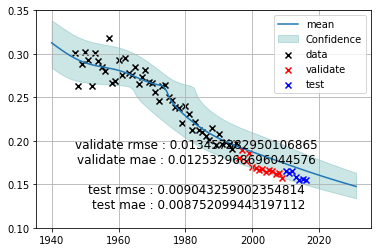

 26%|██▌       | 336/1296 [28:28<1:45:27,  6.59s/it]

validate rmse : 0.013457382950106865 
 validate mae : 0.012532968696044576 

    test rmse : 0.009043259002354814 
 test mae : 0.008752099443197112
(('sa', 2), ('sal', 2), ('sal', 1), ('sa', 1))
params:[-1.03116066e-01  2.03193420e+02]


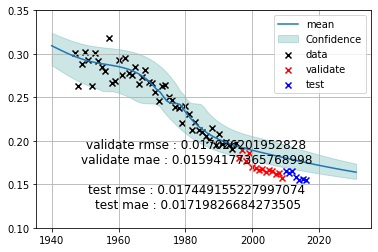

 26%|██▌       | 337/1296 [28:33<1:36:26,  6.03s/it]

validate rmse : 0.017026201952828 
 validate mae : 0.01594177365768998 

    test rmse : 0.017449155227997074 
 test mae : 0.01719826684273505
(('sa', 2), ('sal', 2), ('sal', 1), ('sa', 2))
params:[-1.17087206e-01  2.30860072e+02]


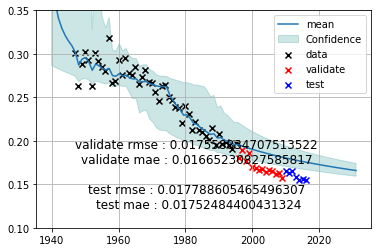

 26%|██▌       | 338/1296 [28:41<1:47:45,  6.75s/it]

validate rmse : 0.017558834707513522 
 validate mae : 0.01665230827585817 

    test rmse : 0.017788605465496307 
 test mae : 0.01752484400431324
(('sa', 2), ('sal', 2), ('sal', 1), ('sal', 1))
params:[-1.15852191e-01  2.28342043e+02]


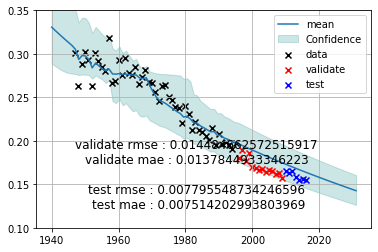

 26%|██▌       | 339/1296 [28:45<1:36:39,  6.06s/it]

validate rmse : 0.014484662572515917 
 validate mae : 0.0137844933346223 

    test rmse : 0.007795548734246596 
 test mae : 0.007514202993803969
(('sa', 2), ('sal', 2), ('sal', 1), ('sal', 2))
params:[-7.61814189e-02  1.51683637e+02]


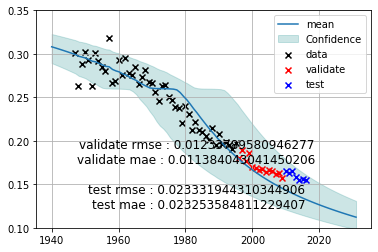

 26%|██▌       | 340/1296 [28:53<1:41:49,  6.39s/it]

validate rmse : 0.01233789580946277 
 validate mae : 0.011384043041450206 

    test rmse : 0.023331944310344906 
 test mae : 0.023253584811229407
(('sa', 2), ('sal', 2), ('sal', 1), ('box_cox', 1))
params:[-5.09283239e+00  1.00455308e+04]


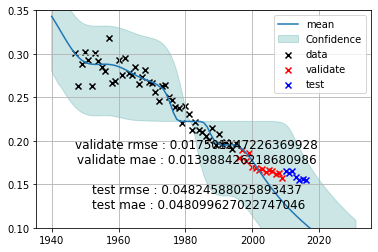

 26%|██▋       | 341/1296 [29:06<2:13:27,  8.38s/it]

validate rmse : 0.017501147226369928 
 validate mae : 0.013988426218680986 

    test rmse : 0.04824588025893437 
 test mae : 0.048099627022747046
(('sa', 2), ('sal', 2), ('sal', 1), ('box_cox', 2))
params:[-1.1403355e-01  2.2267103e+02]


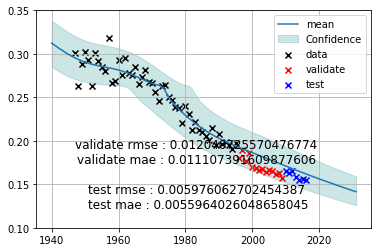

 26%|██▋       | 342/1296 [29:12<2:02:02,  7.68s/it]

validate rmse : 0.012040725570476774 
 validate mae : 0.011107391609877606 

    test rmse : 0.005976062702454387 
 test mae : 0.0055964026048658045
(('sa', 2), ('sal', 2), ('sal', 2), ('sa', 1))
params:[-1.18103398e-01  2.32828148e+02]


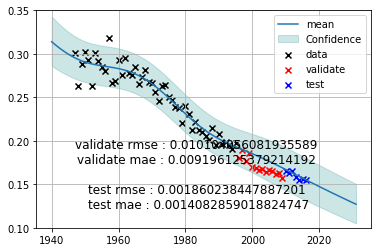

 26%|██▋       | 343/1296 [29:21<2:10:03,  8.19s/it]

validate rmse : 0.010104056081935589 
 validate mae : 0.009196125379214192 

    test rmse : 0.001860238447887201 
 test mae : 0.0014082859018824747
(('sa', 2), ('sal', 2), ('sal', 2), ('sa', 2))
params:[-1.17016536e-01  2.30547721e+02]


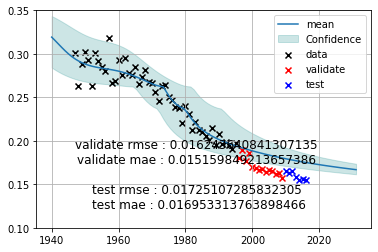

 27%|██▋       | 344/1296 [29:57<4:23:36, 16.61s/it]

validate rmse : 0.016243640841307135 
 validate mae : 0.015159849213657386 

    test rmse : 0.01725107285832305 
 test mae : 0.016953313763898466
(('sa', 2), ('sal', 2), ('sal', 2), ('sal', 1))
params:[-1.16748253e-01  2.30160126e+02]


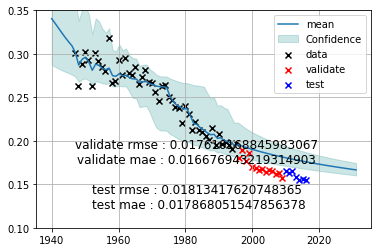

 27%|██▋       | 345/1296 [30:13<4:19:29, 16.37s/it]

validate rmse : 0.017610168845983067 
 validate mae : 0.016676943219314903 

    test rmse : 0.01813417620748365 
 test mae : 0.017868051547856378
(('sa', 2), ('sal', 2), ('sal', 2), ('sal', 2))
params:[-3.36550027e-02  6.47494615e+01]


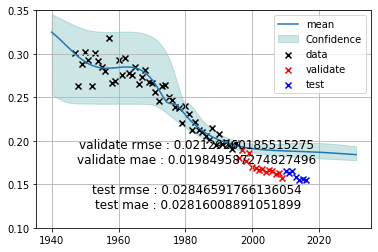

 27%|██▋       | 346/1296 [30:23<3:45:55, 14.27s/it]

validate rmse : 0.02129260185515275 
 validate mae : 0.019849587274827496 

    test rmse : 0.02846591766136054 
 test mae : 0.02816008891051899
(('sa', 2), ('sal', 2), ('sal', 2), ('box_cox', 1))
params:[-1.13787013e-01  2.23103927e+02]


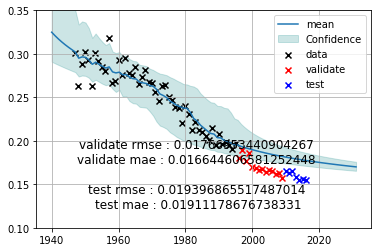

 27%|██▋       | 347/1296 [30:34<3:33:16, 13.48s/it]

validate rmse : 0.01766953440904267 
 validate mae : 0.016644606581252448 

    test rmse : 0.019396865517487014 
 test mae : 0.01911178676738331
(('sa', 2), ('sal', 2), ('sal', 2), ('box_cox', 2))
params:[-9.81470358e-03  2.43404005e+01]


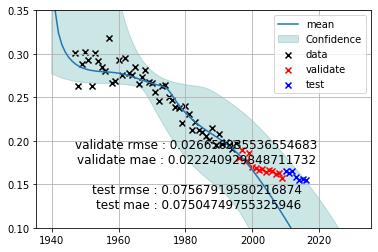

 27%|██▋       | 348/1296 [30:48<3:35:30, 13.64s/it]

validate rmse : 0.026650935536554683 
 validate mae : 0.022240929848711732 

    test rmse : 0.07567919580216874 
 test mae : 0.07504749755325946
(('sa', 2), ('sal', 2), ('box_cox', 1), ('sa', 1))
params:[-1.39500228e-01  2.73504404e+02]


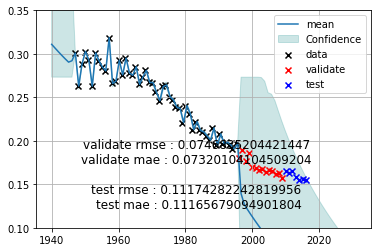

 27%|██▋       | 349/1296 [30:59<3:23:45, 12.91s/it]

validate rmse : 0.0746835204421447 
 validate mae : 0.07320104104509204 

    test rmse : 0.11174282242819956 
 test mae : 0.11165679094901804
(('sa', 2), ('sal', 2), ('box_cox', 1), ('sa', 2))
params:[ 4.83149935e-03 -7.97537361e+00]


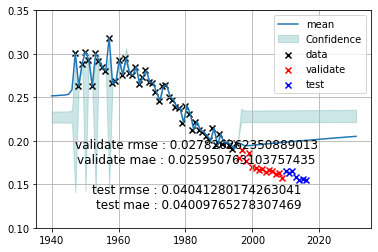

 27%|██▋       | 350/1296 [31:03<2:41:59, 10.27s/it]

validate rmse : 0.027826262350889013 
 validate mae : 0.025950763103757435 

    test rmse : 0.04041280174263041 
 test mae : 0.04009765278307469
(('sa', 2), ('sal', 2), ('box_cox', 1), ('sal', 1))
params:[-1.14159629e-01  2.25057720e+02]


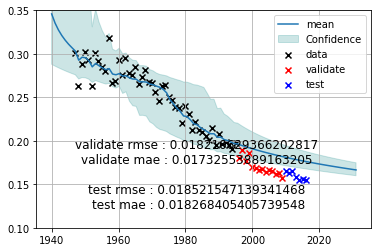

 27%|██▋       | 351/1296 [31:23<3:24:43, 13.00s/it]

validate rmse : 0.018210629366202817 
 validate mae : 0.01732553889163205 

    test rmse : 0.018521547139341468 
 test mae : 0.018268405405739548
(('sa', 2), ('sal', 2), ('box_cox', 1), ('sal', 2))
params:[ 7.69707344e-03 -1.61502293e+01]


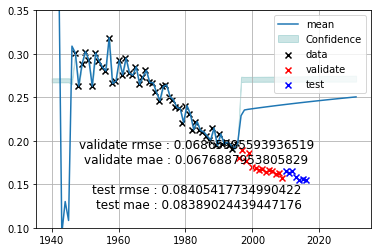

 27%|██▋       | 352/1296 [31:40<3:45:22, 14.32s/it]

validate rmse : 0.06865985593936519 
 validate mae : 0.0676887953805829 

    test rmse : 0.08405417734990422 
 test mae : 0.08389024439447176
(('sa', 2), ('sal', 2), ('box_cox', 1), ('box_cox', 1))
params:[ 3.42438981e-02 -6.52372408e+01]


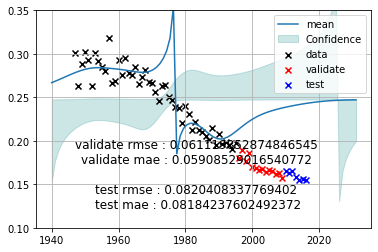

 27%|██▋       | 353/1296 [31:44<2:55:20, 11.16s/it]

validate rmse : 0.061119852874846545 
 validate mae : 0.05908529016540772 

    test rmse : 0.0820408337769402 
 test mae : 0.08184237602492372
(('sa', 2), ('sal', 2), ('box_cox', 1), ('box_cox', 2))
params:[-1.13225139e-01  2.20188611e+02]


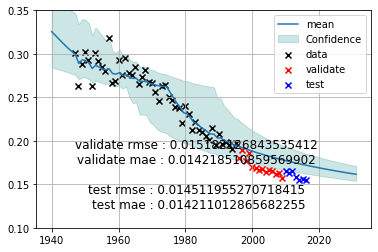

 27%|██▋       | 354/1296 [31:56<2:59:31, 11.43s/it]

validate rmse : 0.015182126843535412 
 validate mae : 0.014218510859569902 

    test rmse : 0.014511955270718415 
 test mae : 0.014211012865682255
(('sa', 2), ('sal', 2), ('box_cox', 2), ('sa', 1))
params:[ 4.33737497e-02 -8.52566290e+01]


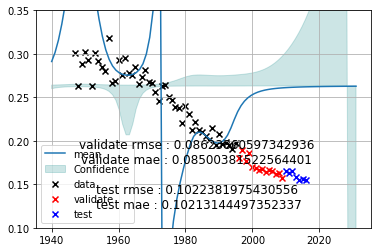

 27%|██▋       | 355/1296 [32:28<4:36:08, 17.61s/it]

validate rmse : 0.08623860597342936 
 validate mae : 0.08500381522564401 

    test rmse : 0.1022381975430556 
 test mae : 0.10213144497352337
(('sa', 2), ('sal', 2), ('box_cox', 2), ('sa', 2))
params:[ 4.79047105e-02 -9.37935649e+01]


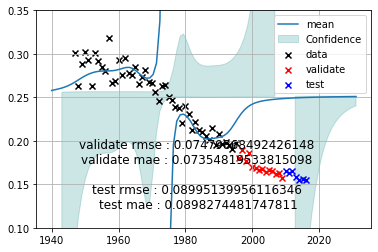

 27%|██▋       | 356/1296 [32:45<4:31:59, 17.36s/it]

validate rmse : 0.07479868492426148 
 validate mae : 0.07354819533815098 

    test rmse : 0.08995139956116346 
 test mae : 0.0898274481747811
(('sa', 2), ('sal', 2), ('box_cox', 2), ('sal', 1))
params:[-1.10885326e-01  2.18615800e+02]


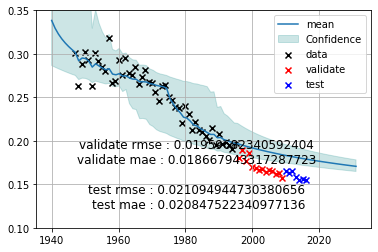

 28%|██▊       | 357/1296 [32:55<3:55:45, 15.06s/it]

validate rmse : 0.01959682340592404 
 validate mae : 0.018667943317287723 

    test rmse : 0.021094944730380656 
 test mae : 0.020847522340977136
(('sa', 2), ('sal', 2), ('box_cox', 2), ('sal', 2))
params:[-6.35416783e+02  1.26050238e+06]


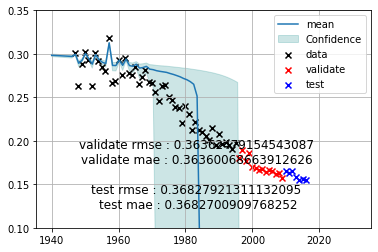

 28%|██▊       | 358/1296 [33:09<3:54:29, 15.00s/it]

validate rmse : 0.36362479154543087 
 validate mae : 0.36360068663912626 

    test rmse : 0.36827921311132095 
 test mae : 0.3682700909768252
(('sa', 2), ('sal', 2), ('box_cox', 2), ('box_cox', 1))
params:[-8.04767241e-02  1.56096278e+02]


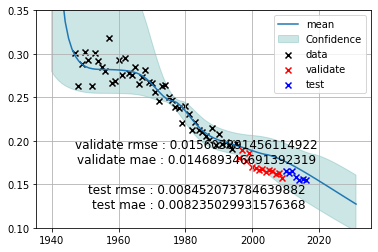

 28%|██▊       | 359/1296 [33:14<3:04:47, 11.83s/it]

validate rmse : 0.015603891456114922 
 validate mae : 0.014689346691392319 

    test rmse : 0.008452073784639882 
 test mae : 0.008235029931576368
(('sa', 2), ('sal', 2), ('box_cox', 2), ('box_cox', 2))
params:[-7.29840494e-02  1.45907264e+02]


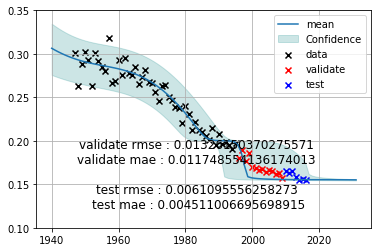

 28%|██▊       | 360/1296 [33:28<3:14:00, 12.44s/it]

validate rmse : 0.01326150370275571 
 validate mae : 0.011748554136174013 

    test rmse : 0.0061095556258273 
 test mae : 0.004511006695698915
(('sa', 2), ('box_cox', 1), ('sa', 1), ('sa', 1))
params:[-8.77007002e-02  1.71973787e+02]


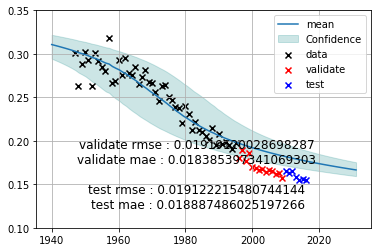

 28%|██▊       | 361/1296 [33:28<2:18:41,  8.90s/it]

validate rmse : 0.01919120028698287 
 validate mae : 0.018385397341069303 

    test rmse : 0.019122215480744144 
 test mae : 0.018887486025197266
(('sa', 2), ('box_cox', 1), ('sa', 1), ('sa', 2))
params:[-8.77005761e-02  1.71973541e+02]


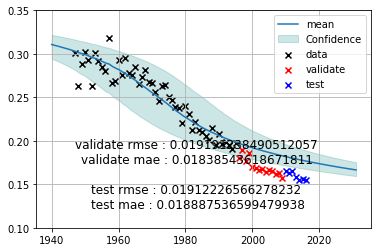

 28%|██▊       | 362/1296 [33:29<1:40:46,  6.47s/it]

validate rmse : 0.019191238490512057 
 validate mae : 0.01838543618671811 

    test rmse : 0.01912226566278232 
 test mae : 0.018887536599479938
(('sa', 2), ('box_cox', 1), ('sa', 1), ('sal', 1))
params:[-1.17304024e-01  2.31227513e+02]


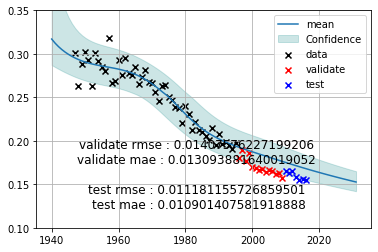

 28%|██▊       | 363/1296 [33:33<1:27:03,  5.60s/it]

validate rmse : 0.01407576227199206 
 validate mae : 0.013093881640019052 

    test rmse : 0.011181155726859501 
 test mae : 0.010901407581918888
(('sa', 2), ('box_cox', 1), ('sa', 1), ('sal', 2))
params:[-1.17774489e-01  2.32069472e+02]


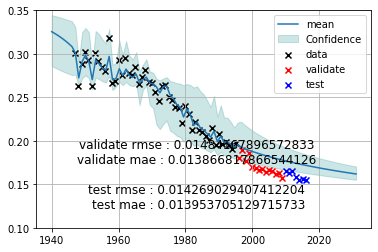

 28%|██▊       | 364/1296 [33:49<2:14:59,  8.69s/it]

validate rmse : 0.01484167896572833 
 validate mae : 0.013866817866544126 

    test rmse : 0.014269029407412204 
 test mae : 0.013953705129715733
(('sa', 2), ('box_cox', 1), ('sa', 1), ('box_cox', 1))
params:[-8.93573372e-02  1.74104578e+02]


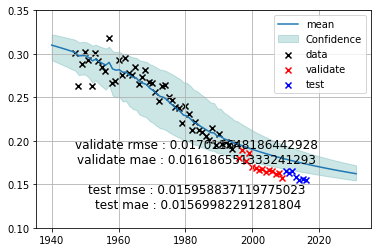

 28%|██▊       | 365/1296 [33:49<1:37:34,  6.29s/it]

validate rmse : 0.017011648186442928 
 validate mae : 0.016186551333241293 

    test rmse : 0.015958837119775023 
 test mae : 0.01569982291281804
(('sa', 2), ('box_cox', 1), ('sa', 1), ('box_cox', 2))
params:[-8.74403790e-02  1.69371119e+02]


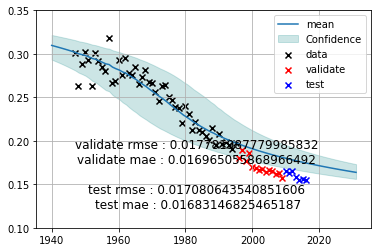

 28%|██▊       | 366/1296 [33:50<1:11:55,  4.64s/it]

validate rmse : 0.017781987779985832 
 validate mae : 0.016965055868966492 

    test rmse : 0.017080643540851606 
 test mae : 0.01683146825465187
(('sa', 2), ('box_cox', 1), ('sa', 2), ('sa', 1))
params:[-1.00760172e-01  1.97849689e+02]


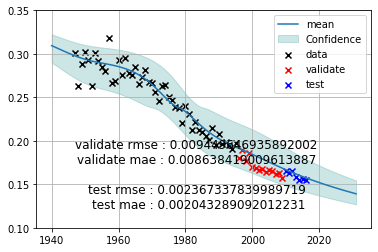

 28%|██▊       | 367/1296 [33:51<53:12,  3.44s/it]  

validate rmse : 0.009449646935892002 
 validate mae : 0.008638419009613887 

    test rmse : 0.002367337839989719 
 test mae : 0.002043289092012231
(('sa', 2), ('box_cox', 1), ('sa', 2), ('sa', 2))
params:[-8.77005933e-02  1.71973575e+02]


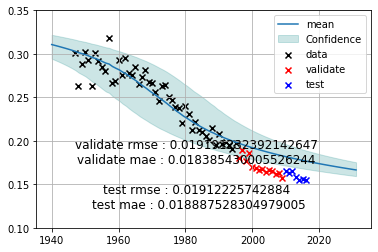

 28%|██▊       | 368/1296 [33:52<41:31,  2.69s/it]

validate rmse : 0.019191232392142647 
 validate mae : 0.018385430005526244 

    test rmse : 0.01912225742884 
 test mae : 0.018887528304979005
(('sa', 2), ('box_cox', 1), ('sa', 2), ('sal', 1))
params:[-1.17285884e-01  2.31190382e+02]


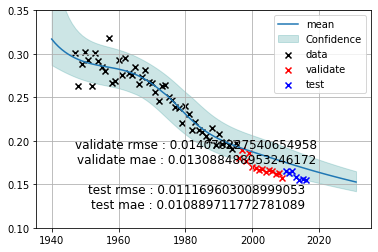

 28%|██▊       | 369/1296 [33:55<45:37,  2.95s/it]

validate rmse : 0.014070227540654958 
 validate mae : 0.013088488953246172 

    test rmse : 0.011169603008999053 
 test mae : 0.010889711772781089
(('sa', 2), ('box_cox', 1), ('sa', 2), ('sal', 2))
params:[-1.20186575e-01  2.36862302e+02]


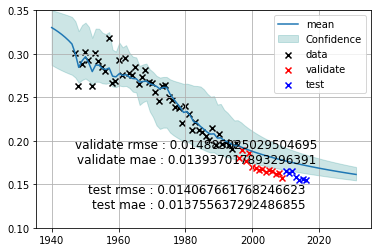

 29%|██▊       | 370/1296 [34:05<1:16:27,  4.95s/it]

validate rmse : 0.014885025029504695 
 validate mae : 0.013937017893296391 

    test rmse : 0.014067661768246623 
 test mae : 0.013755637292486855
(('sa', 2), ('box_cox', 1), ('sa', 2), ('box_cox', 1))
params:[-8.93573524e-02  1.74104608e+02]


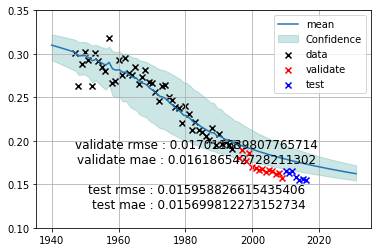

 29%|██▊       | 371/1296 [34:06<57:19,  3.72s/it]  

validate rmse : 0.017011639807765714 
 validate mae : 0.016186542728211302 

    test rmse : 0.015958826615435406 
 test mae : 0.015699812273152734
(('sa', 2), ('box_cox', 1), ('sa', 2), ('box_cox', 2))
params:[-8.74403438e-02  1.69371050e+02]


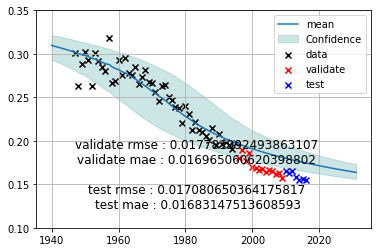

 29%|██▊       | 372/1296 [34:07<43:56,  2.85s/it]

validate rmse : 0.017781992493863107 
 validate mae : 0.016965060620398802 

    test rmse : 0.017080650364175817 
 test mae : 0.01683147513608593
(('sa', 2), ('box_cox', 1), ('sal', 1), ('sa', 1))
params:[-1.16864555e-01  2.30413082e+02]


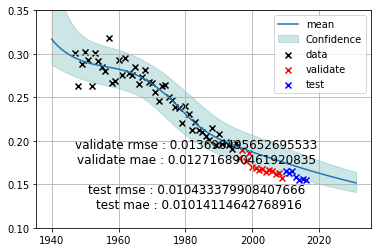

 29%|██▉       | 373/1296 [34:10<46:25,  3.02s/it]

validate rmse : 0.013690495652695533 
 validate mae : 0.012716890461920835 

    test rmse : 0.010433379908407666 
 test mae : 0.01014114642768916
(('sa', 2), ('box_cox', 1), ('sal', 1), ('sa', 2))
params:[-1.16867459e-01  2.30419354e+02]


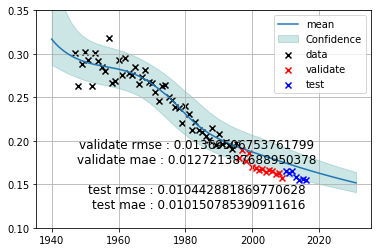

 29%|██▉       | 374/1296 [34:13<48:00,  3.12s/it]

validate rmse : 0.01369506753761799 
 validate mae : 0.012721387688950378 

    test rmse : 0.010442881869770628 
 test mae : 0.010150785390911616
(('sa', 2), ('box_cox', 1), ('sal', 1), ('sal', 1))
params:[-1.16515658e-01  2.29520521e+02]


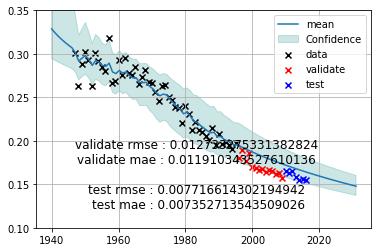

 29%|██▉       | 375/1296 [34:16<47:55,  3.12s/it]

validate rmse : 0.012733275331382824 
 validate mae : 0.011910343527610136 

    test rmse : 0.007716614302194942 
 test mae : 0.007352713543509026
(('sa', 2), ('box_cox', 1), ('sal', 1), ('sal', 2))
params:[-7.65196629e+04  1.54088828e+08]


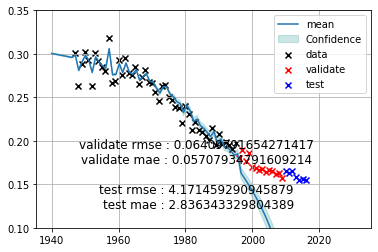

 29%|██▉       | 376/1296 [34:25<1:13:18,  4.78s/it]

validate rmse : 0.06409791654271417 
 validate mae : 0.05707934791609214 

    test rmse : 4.171459290945879 
 test mae : 2.836343329804389
(('sa', 2), ('box_cox', 1), ('sal', 1), ('box_cox', 1))
params:[-1.14704280e-01  2.25211384e+02]


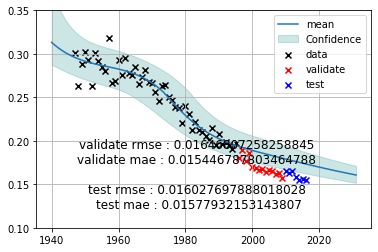

 29%|██▉       | 377/1296 [34:28<1:04:56,  4.24s/it]

validate rmse : 0.01646807258258845 
 validate mae : 0.015446787803464788 

    test rmse : 0.016027697888018028 
 test mae : 0.01577932153143807
(('sa', 2), ('box_cox', 1), ('sal', 1), ('box_cox', 2))
params:[-1.15062522e-01  2.24861653e+02]


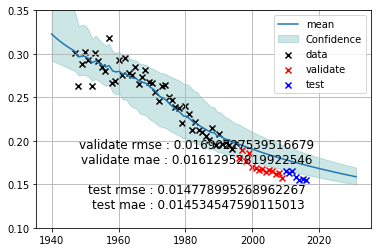

 29%|██▉       | 378/1296 [34:32<1:02:08,  4.06s/it]

validate rmse : 0.01690227539516679 
 validate mae : 0.01612952819922546 

    test rmse : 0.014778995268962267 
 test mae : 0.014534547590115013
(('sa', 2), ('box_cox', 1), ('sal', 2), ('sa', 1))
params:[-1.17230987e-01  2.31068787e+02]


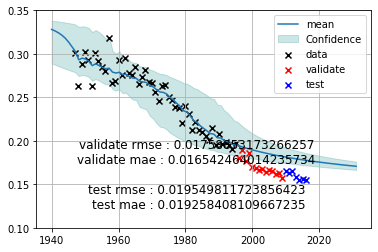

 29%|██▉       | 379/1296 [34:37<1:08:12,  4.46s/it]

validate rmse : 0.01758853173266257 
 validate mae : 0.016542464014235734 

    test rmse : 0.019549811723856423 
 test mae : 0.019258408109667235
(('sa', 2), ('box_cox', 1), ('sal', 2), ('sa', 2))
params:[-9.19049900e-02  1.80413849e+02]


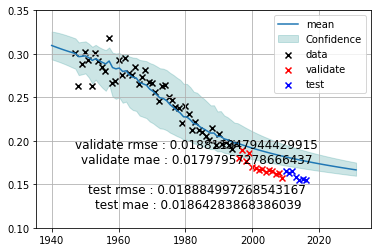

 29%|██▉       | 380/1296 [34:40<1:01:47,  4.05s/it]

validate rmse : 0.018811947944429915 
 validate mae : 0.01797957278666437 

    test rmse : 0.018884997268543167 
 test mae : 0.01864283868386039
(('sa', 2), ('box_cox', 1), ('sal', 2), ('sal', 1))
params:[-1.17160299e-01  2.30970479e+02]


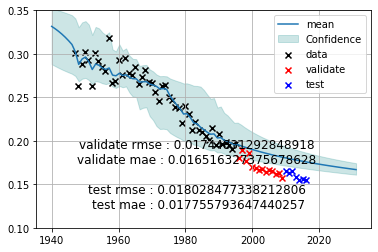

 29%|██▉       | 381/1296 [34:47<1:15:27,  4.95s/it]

validate rmse : 0.01744831292848918 
 validate mae : 0.016516327375678628 

    test rmse : 0.018028477338212806 
 test mae : 0.017755793647440257
(('sa', 2), ('box_cox', 1), ('sal', 2), ('sal', 2))
params:[-1. -1.]


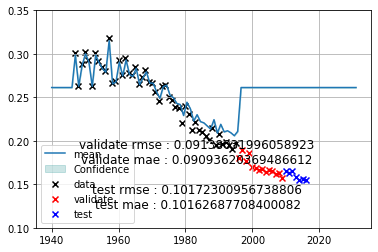

 29%|██▉       | 382/1296 [34:58<1:40:19,  6.59s/it]

validate rmse : 0.09138031996058923 
 validate mae : 0.09093620369486612 

    test rmse : 0.10172300956738806 
 test mae : 0.10162687708400082
(('sa', 2), ('box_cox', 1), ('sal', 2), ('box_cox', 1))
params:[-1.21172727e-01  2.38009246e+02]


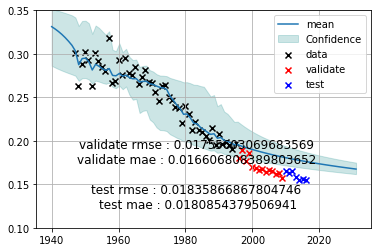

 30%|██▉       | 383/1296 [35:07<1:50:40,  7.27s/it]

validate rmse : 0.01755603069683569 
 validate mae : 0.016606808389803652 

    test rmse : 0.01835866867804746 
 test mae : 0.0180854379506941
(('sa', 2), ('box_cox', 1), ('sal', 2), ('box_cox', 2))
params:[-1.21196340e-01  2.36686171e+02]


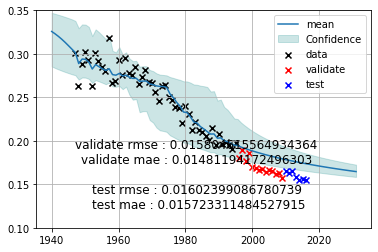

 30%|██▉       | 384/1296 [35:20<2:20:48,  9.26s/it]

validate rmse : 0.015804615564934364 
 validate mae : 0.01481194172496303 

    test rmse : 0.01602399086780739 
 test mae : 0.015723311484527915
(('sa', 2), ('box_cox', 1), ('box_cox', 1), ('sa', 1))
params:[-8.04086363e-02  1.56938259e+02]


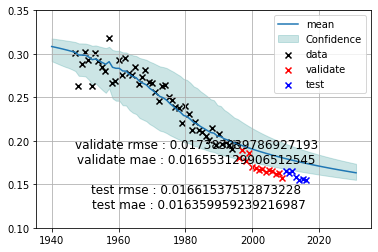

 30%|██▉       | 385/1296 [35:21<1:41:36,  6.69s/it]

validate rmse : 0.017383039786927193 
 validate mae : 0.016553129906512545 

    test rmse : 0.01661537512873228 
 test mae : 0.016359959239216987
(('sa', 2), ('box_cox', 1), ('box_cox', 1), ('sa', 2))
params:[-8.04086321e-02  1.56938251e+02]


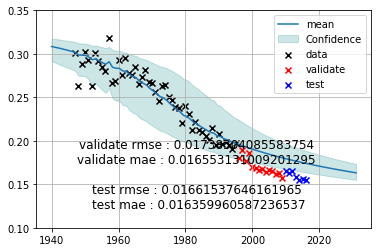

 30%|██▉       | 386/1296 [35:22<1:14:27,  4.91s/it]

validate rmse : 0.01738304085583754 
 validate mae : 0.016553131009201295 

    test rmse : 0.01661537646161965 
 test mae : 0.016359960587236537
(('sa', 2), ('box_cox', 1), ('box_cox', 1), ('sal', 1))
params:[-1.13023212e-01  2.22867768e+02]


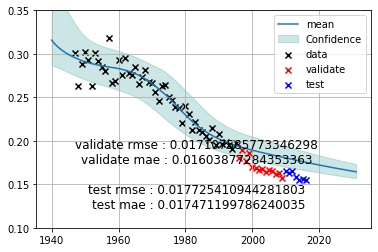

 30%|██▉       | 387/1296 [35:23<56:11,  3.71s/it]  

validate rmse : 0.017107585773346298 
 validate mae : 0.01603877284353363 

    test rmse : 0.017725410944281803 
 test mae : 0.017471199786240035
(('sa', 2), ('box_cox', 1), ('box_cox', 1), ('sal', 2))
params:[-5.37150023e+09  1.05348072e+13]


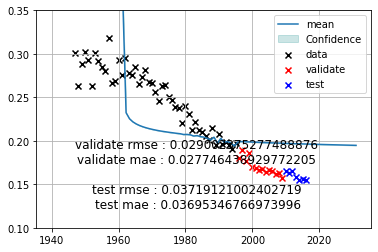

 30%|██▉       | 388/1296 [35:25<50:12,  3.32s/it]

validate rmse : 0.029002375277488876 
 validate mae : 0.027746438929772205 

    test rmse : 0.03719121002402719 
 test mae : 0.03695346766973996
(('sa', 2), ('box_cox', 1), ('box_cox', 1), ('box_cox', 1))
params:[-8.91447726e-02  1.72231281e+02]


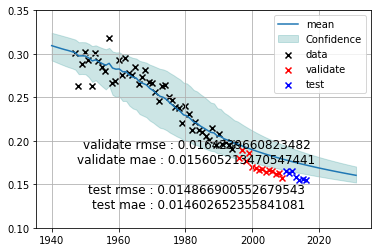

 30%|███       | 389/1296 [35:26<38:23,  2.54s/it]

validate rmse : 0.0164239660823482 
 validate mae : 0.015605213470547441 

    test rmse : 0.014866900552679543 
 test mae : 0.014602652355841081
(('sa', 2), ('box_cox', 1), ('box_cox', 1), ('box_cox', 2))
params:[-7.56513613e-02  1.44605194e+02]


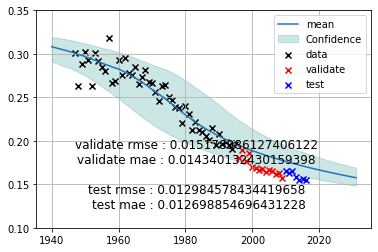

 30%|███       | 390/1296 [35:27<29:43,  1.97s/it]

validate rmse : 0.015178986127406122 
 validate mae : 0.014340132430159398 

    test rmse : 0.012984578434419658 
 test mae : 0.012698854696431228
(('sa', 2), ('box_cox', 1), ('box_cox', 2), ('sa', 1))
params:[-7.43963596e-02  1.44895147e+02]


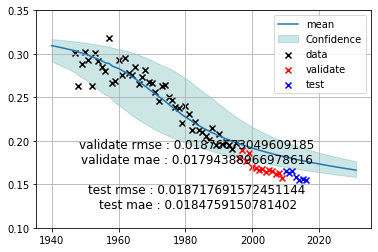

 30%|███       | 391/1296 [35:27<24:07,  1.60s/it]

validate rmse : 0.01876673049609185 
 validate mae : 0.01794388966978616 

    test rmse : 0.018717691572451144 
 test mae : 0.0184759150781402
(('sa', 2), ('box_cox', 1), ('box_cox', 2), ('sa', 2))
params:[-7.43964813e-02  1.44895390e+02]


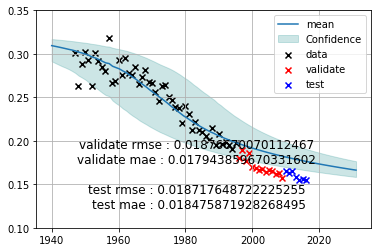

 30%|███       | 392/1296 [35:28<20:15,  1.34s/it]

validate rmse : 0.01876670070112467 
 validate mae : 0.017943859670331602 

    test rmse : 0.018717648722225255 
 test mae : 0.018475871928268495
(('sa', 2), ('box_cox', 1), ('box_cox', 2), ('sal', 1))
params:[-1.08612513e-01  2.14280904e+02]


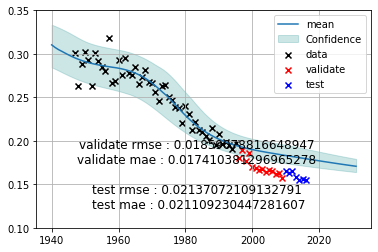

 30%|███       | 393/1296 [35:29<18:41,  1.24s/it]

validate rmse : 0.01859078816648947 
 validate mae : 0.017410381296965278 

    test rmse : 0.02137072109132791 
 test mae : 0.021109230447281607
(('sa', 2), ('box_cox', 1), ('box_cox', 2), ('sal', 2))
params:[-1.83127178e+04  3.63550016e+07]


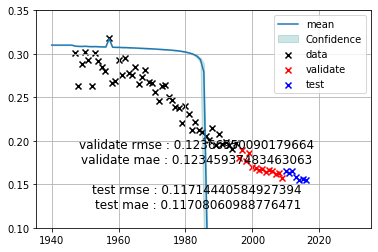

 30%|███       | 394/1296 [35:32<24:48,  1.65s/it]

validate rmse : 0.12366950090179664 
 validate mae : 0.12345937483463063 

    test rmse : 0.11714440584927394 
 test mae : 0.11708060988776471
(('sa', 2), ('box_cox', 1), ('box_cox', 2), ('box_cox', 1))
params:[-7.34496044e-02  1.40259281e+02]


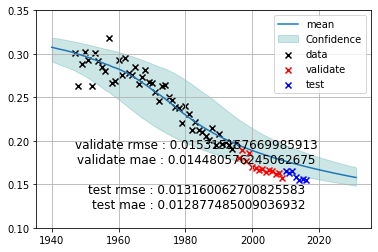

 30%|███       | 395/1296 [35:32<20:41,  1.38s/it]

validate rmse : 0.015315157669985913 
 validate mae : 0.014480576245062675 

    test rmse : 0.013160062700825583 
 test mae : 0.012877485009036932
(('sa', 2), ('box_cox', 1), ('box_cox', 2), ('box_cox', 2))
params:[-5.88450191e-02  1.10617469e+02]


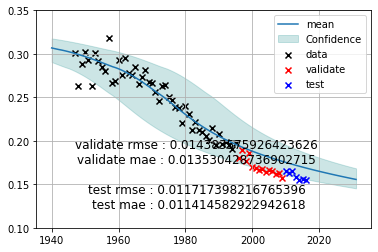

 31%|███       | 396/1296 [35:33<17:35,  1.17s/it]

validate rmse : 0.014383575926423626 
 validate mae : 0.013530428736902715 

    test rmse : 0.011717398216765396 
 test mae : 0.011414582922942618
(('sa', 2), ('box_cox', 2), ('sa', 1), ('sa', 1))
params:[-7.75547358e-02  1.51300283e+02]


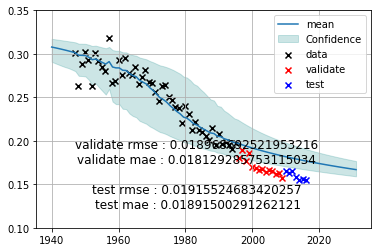

 31%|███       | 397/1296 [35:34<15:44,  1.05s/it]

validate rmse : 0.018968692521953216 
 validate mae : 0.018129285753115034 

    test rmse : 0.01915524683420257 
 test mae : 0.01891500291262121
(('sa', 2), ('box_cox', 2), ('sa', 1), ('sa', 2))
params:[-7.75550242e-02  1.51300861e+02]


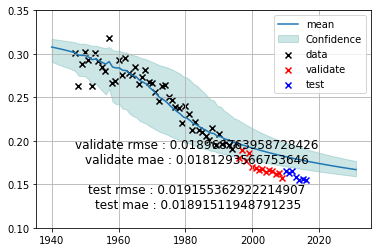

 31%|███       | 398/1296 [35:35<14:42,  1.02it/s]

validate rmse : 0.018968763958728426 
 validate mae : 0.0181293566753646 

    test rmse : 0.019155362922214907 
 test mae : 0.01891511948791235
(('sa', 2), ('box_cox', 2), ('sa', 1), ('sal', 1))
params:[-1.09346367e-01  2.15650348e+02]


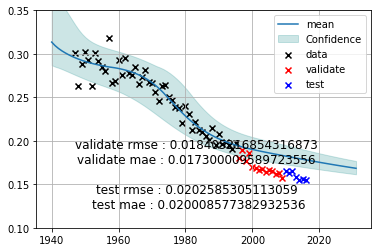

 31%|███       | 399/1296 [35:36<14:47,  1.01it/s]

validate rmse : 0.018405216854316873 
 validate mae : 0.017300009589723556 

    test rmse : 0.0202585305113059 
 test mae : 0.020008577382932536
(('sa', 2), ('box_cox', 2), ('sa', 1), ('sal', 2))
params:[-1.18154192e-01  2.32893557e+02]


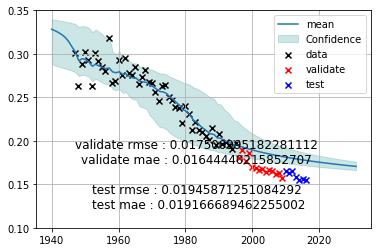

 31%|███       | 400/1296 [35:40<30:55,  2.07s/it]

validate rmse : 0.017500995182281112 
 validate mae : 0.01644440215852707 

    test rmse : 0.01945871251084292 
 test mae : 0.019166689462255002
(('sa', 2), ('box_cox', 2), ('sa', 1), ('box_cox', 1))
params:[-7.93497140e-02  1.53923617e+02]


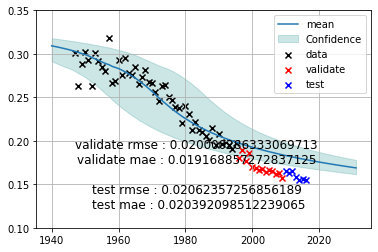

 31%|███       | 401/1296 [35:41<24:46,  1.66s/it]

validate rmse : 0.020000286333069713 
 validate mae : 0.019168857272837125 

    test rmse : 0.02062357256856189 
 test mae : 0.020392098512239065
(('sa', 2), ('box_cox', 2), ('sa', 1), ('box_cox', 2))
params:[-7.92975641e-02  1.52794040e+02]


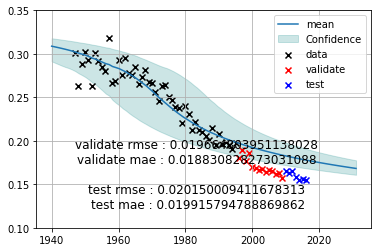

 31%|███       | 402/1296 [35:42<20:47,  1.40s/it]

validate rmse : 0.019664803951138028 
 validate mae : 0.018830828273031088 

    test rmse : 0.020150009411678313 
 test mae : 0.019915794788869862
(('sa', 2), ('box_cox', 2), ('sa', 2), ('sa', 1))
params:[-7.75550301e-02  1.51300874e+02]


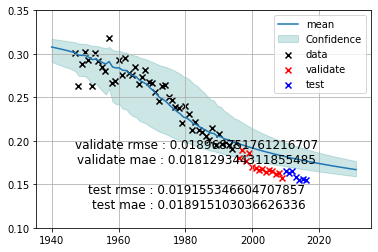

 31%|███       | 403/1296 [35:43<18:15,  1.23s/it]

validate rmse : 0.018968751761216707 
 validate mae : 0.018129344311855485 

    test rmse : 0.019155346604707857 
 test mae : 0.018915103036626336
(('sa', 2), ('box_cox', 2), ('sa', 2), ('sa', 2))
params:[-7.75550676e-02  1.51300946e+02]


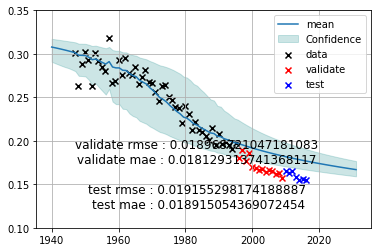

 31%|███       | 404/1296 [35:43<16:33,  1.11s/it]

validate rmse : 0.018968721047181083 
 validate mae : 0.018129313741368117 

    test rmse : 0.019155298174188887 
 test mae : 0.018915054369072454
(('sa', 2), ('box_cox', 2), ('sa', 2), ('sal', 1))
params:[-1.09346494e-01  2.15650608e+02]


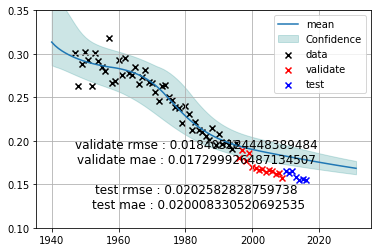

 31%|███▏      | 405/1296 [35:44<16:02,  1.08s/it]

validate rmse : 0.018405124448389484 
 validate mae : 0.017299926487134507 

    test rmse : 0.0202582828759738 
 test mae : 0.020008330520692535
(('sa', 2), ('box_cox', 2), ('sa', 2), ('sal', 2))
params:[-1.18323664e-01  2.33226576e+02]


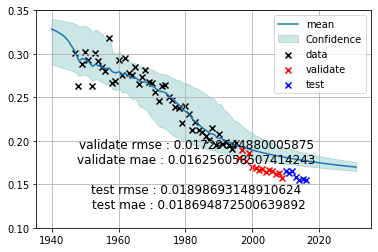

 31%|███▏      | 406/1296 [35:49<31:00,  2.09s/it]

validate rmse : 0.01729644880005875 
 validate mae : 0.016256058507414243 

    test rmse : 0.01898693148910624 
 test mae : 0.018694872500639892
(('sa', 2), ('box_cox', 2), ('sa', 2), ('box_cox', 1))
params:[-7.93501357e-02  1.53924441e+02]


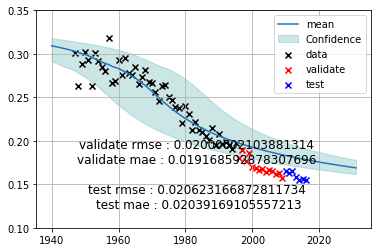

 31%|███▏      | 407/1296 [35:50<25:01,  1.69s/it]

validate rmse : 0.02000002103881314 
 validate mae : 0.019168592878307696 

    test rmse : 0.020623166872811734 
 test mae : 0.02039169105557213
(('sa', 2), ('box_cox', 2), ('sa', 2), ('box_cox', 2))
params:[-7.9297398e-02  1.5279372e+02]


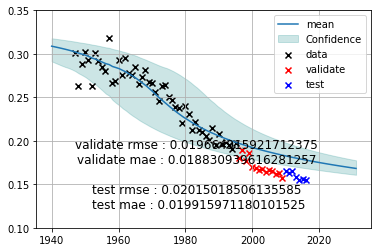

 31%|███▏      | 408/1296 [35:51<21:22,  1.44s/it]

validate rmse : 0.019664915921712375 
 validate mae : 0.018830939616281257 

    test rmse : 0.02015018506135585 
 test mae : 0.019915971180101525
(('sa', 2), ('box_cox', 2), ('sal', 1), ('sa', 1))
params:[-1.07512193e-01  2.12121746e+02]


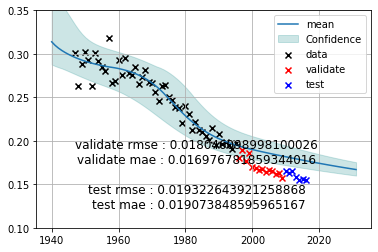

 32%|███▏      | 409/1296 [35:52<19:21,  1.31s/it]

validate rmse : 0.018046098998100026 
 validate mae : 0.016976781859344016 

    test rmse : 0.019322643921258868 
 test mae : 0.019073848595965167
(('sa', 2), ('box_cox', 2), ('sal', 1), ('sa', 2))
params:[-7.75559256e-02  1.51302643e+02]


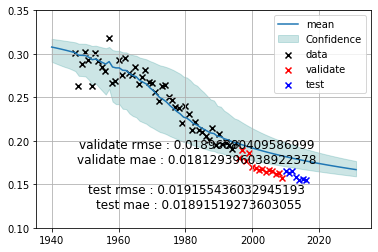

 32%|███▏      | 410/1296 [35:54<25:53,  1.75s/it]

validate rmse : 0.01896880409586999 
 validate mae : 0.018129396038922378 

    test rmse : 0.019155436032945193 
 test mae : 0.01891519273603055
(('sa', 2), ('box_cox', 2), ('sal', 1), ('sal', 1))
params:[-1.16038788e-01  2.28623865e+02]


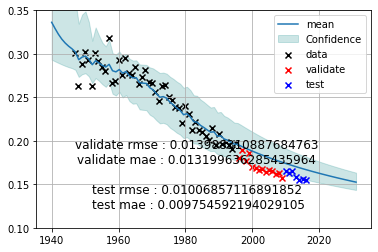

 32%|███▏      | 411/1296 [35:55<23:09,  1.57s/it]

validate rmse : 0.013988310887684763 
 validate mae : 0.013199636285435964 

    test rmse : 0.01006857116891852 
 test mae : 0.009754592194029105
(('sa', 2), ('box_cox', 2), ('sal', 1), ('sal', 2))
params:[-1.16228297e-01  2.28972385e+02]


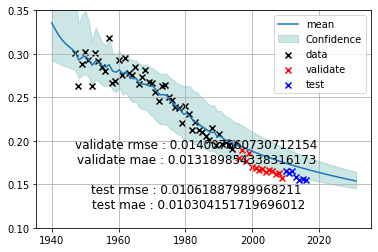

 32%|███▏      | 412/1296 [36:00<35:08,  2.39s/it]

validate rmse : 0.014007660730712154 
 validate mae : 0.013189854338316173 

    test rmse : 0.01061887989968211 
 test mae : 0.010304151719696012
(('sa', 2), ('box_cox', 2), ('sal', 1), ('box_cox', 1))
params:[-1.10116948e-01  2.16148637e+02]


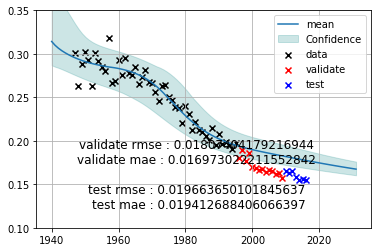

 32%|███▏      | 413/1296 [36:01<29:23,  2.00s/it]

validate rmse : 0.01807404179216944 
 validate mae : 0.016973022211552842 

    test rmse : 0.019663650101845637 
 test mae : 0.019412688406066397
(('sa', 2), ('box_cox', 2), ('sal', 1), ('box_cox', 2))
params:[-1.09611554e-01  2.14061809e+02]


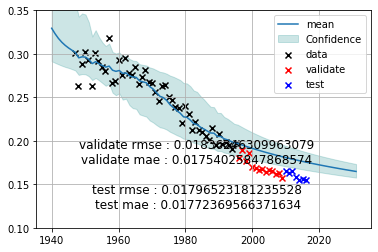

 32%|███▏      | 414/1296 [36:02<25:02,  1.70s/it]

validate rmse : 0.01836246309963079 
 validate mae : 0.01754025847868574 

    test rmse : 0.01796523181235528 
 test mae : 0.01772369566371634
(('sa', 2), ('box_cox', 2), ('sal', 2), ('sa', 1))
params:[-1.18033361e-01  2.32654697e+02]


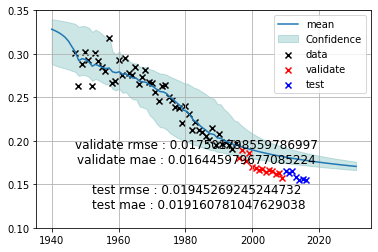

 32%|███▏      | 415/1296 [36:06<34:40,  2.36s/it]

validate rmse : 0.017501798559786997 
 validate mae : 0.016445979677085224 

    test rmse : 0.01945269245244732 
 test mae : 0.019160781047629038
(('sa', 2), ('box_cox', 2), ('sal', 2), ('sa', 2))
params:[-1.18145487e-01  2.32875105e+02]


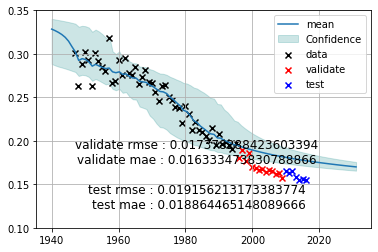

 32%|███▏      | 416/1296 [36:08<34:56,  2.38s/it]

validate rmse : 0.017378288423603394 
 validate mae : 0.016333473830788866 

    test rmse : 0.019156213173383774 
 test mae : 0.018864465148089666
(('sa', 2), ('box_cox', 2), ('sal', 2), ('sal', 1))
params:[-1.10679588e-01  2.18240237e+02]


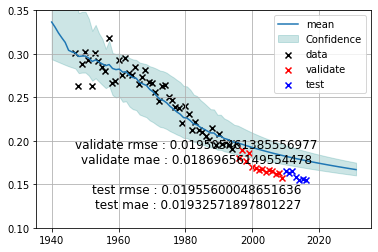

 32%|███▏      | 417/1296 [36:12<41:55,  2.86s/it]

validate rmse : 0.019505461385556977 
 validate mae : 0.01869656149554478 

    test rmse : 0.01955600048651636 
 test mae : 0.01932571897801227
(('sa', 2), ('box_cox', 2), ('sal', 2), ('sal', 2))
params:[-1.17509773e-01  2.31638016e+02]


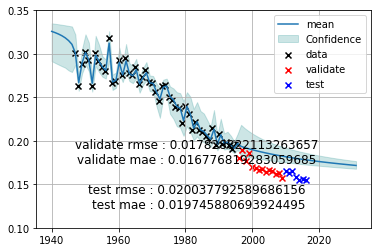

 32%|███▏      | 418/1296 [36:27<1:33:43,  6.40s/it]

validate rmse : 0.017828822113263657 
 validate mae : 0.016776819283059685 

    test rmse : 0.020037792589686156 
 test mae : 0.019745880693924495
(('sa', 2), ('box_cox', 2), ('sal', 2), ('box_cox', 1))
params:[-1.16029026e-01  2.27832843e+02]


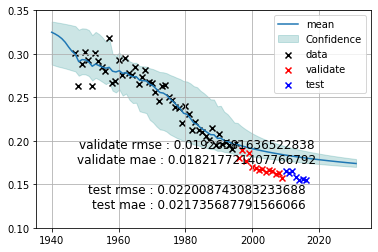

 32%|███▏      | 419/1296 [36:32<1:27:57,  6.02s/it]

validate rmse : 0.01926581636522838 
 validate mae : 0.018217721407766792 

    test rmse : 0.022008743083233688 
 test mae : 0.021735687791566066
(('sa', 2), ('box_cox', 2), ('sal', 2), ('box_cox', 2))
params:[-1.15974326e-01  2.26726790e+02]


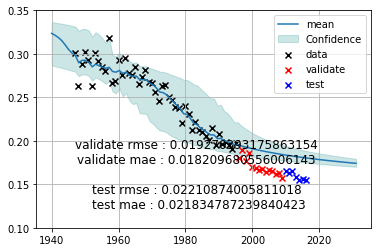

 32%|███▏      | 420/1296 [36:37<1:23:27,  5.72s/it]

validate rmse : 0.019270393175863154 
 validate mae : 0.018209680556006143 

    test rmse : 0.02210874005811018 
 test mae : 0.021834787239840423
(('sa', 2), ('box_cox', 2), ('box_cox', 1), ('sa', 1))
params:[-7.17833604e-02  1.39682864e+02]


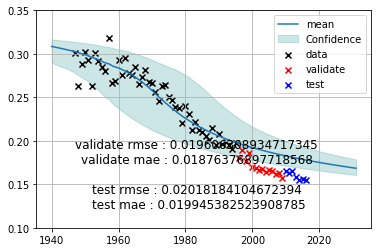

 32%|███▏      | 421/1296 [36:38<1:01:56,  4.25s/it]

validate rmse : 0.019606308934717345 
 validate mae : 0.01876376897718568 

    test rmse : 0.02018184104672394 
 test mae : 0.019945382523908785
(('sa', 2), ('box_cox', 2), ('box_cox', 1), ('sa', 2))
params:[-7.17834905e-02  1.39683123e+02]


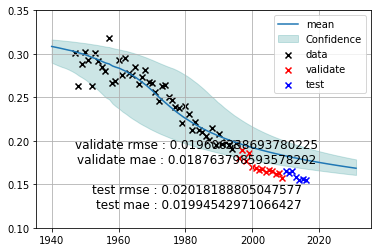

 33%|███▎      | 422/1296 [36:39<46:53,  3.22s/it]  

validate rmse : 0.019606338693780225 
 validate mae : 0.018763798593578202 

    test rmse : 0.02018188805047577 
 test mae : 0.01994542971066427
(('sa', 2), ('box_cox', 2), ('box_cox', 1), ('sal', 1))
params:[-1.05535664e-01  2.08257399e+02]


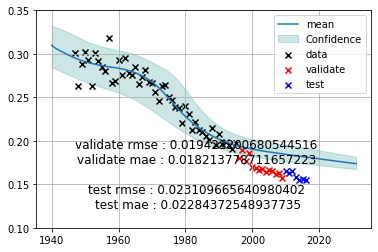

 33%|███▎      | 423/1296 [36:40<36:51,  2.53s/it]

validate rmse : 0.019421200680544516 
 validate mae : 0.018213778711657223 

    test rmse : 0.023109665640980402 
 test mae : 0.02284372548937735
(('sa', 2), ('box_cox', 2), ('box_cox', 1), ('sal', 2))
params:[-1.19040510e+07  2.33433151e+10]


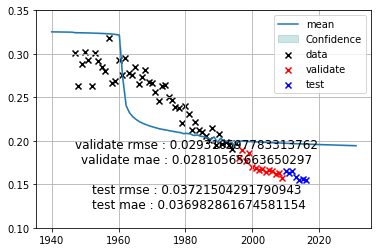

 33%|███▎      | 424/1296 [36:43<41:22,  2.85s/it]

validate rmse : 0.029310597783313762 
 validate mae : 0.02810565663650297 

    test rmse : 0.03721504291790943 
 test mae : 0.036982861674581154
(('sa', 2), ('box_cox', 2), ('box_cox', 1), ('box_cox', 1))
params:[-7.40150618e-02  1.41429698e+02]


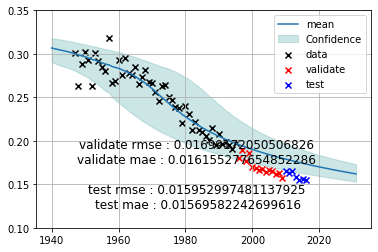

 33%|███▎      | 425/1296 [36:44<32:23,  2.23s/it]

validate rmse : 0.01699172050506826 
 validate mae : 0.016155277654852286 

    test rmse : 0.015952997481137925 
 test mae : 0.01569582242699616
(('sa', 2), ('box_cox', 2), ('box_cox', 1), ('box_cox', 2))
params:[-5.95215394e-02  1.11993604e+02]


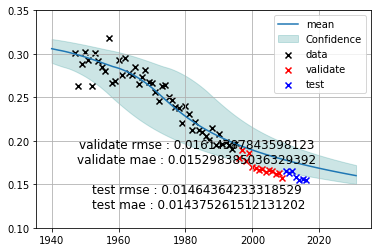

 33%|███▎      | 426/1296 [36:45<25:45,  1.78s/it]

validate rmse : 0.01614387843598123 
 validate mae : 0.015298385036329392 

    test rmse : 0.01464364233318529 
 test mae : 0.014375261512131202
(('sa', 2), ('box_cox', 2), ('box_cox', 2), ('sa', 1))
params:[-7.03791607e-02  1.36968214e+02]


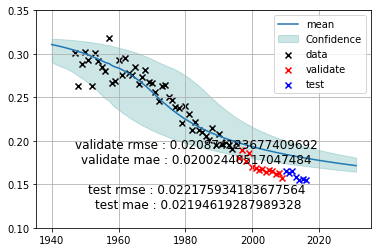

 33%|███▎      | 427/1296 [36:46<22:06,  1.53s/it]

validate rmse : 0.020874123677409692 
 validate mae : 0.02002440517047484 

    test rmse : 0.022175934183677564 
 test mae : 0.02194619287989328
(('sa', 2), ('box_cox', 2), ('box_cox', 2), ('sa', 2))
params:[-7.03794746e-02  1.36968845e+02]


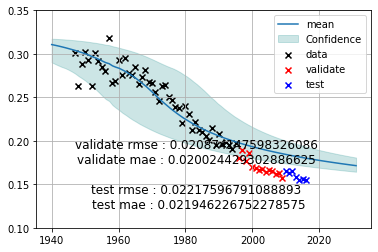

 33%|███▎      | 428/1296 [36:46<19:21,  1.34s/it]

validate rmse : 0.020874147598326086 
 validate mae : 0.020024429302886625 

    test rmse : 0.02217596791088893 
 test mae : 0.021946226752278575
(('sa', 2), ('box_cox', 2), ('box_cox', 2), ('sal', 1))
params:[-1.03296029e-01  2.03853199e+02]


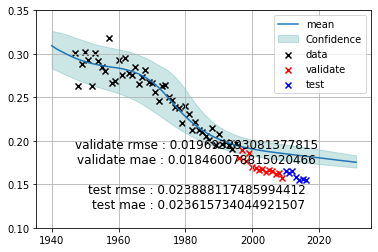

 33%|███▎      | 429/1296 [36:48<18:40,  1.29s/it]

validate rmse : 0.019693293081377815 
 validate mae : 0.018460078815020466 

    test rmse : 0.023888117485994412 
 test mae : 0.023615734044921507
(('sa', 2), ('box_cox', 2), ('box_cox', 2), ('sal', 2))
params:[-1.06168193e-01  2.09540921e+02]


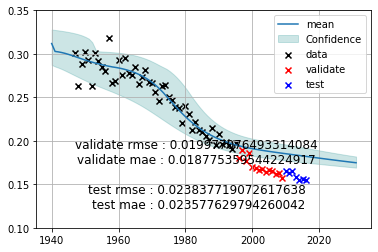

 33%|███▎      | 430/1296 [36:59<1:01:57,  4.29s/it]

validate rmse : 0.019977076493314084 
 validate mae : 0.018775359544224917 

    test rmse : 0.023837719072617638 
 test mae : 0.023577629794260042
(('sa', 2), ('box_cox', 2), ('box_cox', 2), ('box_cox', 1))
params:[-5.80694122e-02  1.09123655e+02]


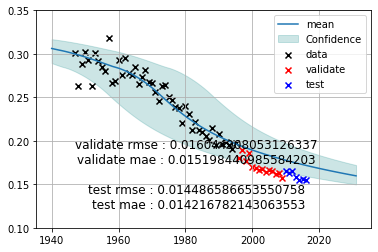

 33%|███▎      | 431/1296 [37:00<46:58,  3.26s/it]  

validate rmse : 0.016044908053126337 
 validate mae : 0.015198440985584203 

    test rmse : 0.014486586653550758 
 test mae : 0.014216782143063553
(('sa', 2), ('box_cox', 2), ('box_cox', 2), ('box_cox', 2))
params:[-4.39511633e-02  8.06276162e+01]


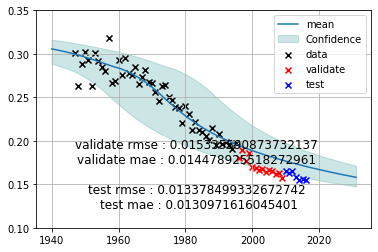

 33%|███▎      | 432/1296 [37:01<38:48,  2.69s/it]

validate rmse : 0.015335590873732137 
 validate mae : 0.014478925518272961 

    test rmse : 0.013378499332672742 
 test mae : 0.0130971616045401
(('sal', 1), ('sa', 1), ('sa', 1), ('sa', 1))
params:[-1.16807477e-01  2.30108514e+02]


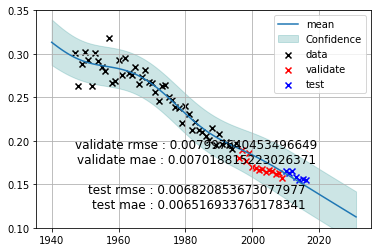

 33%|███▎      | 433/1296 [37:04<37:59,  2.64s/it]

validate rmse : 0.007997640453496649 
 validate mae : 0.007018815223026371 

    test rmse : 0.006820853673077977 
 test mae : 0.006516933763178341
(('sal', 1), ('sa', 1), ('sa', 1), ('sa', 2))
params:[-1.16923016e-01  2.30349690e+02]


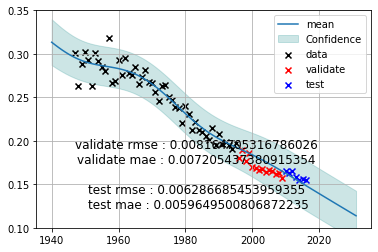

 33%|███▎      | 434/1296 [37:07<41:50,  2.91s/it]

validate rmse : 0.008164705316786026 
 validate mae : 0.007205437380915354 

    test rmse : 0.006286685453959355 
 test mae : 0.0059649500806872235
(('sal', 1), ('sa', 1), ('sa', 1), ('sal', 1))
params:[-1.17796251e-01  2.31982711e+02]


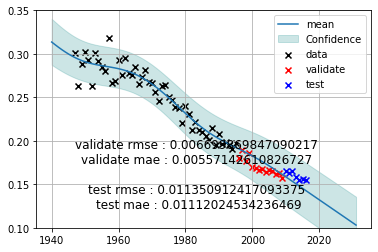

 34%|███▎      | 435/1296 [37:10<42:13,  2.94s/it]

validate rmse : 0.006699869847090217 
 validate mae : 0.00557142610826727 

    test rmse : 0.011350912417093375 
 test mae : 0.01112024534236469
(('sal', 1), ('sa', 1), ('sa', 1), ('sal', 2))
params:[-1.14564637e-01  2.25529091e+02]


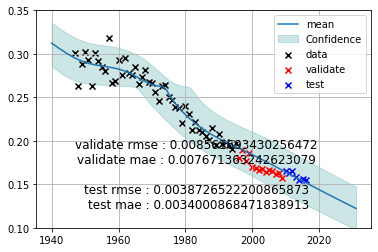

 34%|███▎      | 436/1296 [37:20<1:13:19,  5.12s/it]

validate rmse : 0.008561693430256472 
 validate mae : 0.007671363242623079 

    test rmse : 0.0038726522200865873 
 test mae : 0.0034000868471838913
(('sal', 1), ('sa', 1), ('sa', 1), ('box_cox', 1))
params:[-1.14332548e-01  2.24363929e+02]


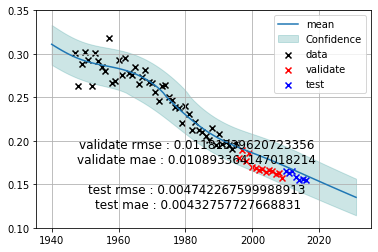

 34%|███▎      | 437/1296 [37:22<56:56,  3.98s/it]  

validate rmse : 0.01181339620723356 
 validate mae : 0.010893364147018214 

    test rmse : 0.004742267599988913 
 test mae : 0.00432757727668831
(('sal', 1), ('sa', 1), ('sa', 1), ('box_cox', 2))
params:[-1.14191175e-01  2.22979522e+02]


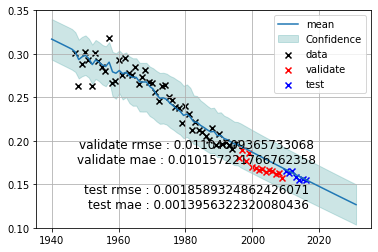

 34%|███▍      | 438/1296 [37:23<46:42,  3.27s/it]

validate rmse : 0.01104609365733068 
 validate mae : 0.010157221766762358 

    test rmse : 0.0018589324862426071 
 test mae : 0.0013956322320080436
(('sal', 1), ('sa', 1), ('sa', 2), ('sa', 1))
params:[-1.17543862e-01  2.31635100e+02]


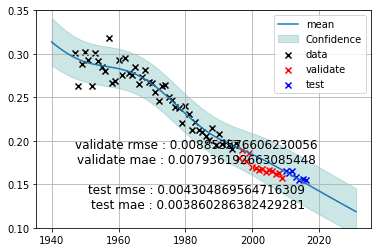

 34%|███▍      | 439/1296 [37:25<41:43,  2.92s/it]

validate rmse : 0.008853576606230056 
 validate mae : 0.007936192663085448 

    test rmse : 0.004304869564716309 
 test mae : 0.003860286382429281
(('sal', 1), ('sa', 1), ('sa', 2), ('sa', 2))
params:[-1.16960275e-01  2.30424717e+02]


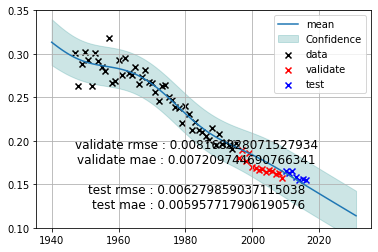

 34%|███▍      | 440/1296 [37:29<42:38,  2.99s/it]

validate rmse : 0.008168928071527934 
 validate mae : 0.007209744690766341 

    test rmse : 0.006279859037115038 
 test mae : 0.005957717906190576
(('sal', 1), ('sa', 1), ('sa', 2), ('sal', 1))
params:[-1.17744511e-01  2.31880588e+02]


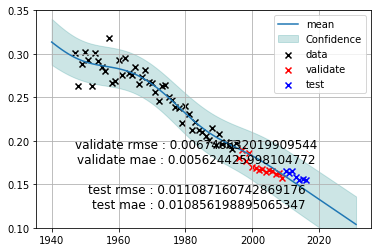

 34%|███▍      | 441/1296 [37:30<37:41,  2.64s/it]

validate rmse : 0.006746632019909544 
 validate mae : 0.005624425998104772 

    test rmse : 0.011087160742869176 
 test mae : 0.010856198895065347
(('sal', 1), ('sa', 1), ('sa', 2), ('sal', 2))
params:[-1.08375432e-01  2.13650879e+02]


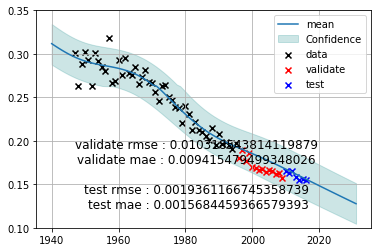

 34%|███▍      | 442/1296 [37:38<1:00:18,  4.24s/it]

validate rmse : 0.010318543814119879 
 validate mae : 0.009415479499348026 

    test rmse : 0.0019361166745358739 
 test mae : 0.0015684459366579393
(('sal', 1), ('sa', 1), ('sa', 2), ('box_cox', 1))
params:[-1.14292140e-01  2.24255155e+02]


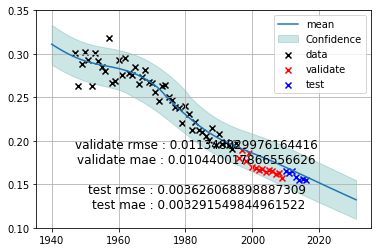

 34%|███▍      | 443/1296 [37:40<50:32,  3.56s/it]  

validate rmse : 0.011348029976164416 
 validate mae : 0.010440017866556626 

    test rmse : 0.003626068898887309 
 test mae : 0.003291549844961522
(('sal', 1), ('sa', 1), ('sa', 2), ('box_cox', 2))
params:[-1.14078000e-01  2.22747582e+02]


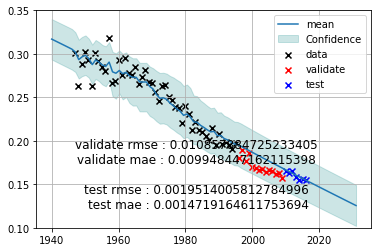

 34%|███▍      | 444/1296 [37:42<41:51,  2.95s/it]

validate rmse : 0.010857884725233405 
 validate mae : 0.009948447162115398 

    test rmse : 0.0019514005812784996 
 test mae : 0.0014719164611753694
(('sal', 1), ('sa', 1), ('sal', 1), ('sa', 1))
params:[-1.17492921e-01  2.31388130e+02]


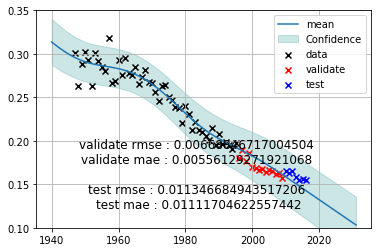

 34%|███▍      | 445/1296 [37:44<36:17,  2.56s/it]

validate rmse : 0.00668846717004504 
 validate mae : 0.00556129271921068 

    test rmse : 0.011346684943517206 
 test mae : 0.01111704622557442
(('sal', 1), ('sa', 1), ('sal', 1), ('sa', 2))
params:[-1.14365607e-01  2.25209349e+02]


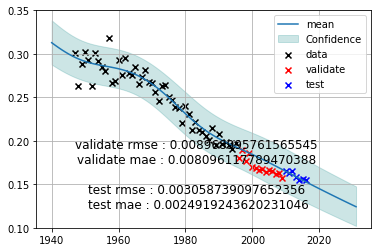

 34%|███▍      | 446/1296 [37:47<39:41,  2.80s/it]

validate rmse : 0.008968995761565545 
 validate mae : 0.008096117789470388 

    test rmse : 0.003058739097652356 
 test mae : 0.0024919243620231046
(('sal', 1), ('sa', 1), ('sal', 1), ('sal', 1))
params:[-1.18872754e-01  2.34109763e+02]


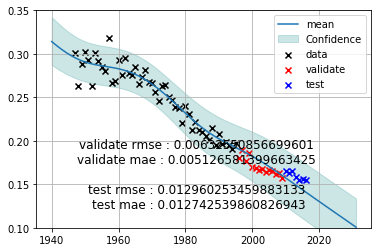

 34%|███▍      | 447/1296 [37:49<36:36,  2.59s/it]

validate rmse : 0.00632550856699601 
 validate mae : 0.005126581399663425 

    test rmse : 0.012960253459883133 
 test mae : 0.012742539860826943
(('sal', 1), ('sa', 1), ('sal', 1), ('sal', 2))
params:[-1.36035359e-01  2.67939984e+02]


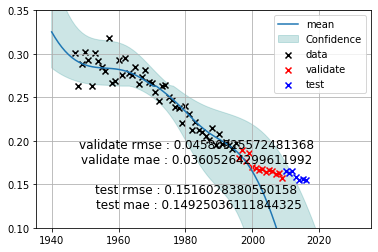

 35%|███▍      | 448/1296 [37:57<57:19,  4.06s/it]

validate rmse : 0.04580925572481368 
 validate mae : 0.03605264299611992 

    test rmse : 0.1516028380550158 
 test mae : 0.14925036111844325
(('sal', 1), ('sa', 1), ('sal', 1), ('box_cox', 1))
params:[-1.15520715e-01  2.26579201e+02]


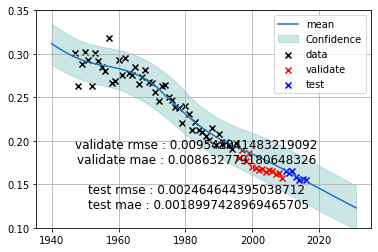

 35%|███▍      | 449/1296 [37:59<48:39,  3.45s/it]

validate rmse : 0.009541041483219092 
 validate mae : 0.008632779180648326 

    test rmse : 0.002464644395038712 
 test mae : 0.0018997428969465705
(('sal', 1), ('sa', 1), ('sal', 1), ('box_cox', 2))
params:[-1.14991580e-01  2.24454934e+02]


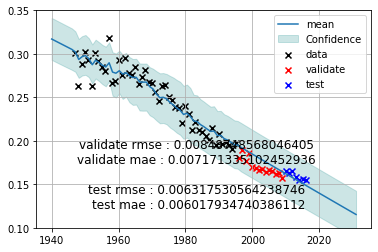

 35%|███▍      | 450/1296 [38:00<41:05,  2.91s/it]

validate rmse : 0.00848748568046405 
 validate mae : 0.007171335102452936 

    test rmse : 0.006317530564238746 
 test mae : 0.006017934740386112
(('sal', 1), ('sa', 1), ('sal', 2), ('sa', 1))
params:[-1.16749926e-01  2.29992855e+02]


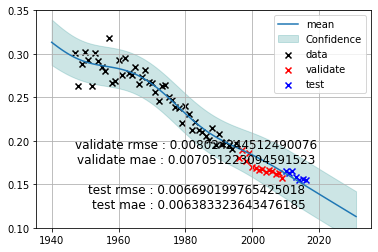

 35%|███▍      | 451/1296 [38:04<46:03,  3.27s/it]

validate rmse : 0.008024244512490076 
 validate mae : 0.007051223094591523 

    test rmse : 0.006690199765425018 
 test mae : 0.006383323643476185
(('sal', 1), ('sa', 1), ('sal', 2), ('sa', 2))
params:[-1.18225324e-01  2.32830409e+02]


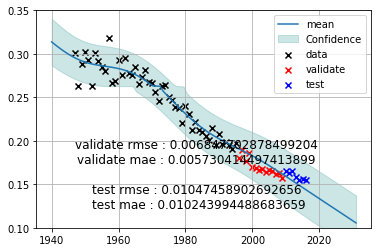

 35%|███▍      | 452/1296 [38:29<2:16:44,  9.72s/it]

validate rmse : 0.006847702878499204 
 validate mae : 0.005730414497413899 

    test rmse : 0.01047458902692656 
 test mae : 0.010243994488683659
(('sal', 1), ('sa', 1), ('sal', 2), ('sal', 1))
params:[-1.18315939e-01  2.33223490e+02]


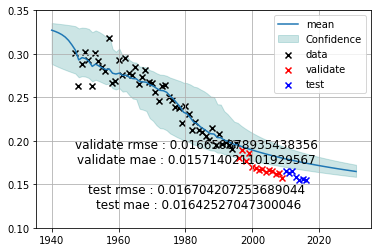

 35%|███▍      | 453/1296 [38:47<2:49:32, 12.07s/it]

validate rmse : 0.016650878935438356 
 validate mae : 0.015714021101929567 

    test rmse : 0.016704207253689044 
 test mae : 0.01642527047300046
(('sal', 1), ('sa', 1), ('sal', 2), ('sal', 2))
params:[-1.16301574e-01  2.29161856e+02]


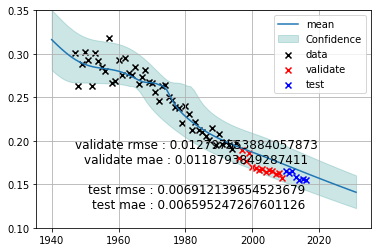

 35%|███▌      | 454/1296 [38:58<2:44:30, 11.72s/it]

validate rmse : 0.012797553884057873 
 validate mae : 0.0118793849287411 

    test rmse : 0.006912139654523679 
 test mae : 0.006595247267601126
(('sal', 1), ('sa', 1), ('sal', 2), ('box_cox', 1))
params:[-1.18970475e-01  2.33592467e+02]


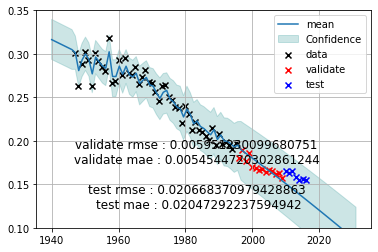

 35%|███▌      | 455/1296 [39:15<3:08:04, 13.42s/it]

validate rmse : 0.005951230099680751 
 validate mae : 0.0054544720302861244 

    test rmse : 0.020668370979428863 
 test mae : 0.02047292237594942
(('sal', 1), ('sa', 1), ('sal', 2), ('box_cox', 2))
params:[-1.27113375e-01  2.48706804e+02]


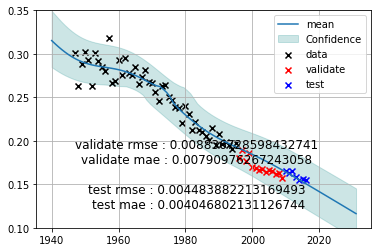

 35%|███▌      | 456/1296 [39:25<2:55:22, 12.53s/it]

validate rmse : 0.008836728598432741 
 validate mae : 0.00790976267243058 

    test rmse : 0.004483882213169493 
 test mae : 0.004046802131126744
(('sal', 1), ('sa', 1), ('box_cox', 1), ('sa', 1))
params:[-1.03329229e-01  2.02972827e+02]


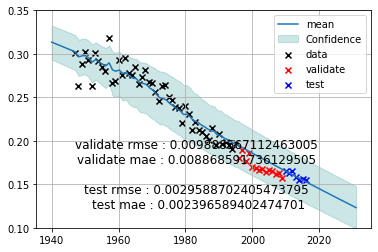

 35%|███▌      | 457/1296 [39:27<2:09:35,  9.27s/it]

validate rmse : 0.009888567112463005 
 validate mae : 0.008868591736129505 

    test rmse : 0.0029588702405473795 
 test mae : 0.002396589402474701
(('sal', 1), ('sa', 1), ('box_cox', 1), ('sa', 2))
params:[-1.03389556e-01  2.03083553e+02]


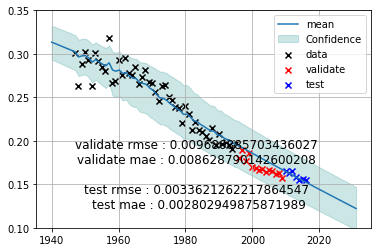

 35%|███▌      | 458/1296 [39:29<1:39:38,  7.13s/it]

validate rmse : 0.009680885703436027 
 validate mae : 0.008628790142600208 

    test rmse : 0.0033621262217864547 
 test mae : 0.002802949875871989
(('sal', 1), ('sa', 1), ('box_cox', 1), ('sal', 1))
params:[-1.24932239e-01  2.46181589e+02]


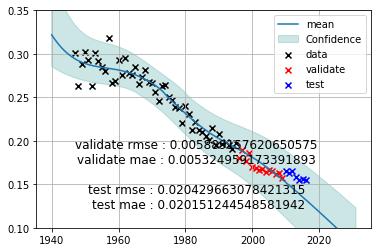

 35%|███▌      | 459/1296 [39:31<1:18:01,  5.59s/it]

validate rmse : 0.005889157620650575 
 validate mae : 0.005324959173391893 

    test rmse : 0.020429663078421315 
 test mae : 0.020151244548581942
(('sal', 1), ('sa', 1), ('box_cox', 1), ('sal', 2))
params:[-1. -1.]


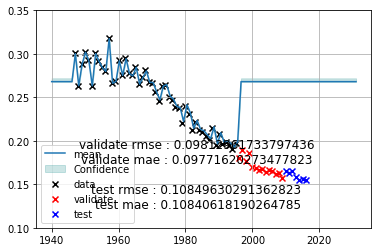

 35%|███▌      | 460/1296 [39:43<1:44:22,  7.49s/it]

validate rmse : 0.09812961733797436 
 validate mae : 0.09771620273477823 

    test rmse : 0.10849630291362823 
 test mae : 0.10840618190264785
(('sal', 1), ('sa', 1), ('box_cox', 1), ('box_cox', 1))
params:[-1.14877259e-01  2.24303319e+02]


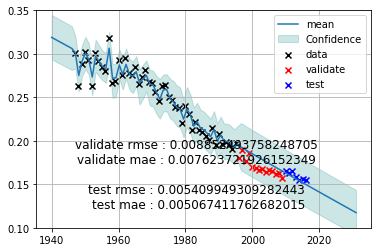

 36%|███▌      | 461/1296 [39:45<1:20:56,  5.82s/it]

validate rmse : 0.008852493758248705 
 validate mae : 0.007623721926152349 

    test rmse : 0.005409949309282443 
 test mae : 0.005067411762682015
(('sal', 1), ('sa', 1), ('box_cox', 1), ('box_cox', 2))
params:[-1.05663619e-01  2.05014770e+02]


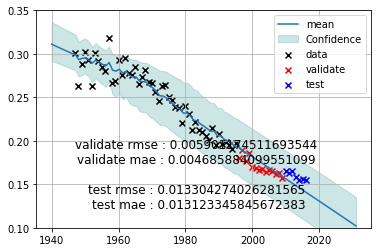

 36%|███▌      | 462/1296 [39:47<1:03:38,  4.58s/it]

validate rmse : 0.005901174511693544 
 validate mae : 0.004685884099551099 

    test rmse : 0.013304274026281565 
 test mae : 0.013123345845672383
(('sal', 1), ('sa', 1), ('box_cox', 2), ('sa', 1))
params:[-9.31598197e-02  1.82291389e+02]


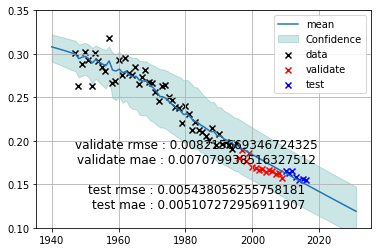

 36%|███▌      | 463/1296 [39:48<51:06,  3.68s/it]  

validate rmse : 0.008215669346724325 
 validate mae : 0.007079938516327512 

    test rmse : 0.005438056255758181 
 test mae : 0.005107272956911907
(('sal', 1), ('sa', 1), ('box_cox', 2), ('sa', 2))
params:[-9.31777669e-02  1.82330627e+02]


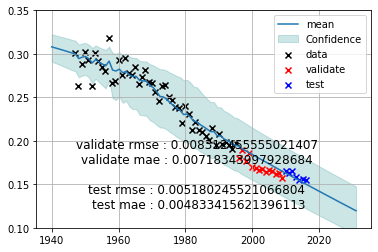

 36%|███▌      | 464/1296 [39:50<43:03,  3.11s/it]

validate rmse : 0.008312455555021407 
 validate mae : 0.00718343997928684 

    test rmse : 0.005180245521066804 
 test mae : 0.004833415621396113
(('sal', 1), ('sa', 1), ('box_cox', 2), ('sal', 1))
params:[-1.22434931e-01  2.41301550e+02]


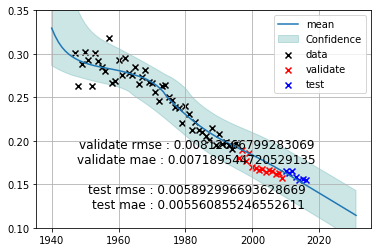

 36%|███▌      | 465/1296 [39:52<38:10,  2.76s/it]

validate rmse : 0.00812666799283069 
 validate mae : 0.007189544720529135 

    test rmse : 0.005892996693628669 
 test mae : 0.005560855246552611
(('sal', 1), ('sa', 1), ('box_cox', 2), ('sal', 2))
params:[-1.66934303e+10  3.31172894e+13]


 36%|███▌      | 465/1296 [39:59<1:11:28,  5.16s/it]


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [16]:
result = grid_search(cwgp_regression, x_train, y_train, {"c":4,"n":[1,2],"transformations":["sa","sal","box_cox"]},
                    x_val=x_val,y_val=y_val,
                    x_test=x_test,y_test=y_test
                    )